In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [2]:
Asset_PATH = "/home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/"

#### Plotting function give top density value validation set and prediction set

In [3]:
def PlotTS(X_valid,Y_valid,model,top=10):
    Predict = model.predict(X_valid)
    #columns = []
    #colNames = []
    pixelIndexDict = {}

    for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-top:][0]):
            #print(ts,listOfTopTen)
        for i in listOfTopTen:
            if (not (i in pixelIndexDict.keys())):
                pixelIndexDict[i] = {"columns":[],"colNames":[]}

            totalLenth =  Y_valid[:,ts,i].shape[0] + Y_valid.shape[1]
            pad = lambda x,ts: x if (ts<1) else pad(np.append(np.nan,x),ts-1)
            padbehind = lambda x,totLen: x if x.shape[0] >= totLen else padbehind(np.append(x,np.nan),totLen)

            pixelIndexDict[i]["columns"].append(padbehind( pad(Y_valid[:,ts,i],ts) ,totalLenth))
            pixelIndexDict[i]["colNames"].append("Y_valid: "+"Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")
            pixelIndexDict[i]["columns"].append(padbehind( pad(Predict[:,ts,i],ts) ,totalLenth))
            pixelIndexDict[i]["colNames"].append("Predict: "+"Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

    for i in pixelIndexDict.keys():
        pd.DataFrame(np.transpose(np.vstack(pixelIndexDict[i]["columns"])),
                 columns=pixelIndexDict[i]["colNames"]).plot(figsize=(12,6))


#### Timeseries windowing function

In [4]:
def window_stack(a, stepsize=1, width=52):
    n = a.shape[0]
    return np.hstack( a[i:1+n+i-width:stepsize] for i in range(0,width) )

#### Window size X

In [5]:
timesteps = 52

#### Window size Y

In [6]:
timestepY = 4 #weeks
timestepY

4

#### Load Gaussian KDE timeseries

In [7]:
density_matrix_t_series = pickle.load(open(Asset_PATH  + 'density_matrix_t_series_25x25.pickle', 'rb'))

In [8]:
density_matrix_t_series.shape

(1011, 25, 25)

In [9]:
print(np.max(density_matrix_t_series))
print(np.min(density_matrix_t_series))

7464.852345565599
2.220446049250313e-16


In [10]:
flattened_matrix_np = np.reshape(density_matrix_t_series, 
                                 (density_matrix_t_series.shape[0],
                                  density_matrix_t_series.shape[1]*density_matrix_t_series.shape[2]))
flattened_matrix_np.shape

(1011, 625)

In [11]:
stacked = window_stack(flattened_matrix_np,1,timesteps)
stacked.shape

(960, 32500)

In [12]:
stackedY = window_stack(flattened_matrix_np,1,timestepY)
stackedY.shape

(1008, 2500)

In [13]:
train, valid = (60,20)
test = 20

total_len = stacked.shape[0] - timestepY
train_index = range(0,int(train/100*total_len))

valid_index = range(train_index[-1]+1,train_index[-1] + int(valid/100*total_len))
test_index = range(valid_index[-1]+1,valid_index[-1] + int(test/100*total_len))

In [14]:
train_index, valid_index, test_index

(range(0, 573), range(573, 763), range(763, 953))

#### MinMax Scaler

In [15]:
scaler_max = np.max(stacked[train_index])
scaler_min = np.min(stacked[train_index])

#### We transform the whole train, valid, test based on scaler fitted on train

In [16]:
np.max(flattened_matrix_np)

7464.852345565599

In [17]:
scaled_flattened_matrix = (stacked - scaler_min)/(scaler_max - scaler_min)
scaled_flattened_matrix.shape

(960, 32500)

In [18]:
scaled_flattened_matrixY = (stackedY - scaler_min)/(scaler_max - scaler_min)
scaled_flattened_matrixY.shape

(1008, 2500)

In [19]:
print(np.max(scaled_flattened_matrix))
print(np.min(scaled_flattened_matrix))
print(np.max(scaled_flattened_matrixY))
print(np.min(scaled_flattened_matrixY))

1.7283221574388663
0.0
1.7283221574388663
0.0


In [20]:
print(scaled_flattened_matrix.shape)
print(scaled_flattened_matrixY.shape)

(960, 32500)
(1008, 2500)


In [21]:
reshape_stack = scaled_flattened_matrix.reshape(scaled_flattened_matrix.shape[0],timesteps,
                                int((scaled_flattened_matrix.shape[1]/timesteps)**(1/2)),
                                int((scaled_flattened_matrix.shape[1]/timesteps)**(1/2)),1)
reshape_stack.shape

(960, 52, 25, 25, 1)

In [22]:
reshape_stackY = scaled_flattened_matrixY.reshape(scaled_flattened_matrixY.shape[0],timestepY,
                                int((scaled_flattened_matrixY.shape[1]/timestepY)**(1/2)),
                                int((scaled_flattened_matrixY.shape[1]/timestepY)**(1/2)),1)
reshape_stackY.shape

(1008, 4, 25, 25, 1)

#### We reshape to (sample, timestep, inputshape)

In [23]:
scaled_flattened_matrix = reshape_stack
scaled_flattened_matrix.shape

(960, 52, 25, 25, 1)

In [24]:
scaled_flattened_matrixY = reshape_stackY
scaled_flattened_matrixY.shape

(1008, 4, 25, 25, 1)

#### We set the target to be 7 days aggregated KDE or 1 single frame forward

In [25]:
X_train = scaled_flattened_matrix[np.array(train_index)]
X_train.shape

(573, 52, 25, 25, 1)

In [26]:
Y_train = scaled_flattened_matrixY[np.array(train_index)+52] #X ends with the 52th timestep. Y will start this end timestep
#Sequential target
Y_train = Y_train.reshape(Y_train.shape[0],Y_train.shape[1], int(Y_train.shape[2]*Y_train.shape[3]*Y_train.shape[4]))
Y_train.shape
#Single time slice for Y
#Y_train = scaled_flattened_matrixY[np.array(train_index)+1][:,-1,:]
#Y_train = Y_train.reshape(Y_train.shape[0],int(Y_train.shape[1]*Y_train.shape[2]*Y_train.shape[3]))

(573, 4, 625)

In [27]:
X_valid = scaled_flattened_matrix[np.array(valid_index)]
Y_valid = scaled_flattened_matrixY[np.array(valid_index)+52]
#Sequential target
Y_valid = Y_valid.reshape(Y_valid.shape[0],Y_valid.shape[1], int(Y_valid.shape[2]*Y_valid.shape[3]*Y_valid.shape[4]))
Y_valid.shape
#Y_valid = scaled_flattened_matrix[np.array(valid_index)+1][:,-1,:]
#Y_valid = Y_valid.reshape(Y_valid.shape[0],int(Y_valid.shape[1]*Y_valid.shape[2]*Y_valid.shape[3]))

(190, 4, 625)

In [28]:
X_test = scaled_flattened_matrix[np.array(test_index)]
Y_test = scaled_flattened_matrixY[np.array(test_index)+52]
#Sequential target
Y_test = Y_test.reshape(Y_test.shape[0],Y_test.shape[1], int(Y_test.shape[2]*Y_test.shape[3]*Y_test.shape[4]))
Y_test.shape
#Y_test = scaled_flattened_matrix[np.array(test_index)+1][:,-1,:]
#Y_test = Y_test.reshape(Y_test.shape[0],int(Y_test.shape[1]*Y_test.shape[2]*Y_test.shape[3]))
#Y_test = scaled_flattened_matrix[np.array(test_index)+1][:,-1,:]
#Y_test = Y_test.reshape(Y_test.shape[0],int(Y_test.shape[1]*Y_test.shape[2]*Y_test.shape[3]))

(190, 4, 625)

In [29]:
print(X_train.shape)
print(Y_train.shape)
print(X_valid.shape)
print(Y_valid.shape)
print(X_test.shape)
print(Y_test.shape)

(573, 52, 25, 25, 1)
(573, 4, 625)
(190, 52, 25, 25, 1)
(190, 4, 625)
(190, 52, 25, 25, 1)
(190, 4, 625)


In [30]:
np.max(X_train)

1.0

In [31]:
np.max(X_valid)

1.345068053156236

In [32]:
np.max(X_test)

1.7283221574388663

In [33]:
import os, datetime
import tensorflow as tf
from tensorflow.keras import optimizers
import tensorflow.keras.layers as layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, LSTM, Bidirectional, GaussianNoise, Flatten, Dot, BatchNormalization
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Conv2D, MaxPooling2D, Concatenate, Input, LSTM, GRU, RepeatVector, TimeDistributed
from tensorflow.keras.layers import concatenate, Activation, Permute, Multiply, Lambda, Reshape, LeakyReLU, Attention
from tensorflow.keras import backend as K


In [34]:
checkpoint_filepath = Asset_PATH+'checkpoints/'
print(checkpoint_filepath)

/home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/


## Benchmark LSTM En Dec

In [35]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

lr = .001
loss='mae'
METRIC_ACCURACY = 'mae'

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))

    
timeDist = TimeDistributed(Flatten())(inputs)

LSTM_layer1 = LSTM(100, return_sequences=False)(timeDist)
#LSTM_layer2 = LSTM(1000, return_sequences=True)(LSTM_layer1)
#LSTM_layer3 = LSTM(1000, return_sequences=True)(LSTM_layer2)
TimeCompressor = RepeatVector(Y_train.shape[1])(LSTM_layer1)
LSTM_layer4 = LSTM(100, return_sequences=True)(TimeCompressor)
#Dense1 = Dense(1000, kernel_initializer='glorot_normal', activation='relu')(LSTM_layer2)
Dense2 = Dense(Y_train.shape[2])(LSTM_layer4)
outputs = Dense2

model = Model(inputs, outputs, name="Flattened_En_Dec_LTSM")
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


Model: "Flattened_En_Dec_LTSM"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 52, 25, 25, 1)]   0         
_________________________________________________________________
time_distributed (TimeDistri (None, 52, 625)           0         
_________________________________________________________________
lstm (LSTM)                  (None, 100)               290400    
_________________________________________________________________
repeat_vector (RepeatVector) (None, 4, 100)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 4, 100)            80400     
_________________________________________________________________
dense (Dense)                (None, 4, 625)            63125     
Total params: 433,925
Trainable params: 433,925
Non-trainable params: 0
_______________________________________

In [36]:
EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train],y=Y_train, 
                             validation_data=([X_valid], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_train], Y_train, verbose=2) # 5/2020 nt: use validation set
print ("train_accuracy_MAE=%s, train_loss=%s" % (valid_acc, valid_loss))

valid_loss, valid_acc = model.evaluate([X_valid], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "Flattened_En_Dec_LTSM"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 52, 25, 25, 1)]   0         
_________________________________________________________________
time_distributed (TimeDistri (None, 52, 625)           0         
_________________________________________________________________
lstm (LSTM)                  (None, 100)               290400    
_________________________________________________________________
repeat_vector (RepeatVector) (None, 4, 100)            0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 4, 100)            80400     
_________________________________________________________________
dense (Dense)                (None, 4, 625)            63125     
Total params: 433,925
Trainable params: 433,925
Non-trainable params: 0
_______________________________________

Epoch 22/500
567/573 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00022: val_loss did not improve from 0.00708
573/573 [==============================] - 0s 500us/sample - loss: 0.0049 - mae: 0.0049 - val_loss: 0.0071 - val_mae: 0.0071
Epoch 23/500
567/573 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00023: val_loss improved from 0.00708 to 0.00688, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-203813_model.hdf5
573/573 [==============================] - 0s 539us/sample - loss: 0.0049 - mae: 0.0049 - val_loss: 0.0069 - val_mae: 0.0069
Epoch 24/500
567/573 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00024: val_loss did not improve from 0.00688
573/573 [==============================] - 0s 501us/sample - loss: 0.0049 - mae: 0.0049 - val_loss: 0.0071 - val_mae: 0.0071
Epoch 25/500
546/57

Epoch 49/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00049: val_loss improved from 0.00643 to 0.00641, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-203813_model.hdf5
573/573 [==============================] - 0s 546us/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 50/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00050: val_loss did not improve from 0.00641
573/573 [==============================] - 0s 496us/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 51/500
567/573 [============================>.] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00051: val_loss did not improve from 0.00641
573/573 [==============================] - 0s 503us/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 52/500
546/57

441/573 [======================>.......] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00076: val_loss did not improve from 0.00632
573/573 [==============================] - 0s 489us/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 77/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00077: val_loss did not improve from 0.00632
573/573 [==============================] - 0s 514us/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 78/500
567/573 [============================>.] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00078: val_loss did not improve from 0.00632
573/573 [==============================] - 0s 505us/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 79/500
567/573 [============================>.] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00079: val_loss improved from 0.00632 to 0.00627, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC69

Epoch 105/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00105: val_loss did not improve from 0.00622
573/573 [==============================] - 0s 584us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 106/500
462/573 [=======================>......] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00106: val_loss did not improve from 0.00622
573/573 [==============================] - 0s 586us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 107/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00107: val_loss did not improve from 0.00622
573/573 [==============================] - 0s 523us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 108/500
567/573 [============================>.] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00108: val_loss did not improve from 0.00622
573/573 [==============================] - 0s

Epoch 133/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00133: val_loss did not improve from 0.00594
573/573 [==============================] - 0s 525us/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 134/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00134: val_loss improved from 0.00594 to 0.00592, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-203813_model.hdf5
573/573 [==============================] - 0s 564us/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 135/500
567/573 [============================>.] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00135: val_loss improved from 0.00592 to 0.00589, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpo

546/573 [===========================>..] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00158: val_loss did not improve from 0.00573
573/573 [==============================] - 0s 538us/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 159/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00159: val_loss did not improve from 0.00573
573/573 [==============================] - 0s 536us/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 160/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00160: val_loss improved from 0.00573 to 0.00565, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-203813_model.hdf5
573/573 [==============================] - 0s 578us/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 161/500
546/573 [=======

Epoch 182/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00182: val_loss did not improve from 0.00504
573/573 [==============================] - 0s 548us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 183/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00183: val_loss did not improve from 0.00504
573/573 [==============================] - 0s 599us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 184/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00184: val_loss did not improve from 0.00504
573/573 [==============================] - 0s 523us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0061 - val_mae: 0.0061
Epoch 185/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00185: val_loss did not improve from 0.00504
573/573 [==============================] - 0s

525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00212: val_loss did not improve from 0.00504
573/573 [==============================] - 0s 536us/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 213/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00213: val_loss did not improve from 0.00504
573/573 [==============================] - 0s 529us/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0054 - val_mae: 0.0054
Epoch 214/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00214: val_loss did not improve from 0.00504
573/573 [==============================] - 0s 534us/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 215/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00215: val_loss did not improve from 0.00504
573/573 [==============================] - 0s 542us/sample 

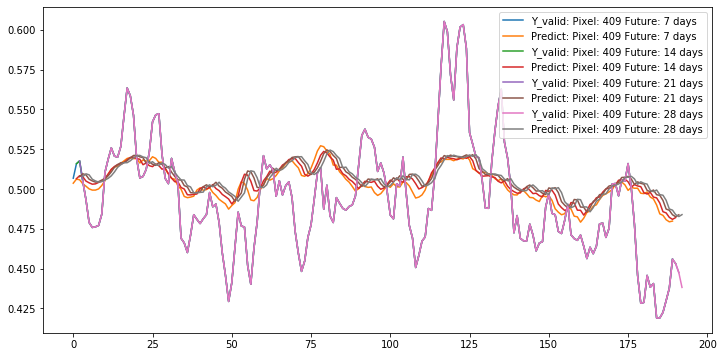

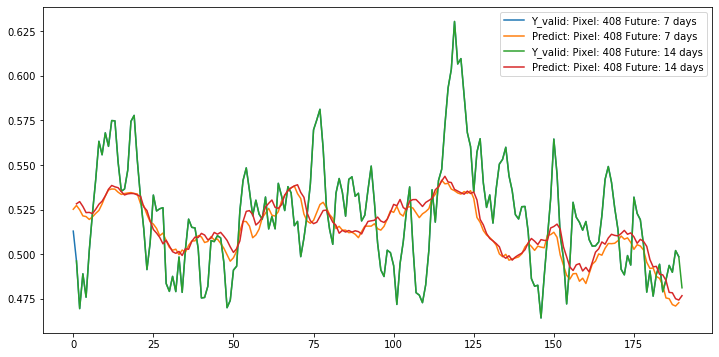

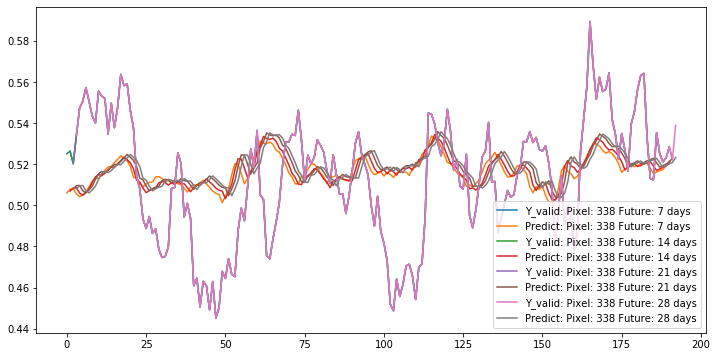

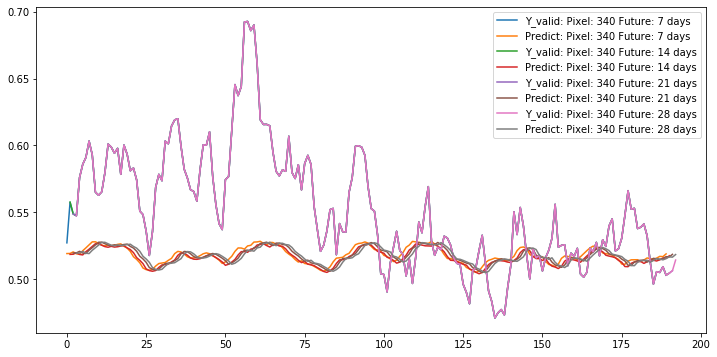

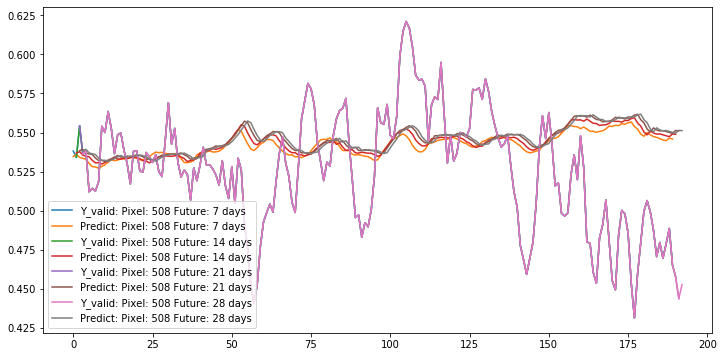

...

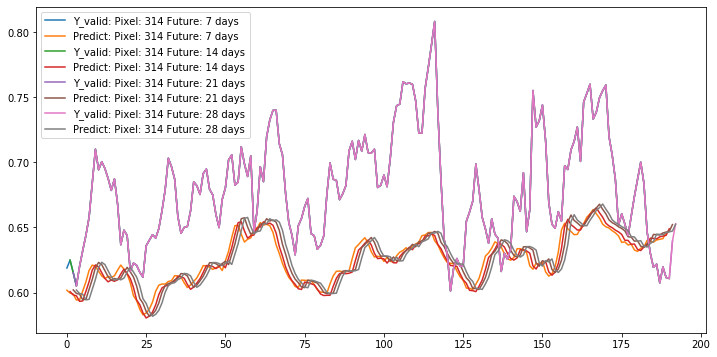

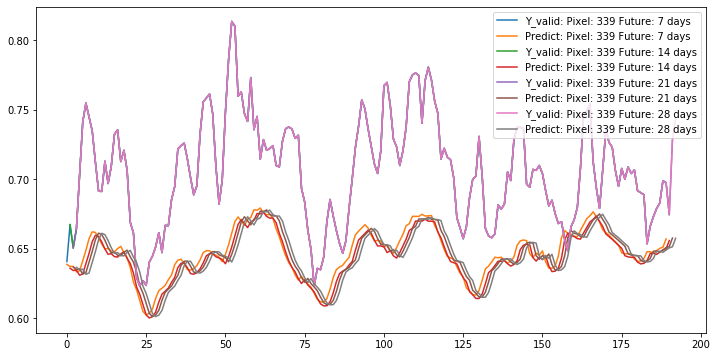

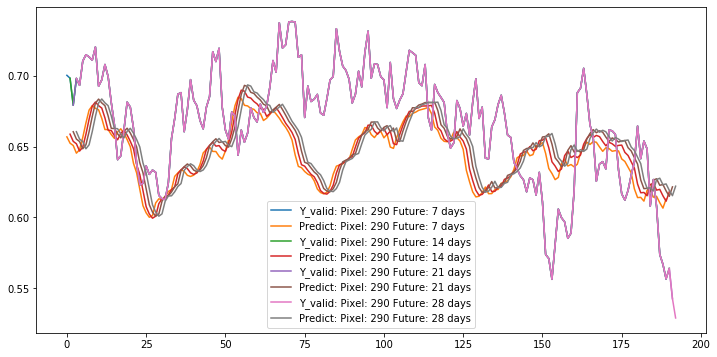

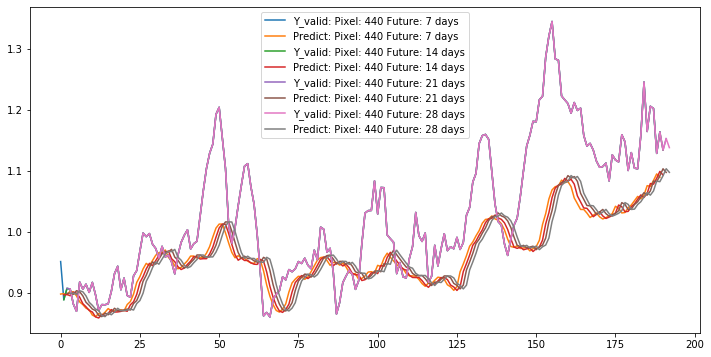

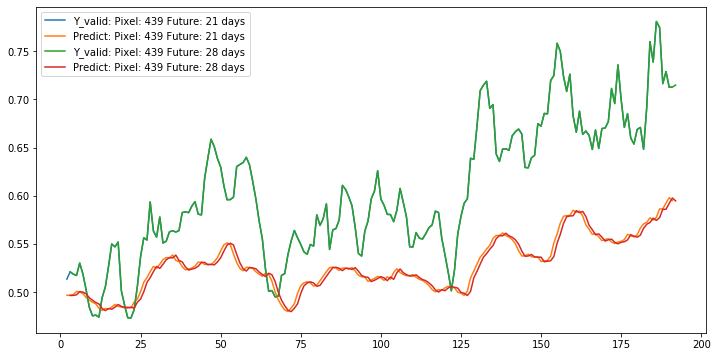

In [167]:
PlotTS([X_valid],Y_valid,model,top=10)

## EN_DEC LSTM Attention

In [431]:
# Sometimes helpful to implement own softmax activation function to
# better manage calculations along specific axes.
def softmax_activation(x):
    e = K.exp(x - K.max(x, axis=1, keepdims=True))
    s = K.sum(e, axis=1, keepdims=True)
    return e / s

In [432]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
X = Reshape((time_step, units))(X)
print()
h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

outputList = list()
for t in range(Y_train.shape[1] + 1):
    #build output for a single timestep
    h_prev_repeat = RepeatVector(time_step)(h_prev)
    joined = Concatenate(axis=-1)([X, h_prev_repeat])
    joined = Dense(int(joined.shape[2]), kernel_initializer = 'glorot_uniform', activation="tanh", name=f'attention_mid_dense_'+str(t))(joined)
    e_vals = Dense(1, kernel_initializer = 'glorot_uniform', activation='linear',  name=f'attention_final_dense_'+str(t))(joined)
    alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    #alphas = Activation('softmax', name=f'attention_softmax_'+str(t))(e_vals)
    attentions = Dot(axes=1)([alphas, X])
    #save states from previous batch 
    h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    
    if (t>0):
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='EN_DEC_LSTM_ATTENTION')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)



(None, 52, 25, 25, 1)

stack:  (None, 4, 625)
Model: "EN_DEC_LSTM_ATTENTION"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_134 (InputLayer)          [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_133 (TimeDistr (None, 52, 625)      0           input_134[0][0]                  
__________________________________________________________________________________________________
lstm_159 (LSTM)                 (None, 52, 100)      290400      time_distributed_133[0][0]       
__________________________________________________________________________________________________
h_start (InputLayer)            [(None, 100)]        0                                            
________________________________

In [433]:
h_start = np.zeros((X_train.shape[0], units*factor))
c_start = np.zeros((X_train.shape[0], units*factor))
h_startv = np.zeros((X_valid.shape[0], units*factor))
c_startv = np.zeros((X_valid.shape[0], units*factor))

EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train,h_start, c_start],y=Y_train, 
                             validation_data=([X_valid,h_startv, c_startv], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "EN_DEC_LSTM_ATTENTION"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_134 (InputLayer)          [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_133 (TimeDistr (None, 52, 625)      0           input_134[0][0]                  
__________________________________________________________________________________________________
lstm_159 (LSTM)                 (None, 52, 100)      290400      time_distributed_133[0][0]       
__________________________________________________________________________________________________
h_start (InputLayer)            [(None, 100)]        0                                            
______________________________________________________________________________

Epoch 1/500
567/573 [============================>.] - ETA: 0s - loss: 0.0520 - mae: 0.0520
Epoch 00001: val_loss improved from inf to 0.03096, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200730-201758_model.hdf5
573/573 [==============================] - 8s 14ms/sample - loss: 0.0518 - mae: 0.0518 - val_loss: 0.0310 - val_mae: 0.0310
Epoch 2/500
567/573 [============================>.] - ETA: 0s - loss: 0.0137 - mae: 0.0137
Epoch 00002: val_loss improved from 0.03096 to 0.00876, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200730-201758_model.hdf5
573/573 [==============================] - 1s 2ms/sample - loss: 0.0136 - mae: 0.0136 - val_loss: 0.0088 - val_mae: 0.0088
Epoch 3/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0059 - mae: 0.0059
Epoch 00003: val_loss improved 

Epoch 24/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0043 - mae: 0.0043
Epoch 00024: val_loss improved from 0.00664 to 0.00660, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200730-201758_model.hdf5
573/573 [==============================] - 1s 2ms/sample - loss: 0.0043 - mae: 0.0043 - val_loss: 0.0066 - val_mae: 0.0066
Epoch 25/500
567/573 [============================>.] - ETA: 0s - loss: 0.0042 - mae: 0.0042
Epoch 00025: val_loss did not improve from 0.00660
573/573 [==============================] - 1s 1ms/sample - loss: 0.0042 - mae: 0.0042 - val_loss: 0.0066 - val_mae: 0.0066
Epoch 26/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0043 - mae: 0.0043
Epoch 00026: val_loss did not improve from 0.00660
573/573 [==============================] - 1s 1ms/sample - loss: 0.0043 - mae: 0.0043 - val_loss: 0.0066 - val_mae: 0.0066
Epoch 27/500
546/573 [===

573/573 [==============================] - 1s 2ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 51/500
567/573 [============================>.] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00051: val_loss did not improve from 0.00634
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 52/500
567/573 [============================>.] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00052: val_loss did not improve from 0.00634
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 53/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00053: val_loss did not improve from 0.00634
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 54/500
525/573 [==========================>...] - ETA: 0s - loss: 0.00

Epoch 80/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00080: val_loss did not improve from 0.00628
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 81/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00081: val_loss did not improve from 0.00628
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 82/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00082: val_loss did not improve from 0.00628
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 83/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00083: val_loss did not improve from 0.00628
573/573 [==============================] - 1s 1ms/sampl

525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00108: val_loss did not improve from 0.00608
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0062 - val_mae: 0.0062
Epoch 109/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00109: val_loss improved from 0.00608 to 0.00594, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200730-201758_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 110/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00110: val_loss did not improve from 0.00594
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0060 - val_mae: 0.0060
Epoch 111/500
567/573 [=============

525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00136: val_loss did not improve from 0.00574
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 137/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00137: val_loss did not improve from 0.00574
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 138/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00138: val_loss did not improve from 0.00574
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 139/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00139: val_loss did not improve from 0.00574
573/573 [==============================] - 1s 1ms/sample - loss: 

546/573 [===========================>..] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00164: val_loss did not improve from 0.00559
573/573 [==============================] - 1s 1ms/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 165/500
567/573 [============================>.] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00165: val_loss did not improve from 0.00559
573/573 [==============================] - 1s 1ms/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 166/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00166: val_loss did not improve from 0.00559
573/573 [==============================] - 1s 1ms/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 167/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00167: val_loss did not improve from 0.00559
573/573 [==============================] - 1s 1ms/sample - loss: 

Epoch 193/500
567/573 [============================>.] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00193: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 194/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00194: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 195/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00195: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 196/500
567/573 [============================>.] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00196: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/s

Epoch 224/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00224: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 225/500
567/573 [============================>.] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00225: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 226/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00226: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 227/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00227: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 1ms/s

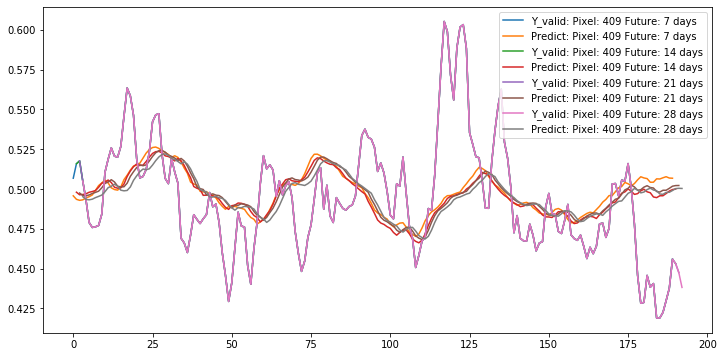

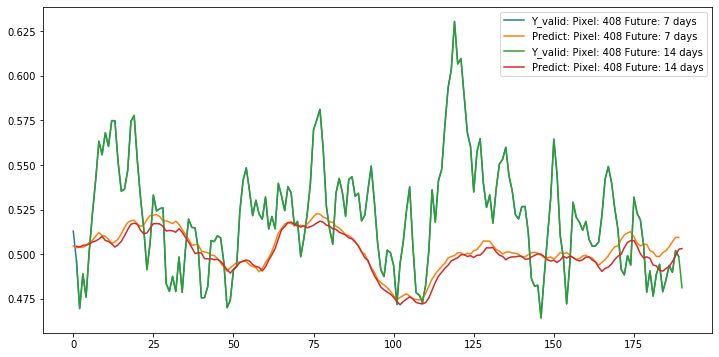

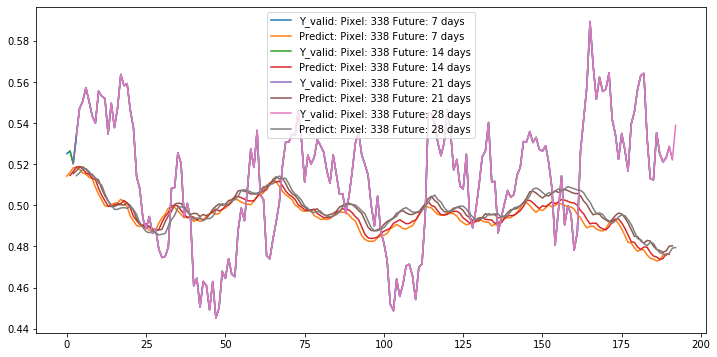

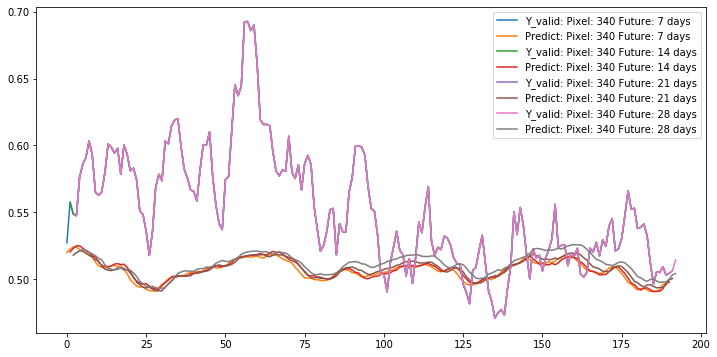

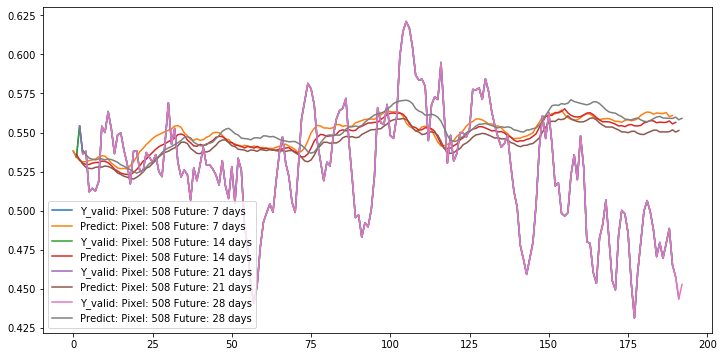

...

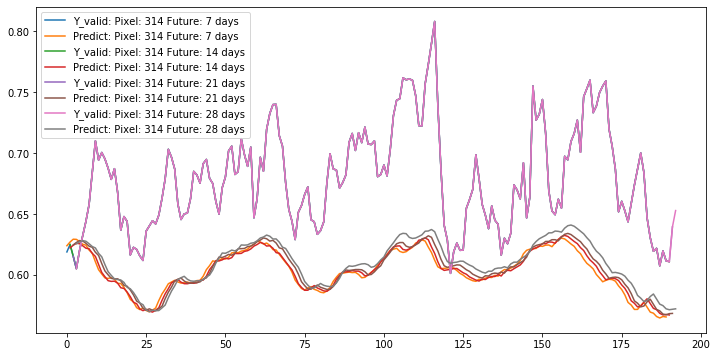

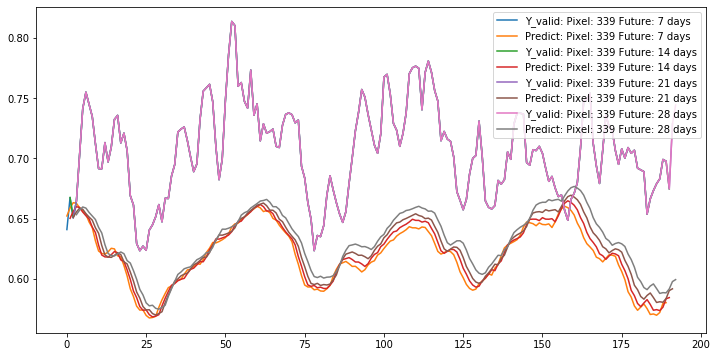

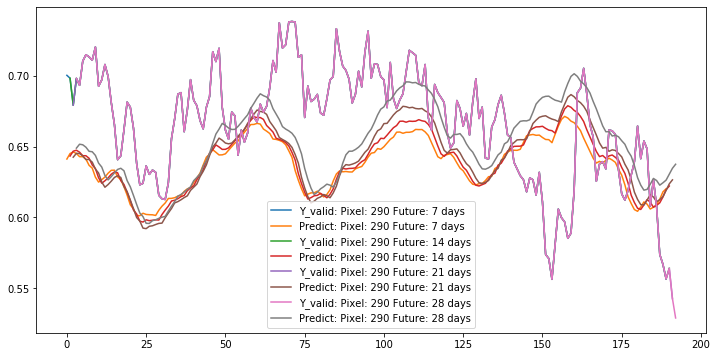

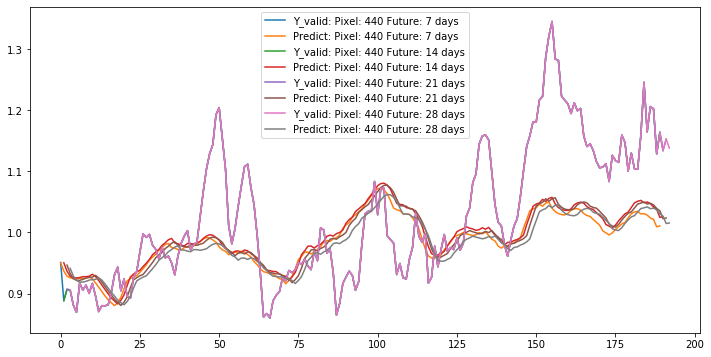

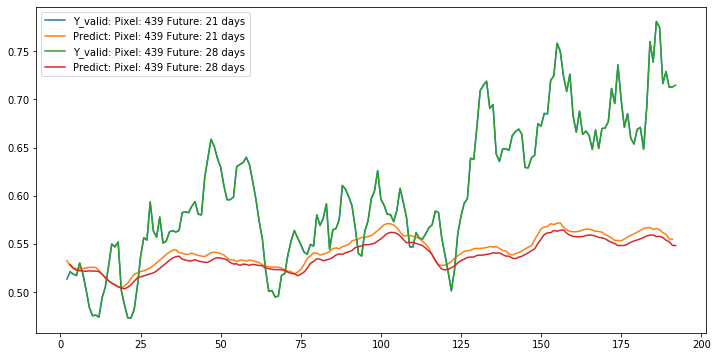

In [434]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10)

## Encoder + Decoder with LSTM for each timestep out

In [428]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
factor = 1
X = LSTM(units,return_sequences=True)(TimeDist)
print(X.shape)
X = Reshape((time_step, units))(X)
print(X.shape)
h_start = Input(shape=(units*factor,), name='h_start')
print("h_start.shape:",h_start.shape)
c_start = Input(shape=(units*factor,), name='c_start')
h_prev = h_start
c_prev = c_start

outputList = list()
for t in range(Y_train.shape[1]+1):
    h_prev, _, c_prev = LSTM(units*factor, return_state=True,name=f'layer_2_LSTM_{t}')(X, initial_state=[h_prev, c_prev])
    if t > 0:
        out = Dense(Y_train.shape[2],activation='linear', name=f'dense_output_{t}')(h_prev)
        outputList.append(out)
outputs = tf.stack(outputList,1)
print(outputs.shape)
model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='EN_DEC_LSTM')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)

(None, 52, 25, 25, 1)
(None, 52, 100)
(None, 52, 100)
h_start.shape: (None, 100)
(None, 4, 625)
Model: "EN_DEC_LSTM"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_133 (InputLayer)          [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_132 (TimeDistr (None, 52, 625)      0           input_133[0][0]                  
__________________________________________________________________________________________________
lstm_158 (LSTM)                 (None, 52, 100)      290400      time_distributed_132[0][0]       
__________________________________________________________________________________________________
reshape_342 (Reshape)           (None, 52, 100)      0           lstm_158[0][0]            

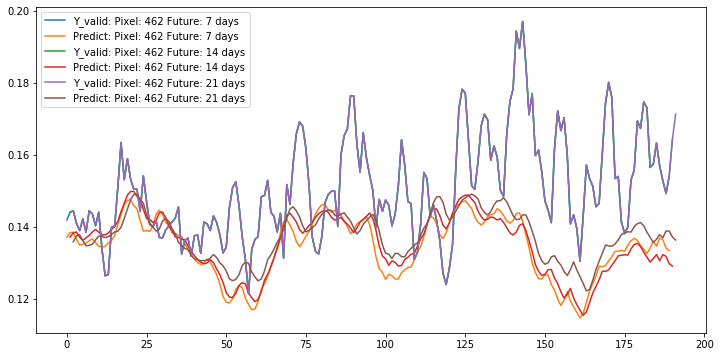

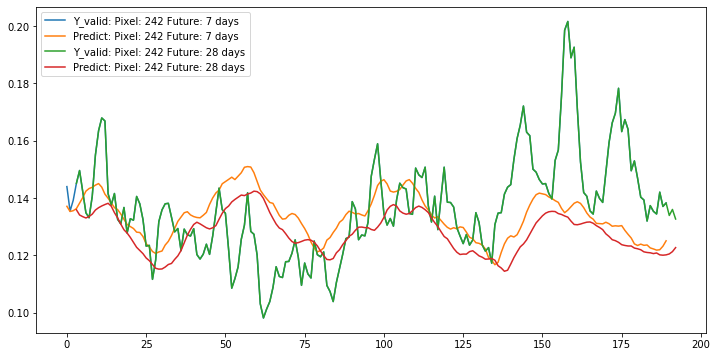

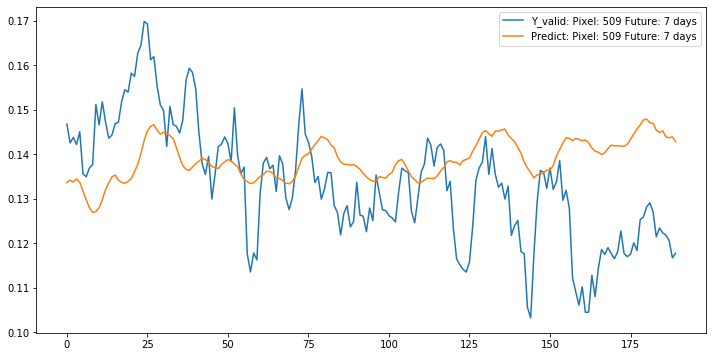

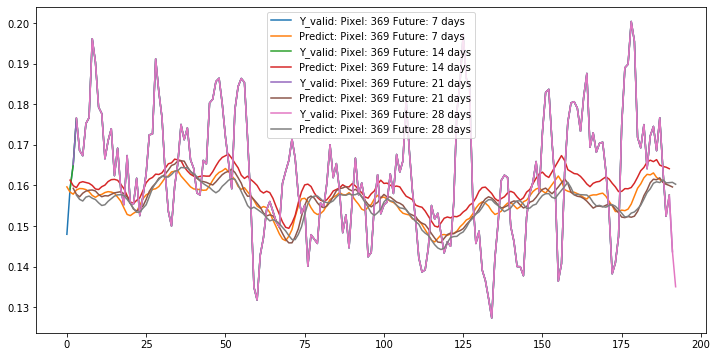

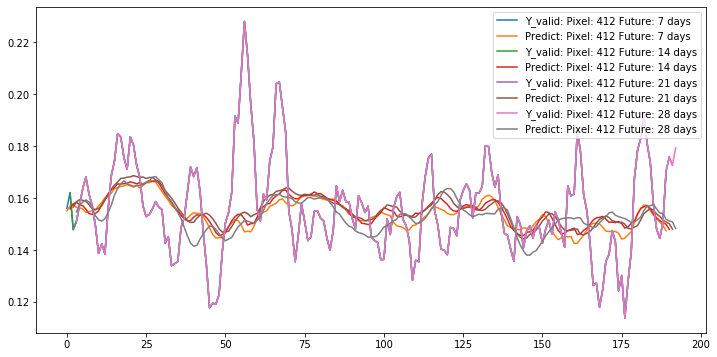

...

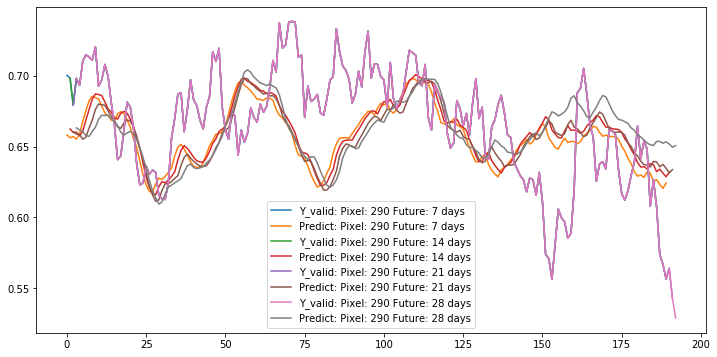

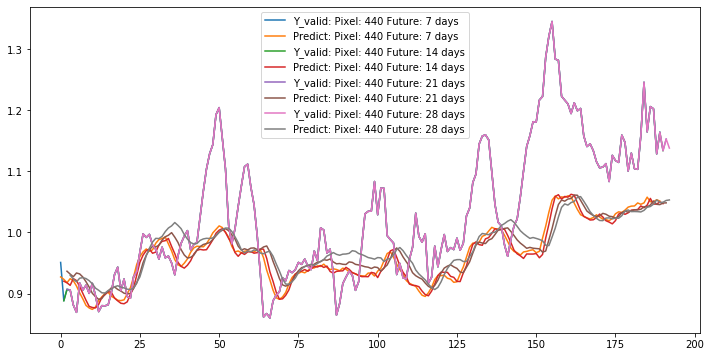

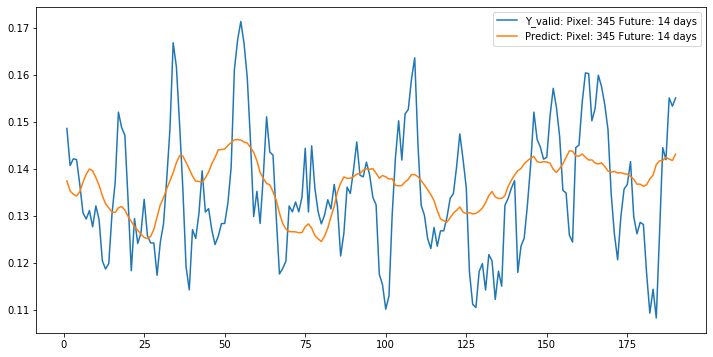

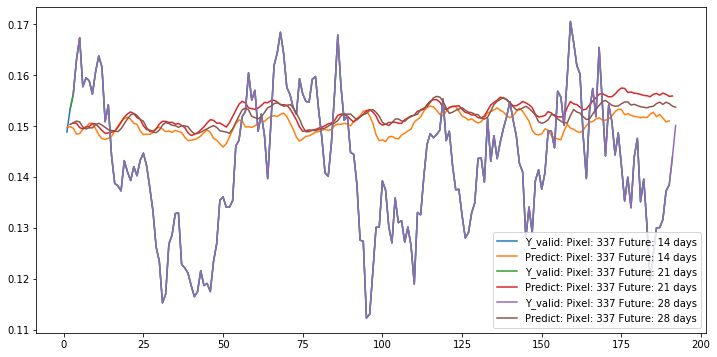

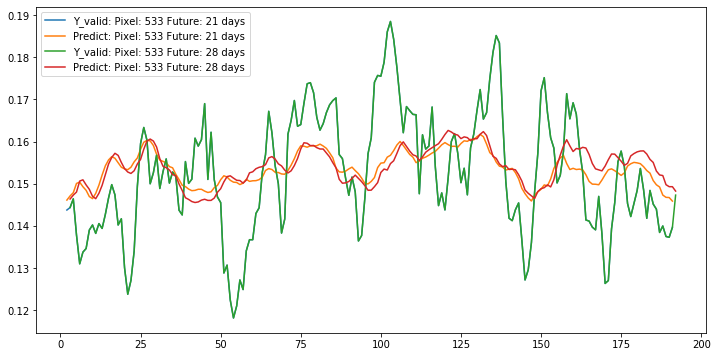

In [430]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=100) 

## LSTM + Attention on LSTM units frequency

#### Correction on attention. On attention_W_dense_, compare with only the lastest hidden state.

In [183]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

timeDist = Permute([2, 1])(X) #transpose for FFT. FFT library treats the last dimension as time
fftLayer = Lambda(lambda x : tf.math.abs(tf.signal.rfft(x)))(timeDist) ## transform to frequency domain with TF
fftLayer  = Permute([2, 1], name="fft_out")(fftLayer)#transpose back for the following shape

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([fftLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_Q_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, fftLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 27, 1)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 27, 1)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 27, 1)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 27, 1)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 27, 1)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
stack:  (None, 4, 625)
Model: "LSTM_ATTENTION_Freq"
_________________________________

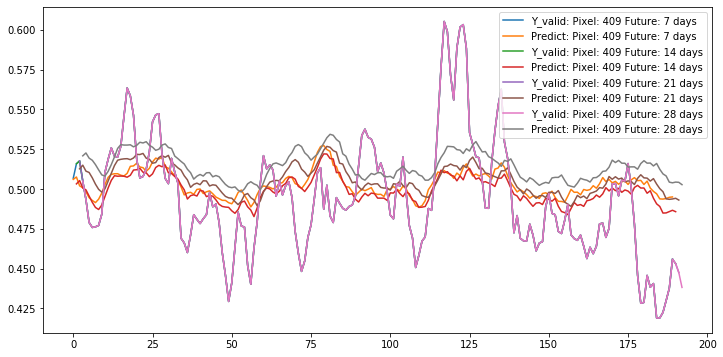

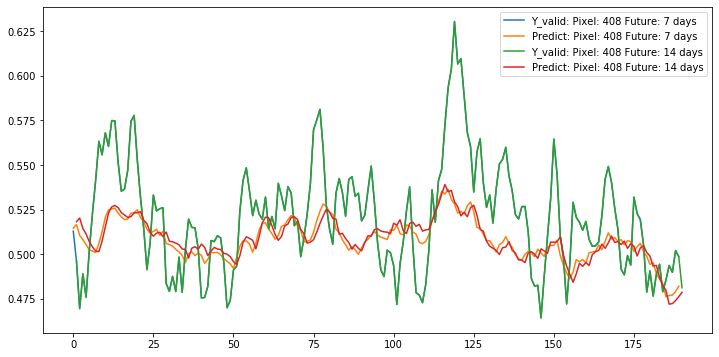

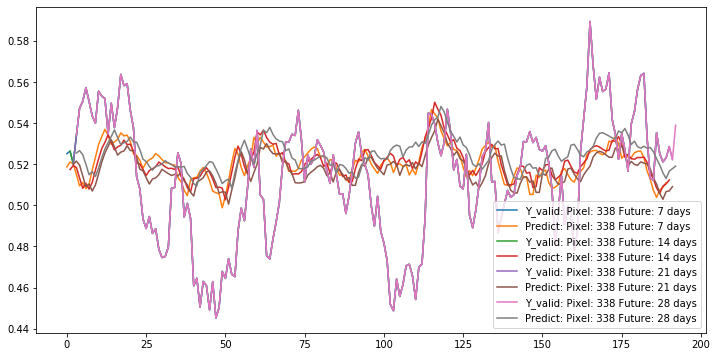

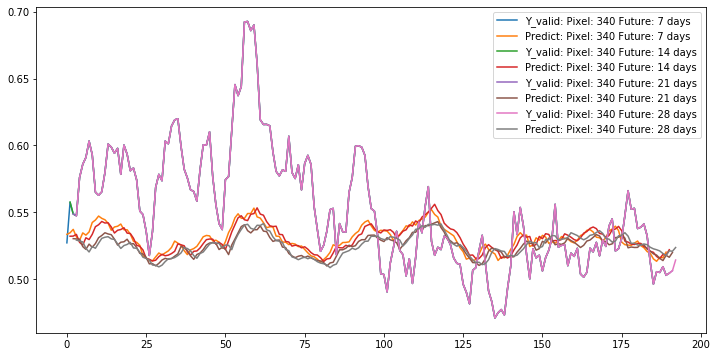

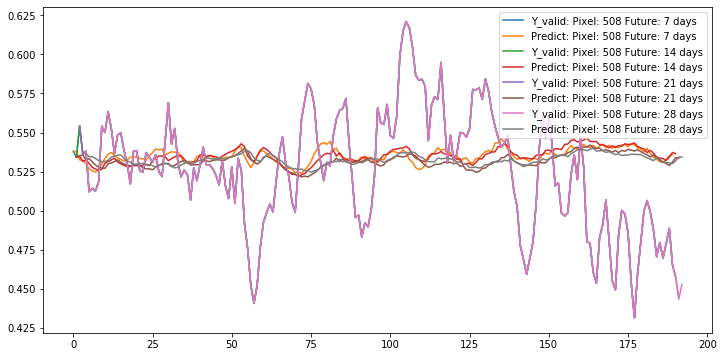

...

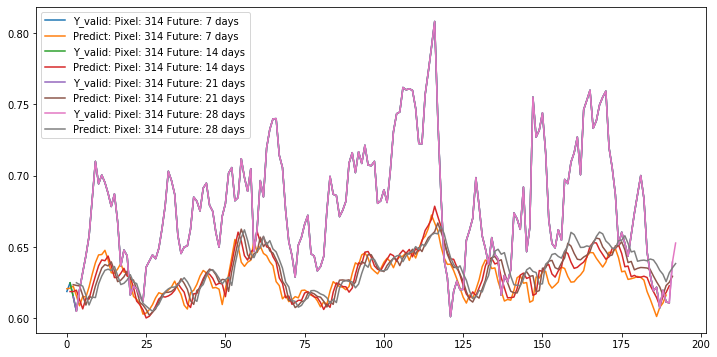

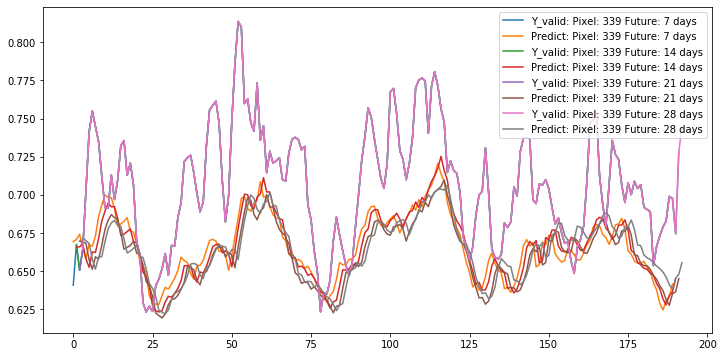

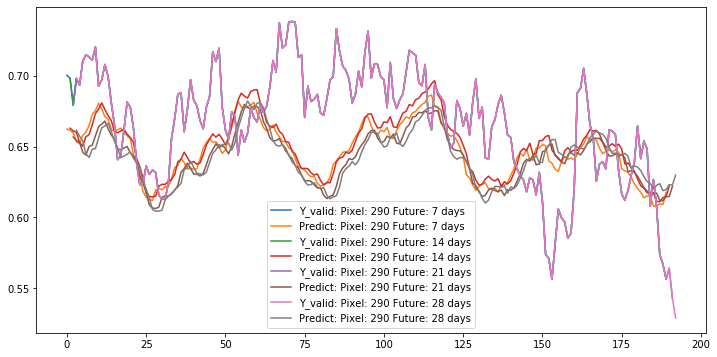

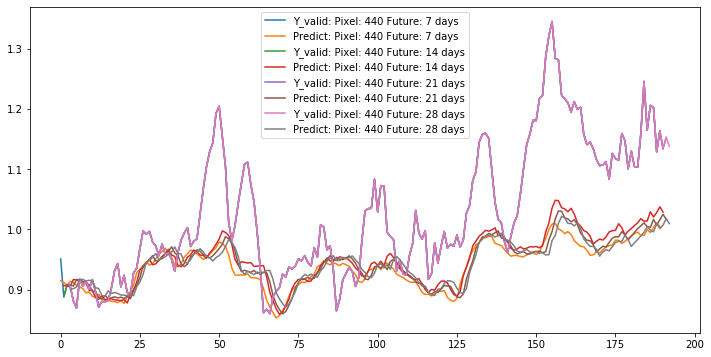

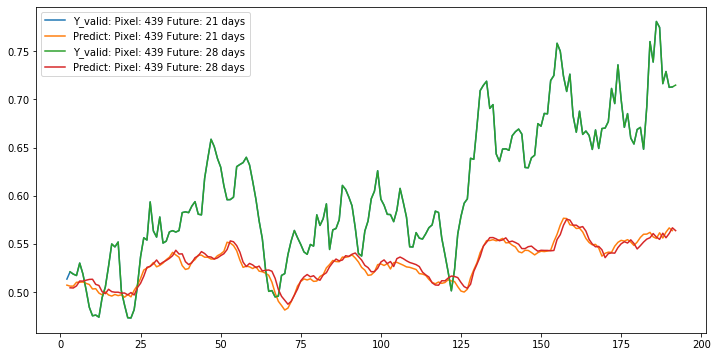

In [39]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10) 

#### we plot attention against frequency

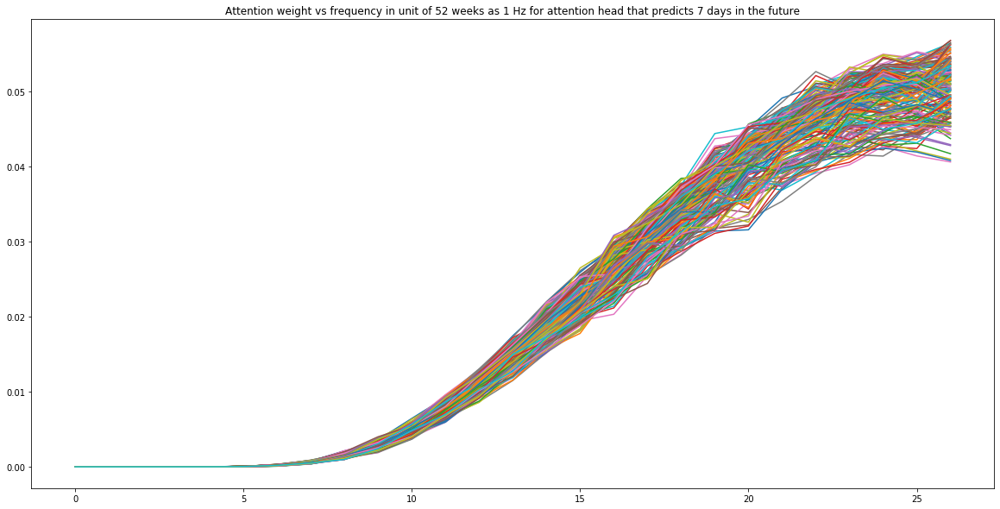

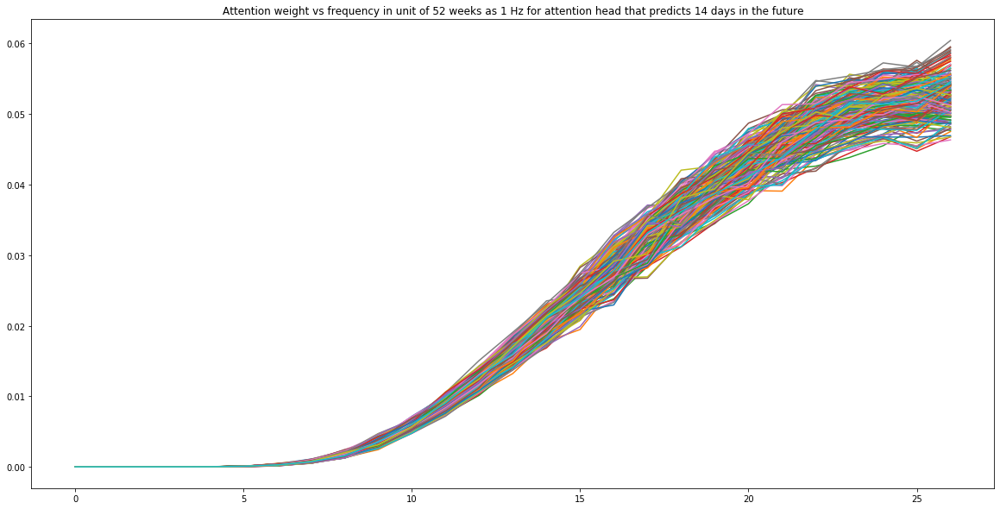

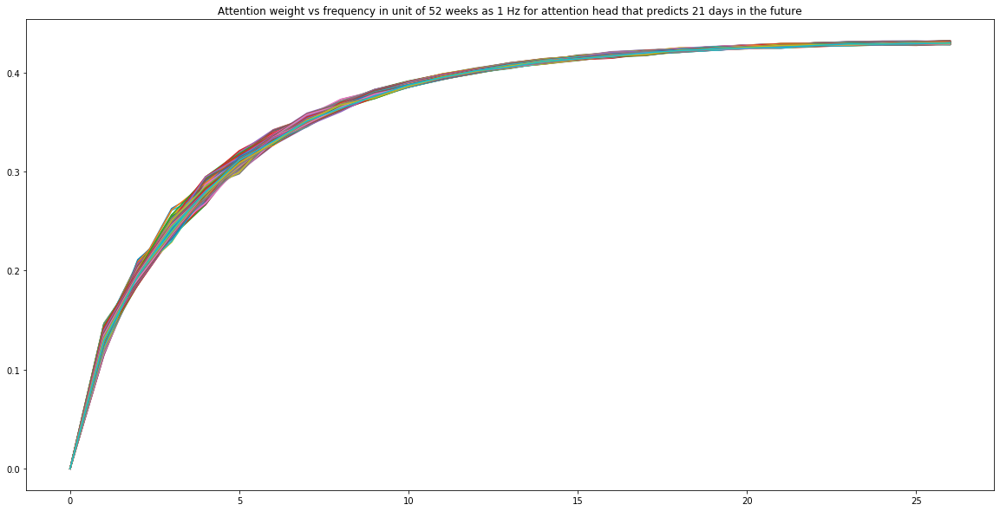

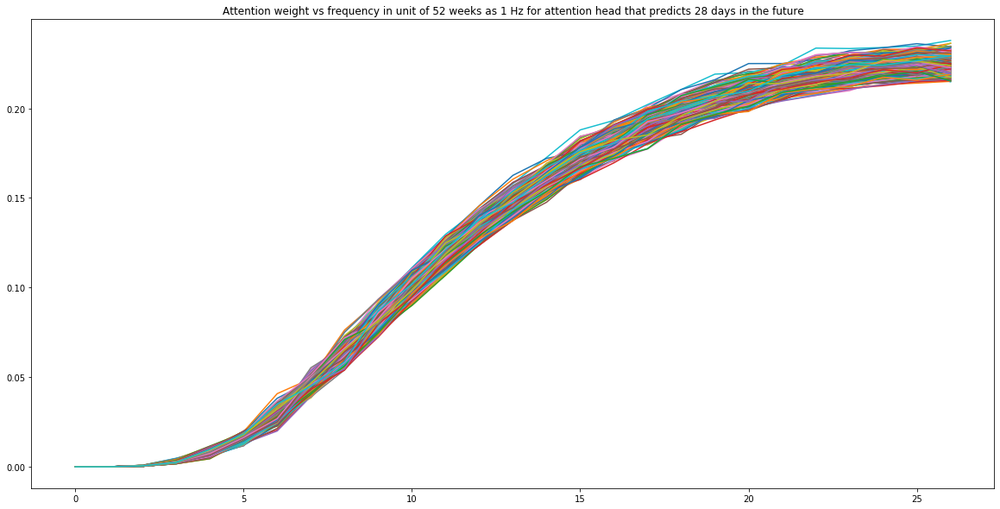

In [417]:
for t in range(Y_valid.shape[1]):
    model_AttentionOut = model  # include here your original model

    layer_name = 'attention_sigmoid_'+str(t+1)

    intermediate_layer_model = Model(inputs=model_AttentionOut.input,
                                     outputs=model_AttentionOut.get_layer(layer_name).output)
    h_startv = np.zeros((X_valid.shape[0], units*factor))
    c_startv = np.zeros((X_valid.shape[0], units*factor))

    plt.figure(figsize=(20,10))
    for timeStepWeek in range(X_valid.shape[0]):
        #print(X_valid[timeStepWeek:timeStepWeek+1].shape)
        intermediate_output = intermediate_layer_model.predict([X_valid[timeStepWeek:timeStepWeek+1],h_startv[timeStepWeek:timeStepWeek+1], c_startv[timeStepWeek:timeStepWeek+1]])
        #print(intermediate_output.shape)
        plt.title(f'Attention weight vs frequency in unit of 52 weeks as 1 Hz for attention head that predicts {(t+1)*7} days in the future')
        plt.plot(intermediate_output[0])
        #plt.show()
    plt.show()

#### Removed query and LSTM output layer identical to the paper implementation here: https://arxiv.org/pdf/1809.04206.pdf

## Best Model - Final Model being tested

In [35]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 80
X = LSTM(units,return_sequences=True)(TimeDist)
X = Reshape((time_step, units))(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

timeDist = Permute([2, 1])(X) #transpose for FFT. FFT library treats the last dimension as time
fftLayer = Lambda(lambda x : tf.math.abs(tf.signal.rfft(x)))(timeDist) ## transform to frequency domain with TF
fftLayer  = Permute([2, 1], name="fft_out")(fftLayer)#transpose back for the following shape

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([fftLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(scoringfunc)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, fftLayer])
    print("attentions",attentions.shape)
 
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        #save states from previous samples
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)

(None, 52, 25, 25, 1)
joined.shape (None, 80)
joined.shape (None, 80, 1)
scoringfunc.shape (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 80)
joined.shape (None, 80)
joined.shape (None, 80, 1)
scoringfunc.shape (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 80)
X (None, 80)
out:  (None, 625)
joined.shape (None, 80)
joined.shape (None, 80, 1)
scoringfunc.shape (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 80)
X (None, 80)
out:  (None, 625)
joined.shape (None, 80)
joined.shape (None, 80, 1)
scoringfunc.shape (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 80)
X (None, 80)
out:  (None, 625)
joined.shape (None, 80)
joined.shape (None, 80, 1)
scoringfunc.shape (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 80)
X (None, 80)
out:  (None, 625)
stack:  (None, 4, 625)
Model: "LSTM_ATTENTION_Freq"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param

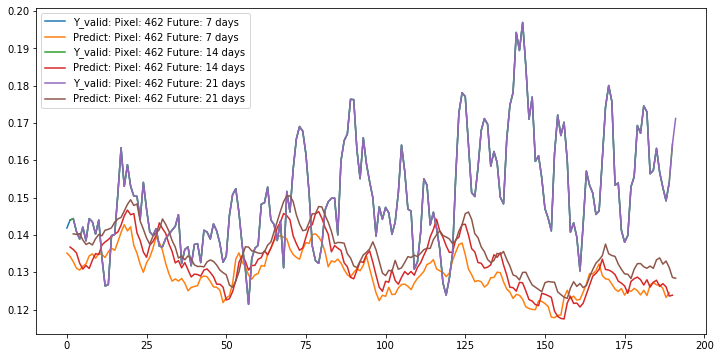

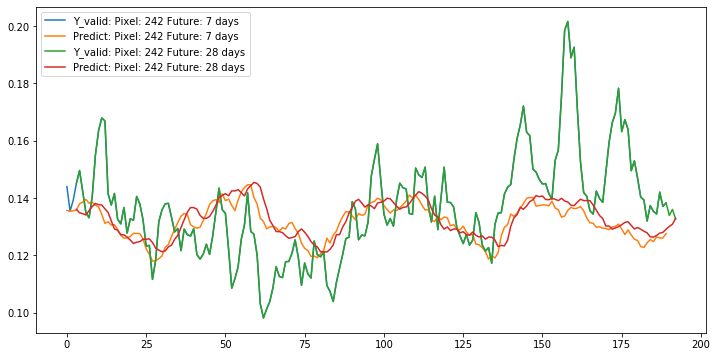

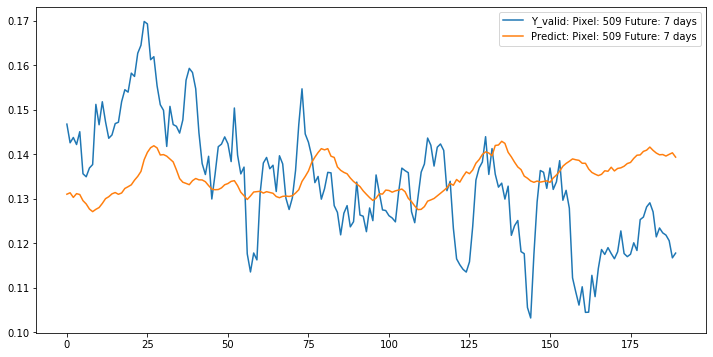

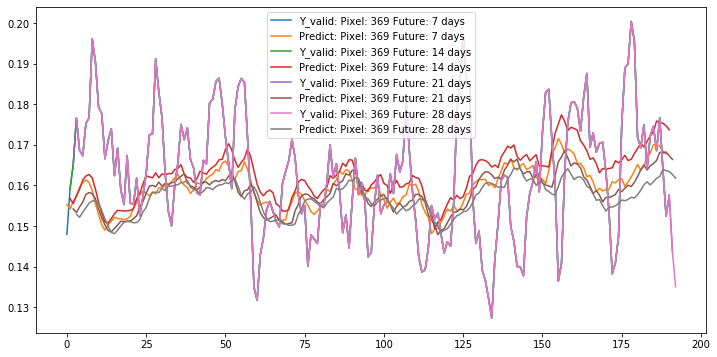

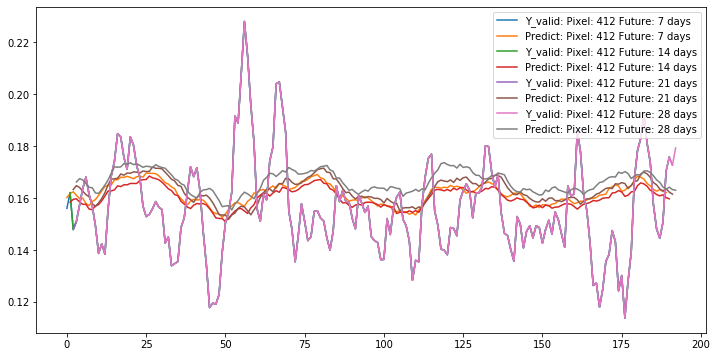

...

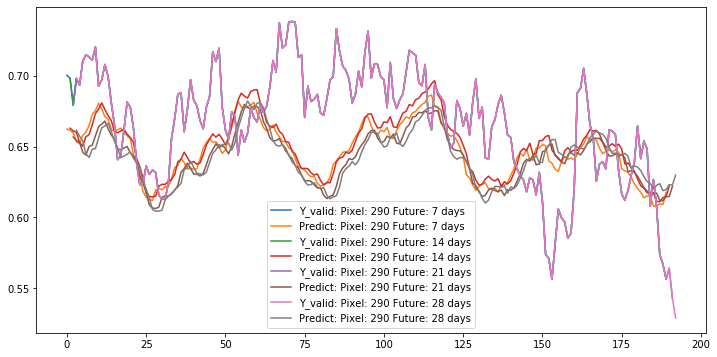

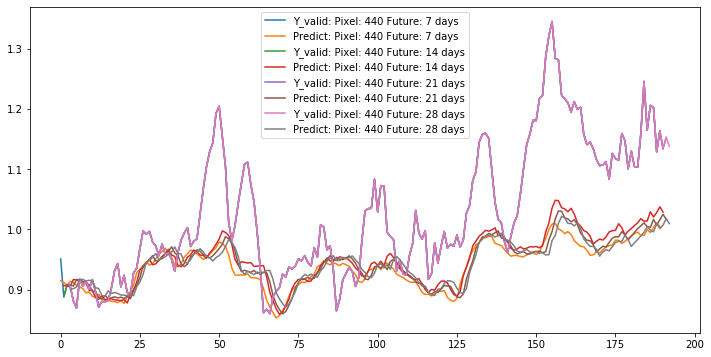

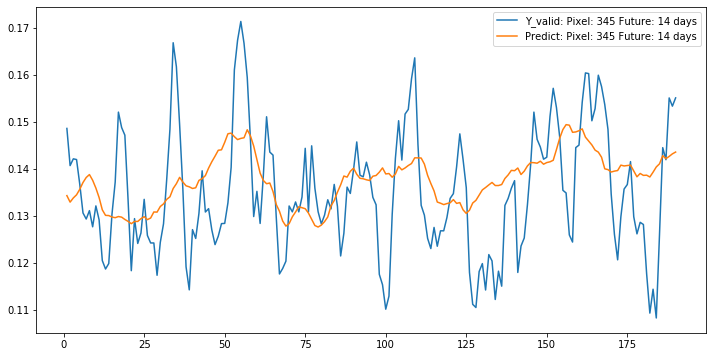

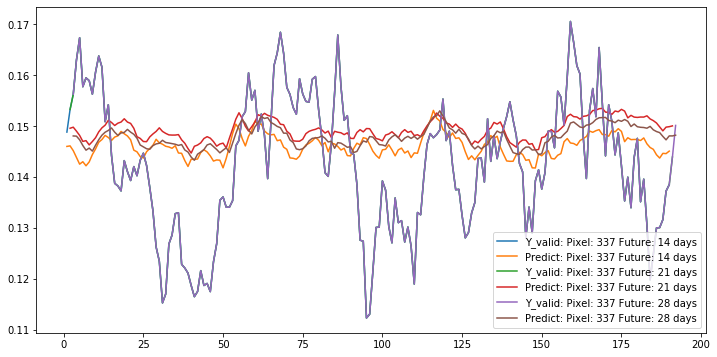

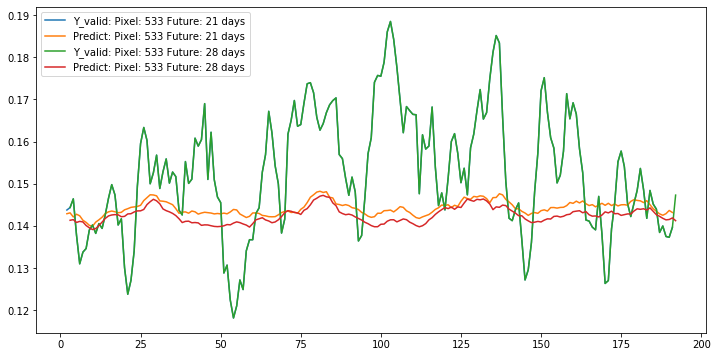

In [37]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=100) 

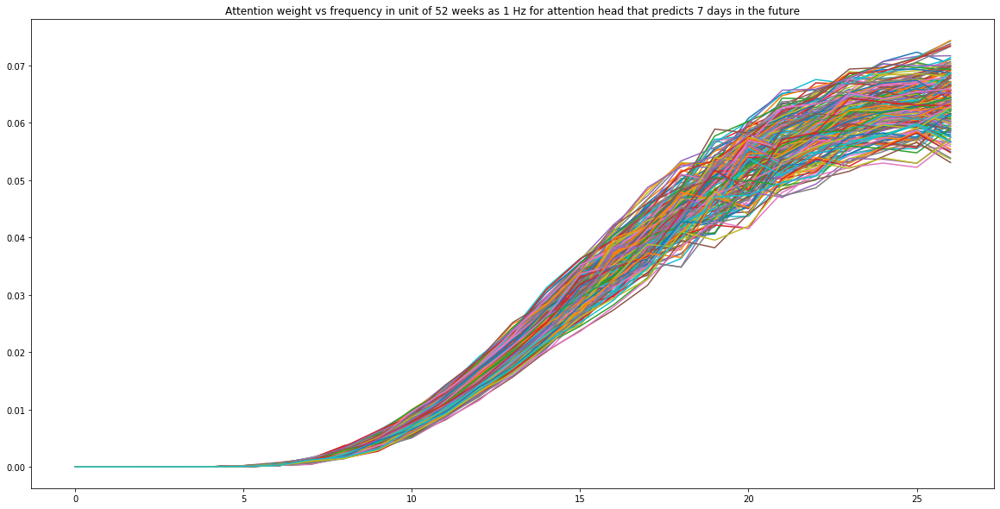

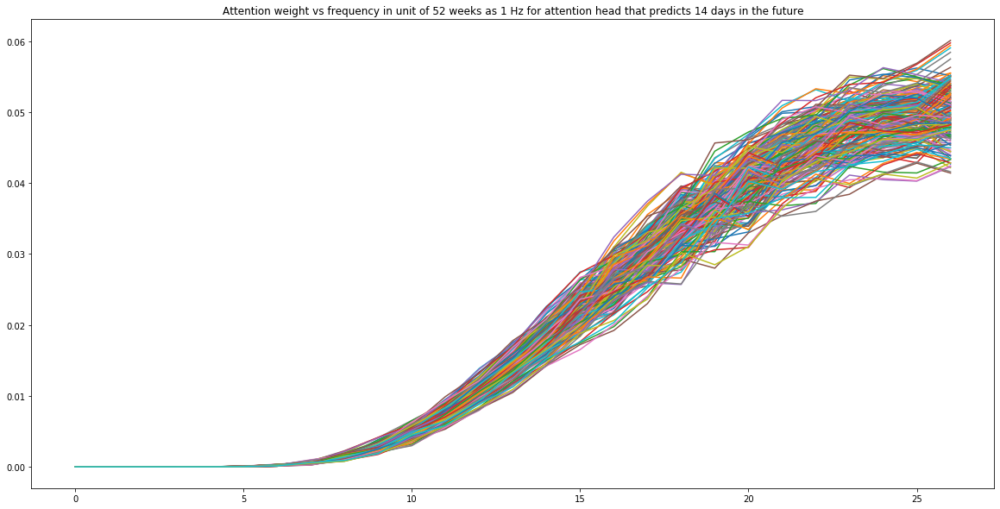

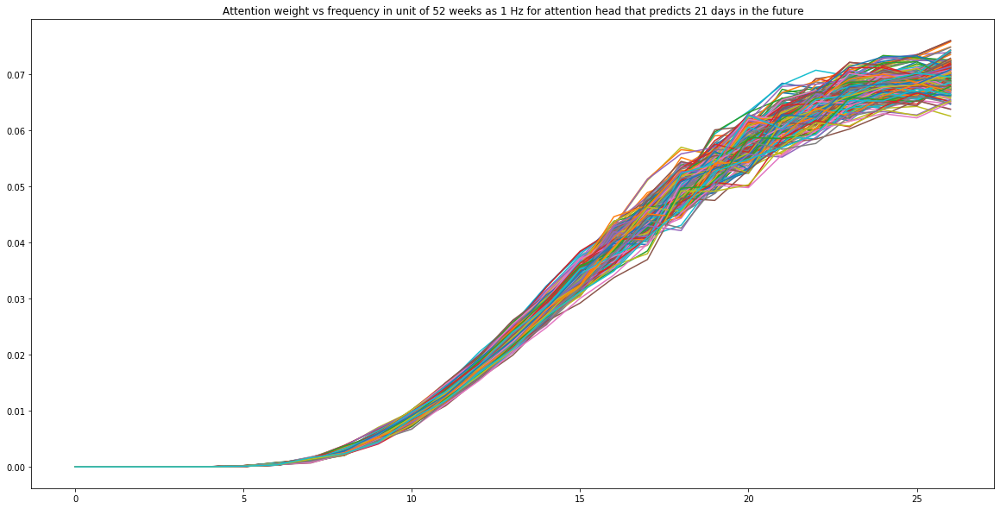

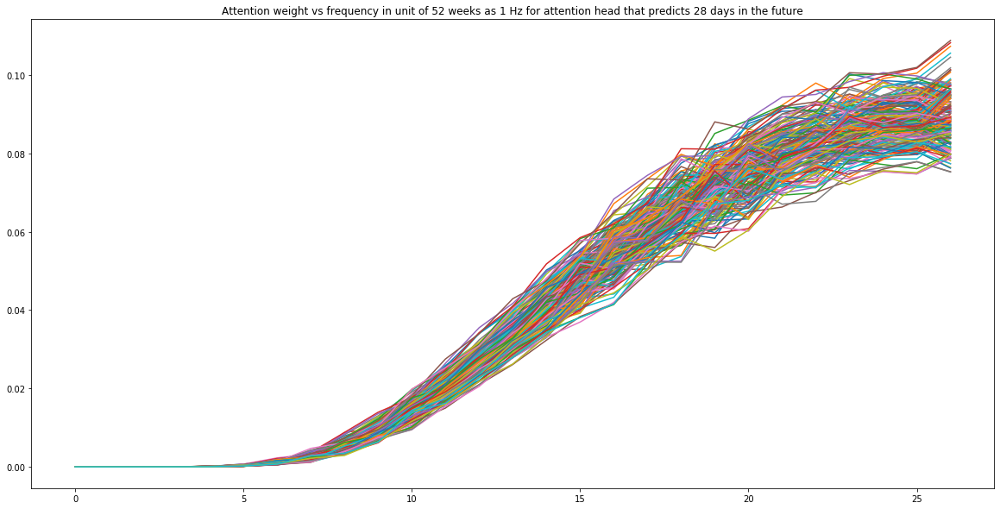

In [38]:
for t in range(Y_valid.shape[1]):
    model_AttentionOut = model  # include here your original model

    layer_name = 'attention_sigmoid_'+str(t+1)

    intermediate_layer_model = Model(inputs=model_AttentionOut.input,
                                     outputs=model_AttentionOut.get_layer(layer_name).output)
    h_startv = np.zeros((X_valid.shape[0], units*factor))
    c_startv = np.zeros((X_valid.shape[0], units*factor))

    plt.figure(figsize=(20,10))
    for timeStepWeek in range(X_valid.shape[0]):
        #print(X_valid[timeStepWeek:timeStepWeek+1].shape)
        intermediate_output = intermediate_layer_model.predict([X_valid[timeStepWeek:timeStepWeek+1],h_startv[timeStepWeek:timeStepWeek+1], c_startv[timeStepWeek:timeStepWeek+1]])
        #print(intermediate_output.shape)
        plt.title(f'Attention weight vs frequency in unit of 52 weeks as 1 Hz for attention head that predicts {(t+1)*7} days in the future')
        plt.plot(intermediate_output[0])
        #plt.show()
    plt.show()

#### High pass on FFT

In [185]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

timeDist = Permute([2, 1])(X) #transpose for FFT. FFT library treats the last dimension as time
fftLayer = Lambda(lambda x : tf.math.abs(tf.signal.rfft(x)))(timeDist) ## transform to frequency domain with TF
fftLayer  = Permute([2, 1], name="fft_out")(fftLayer)#transpose back for the following shape
fftLayer = fftLayer[:,5:,:] #remove the first 2 freq

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([fftLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_Q_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, fftLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 22, 1)
e_vals (None, 22, 1)
alphas (None, 22, 1)
attentions (None, 1, 100)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 22, 1)
e_vals (None, 22, 1)
alphas (None, 22, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 22, 1)
e_vals (None, 22, 1)
alphas (None, 22, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 22, 1)
e_vals (None, 22, 1)
alphas (None, 22, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 22, 1)
e_vals (None, 22, 1)
alphas (None, 22, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
stack:  (None, 4, 625)
Model: "LSTM_ATTENTION_Freq"
_________________________________

#### try STFT instead of FFT

In [36]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

timeDist2 = Permute([2, 1])(X) #transpose for FFT. FFT library treats the last dimension as time
window_length = 10 #14,1 #26,1
fftLayer = Lambda(lambda x : tf.math.abs(
    tf.signal.stft(
    x, window_length, 1, fft_length=None,
    window_fn=tf.signal.hann_window, pad_end=False, name=None
)))(timeDist2) ## transform to frequency domain with TF
print('fftLayer.shape',fftLayer.shape)  
fftLayer = tf.reshape(fftLayer, [-1, fftLayer.shape[1] , fftLayer.shape[2] * fftLayer.shape[3]])
fftLayer  = Permute([2, 1], name="fft_out")(fftLayer)#transpose back for the following shape
#fftLayer = fftLayer[:,5:,:] #remove the first 2 freq
print("fftLayer.shape",fftLayer.shape)

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([fftLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_Q_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, fftLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
fftLayer.shape (None, 100, 43, 9)
fftLayer.shape (None, 387, 100)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 387, 1)
e_vals (None, 387, 1)
alphas (None, 387, 1)
attentions (None, 1, 100)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 387, 1)
e_vals (None, 387, 1)
alphas (None, 387, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 387, 1)
e_vals (None, 387, 1)
alphas (None, 387, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 387, 1)
e_vals (None, 387, 1)
alphas (None, 387, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 100)
joined.shape (None, 100, 1)
scoringfunc.shape (None, 387, 1)
e_vals (None, 387, 1)
alphas (None, 387, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
stac

In [453]:
valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0052 - mae: 0.0052
valid_accuracy_MAE=0.005214207, valid_loss=0.005214206766533224
190/190 - 0s - loss: 0.0082 - mae: 0.0082
test_accuracy_MAE=0.008238829, test_loss=0.008238828192023855


## 1D CNN 

In [168]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 80#100
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("X[:,:,0:1].shape",X[:,:,0:1].shape)

cellList = list()
for cell_unit in range(X.shape[-1]):
    print("cell_unit: ", cell_unit)
    CNN_List = list()
    for ks in [2,4,6,8,10,14,18,22,26]: #[20:22]: #varing time period range for CNN filter size
        CNN = Conv1D(filters=1, kernel_size=ks, activation='relu')(X[:,:,cell_unit:cell_unit+1]) #for each LSTM unit
        #print(CNN.shape)
        CNN_List.append(CNN)
    cnnVector = Concatenate(axis=1)(CNN_List)
    print("cnnVector.shape",cnnVector.shape)
    cellList.append(cnnVector)
        
    
HcLayer = Concatenate(axis=-1)(cellList)
print("HcLayer.shape",HcLayer.shape)

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([HcLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_Q_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, HcLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 80)
X[:,:,0:1].shape (None, 52, 1)
cell_unit:  0
cnnVector.shape (None, 367, 1)
cell_unit:  1
cnnVector.shape (None, 367, 1)
cell_unit:  2
cnnVector.shape (None, 367, 1)
cell_unit:  3
cnnVector.shape (None, 367, 1)
cell_unit:  4
cnnVector.shape (None, 367, 1)
cell_unit:  5
cnnVector.shape (None, 367, 1)
cell_unit:  6
cnnVector.shape (None, 367, 1)
cell_unit:  7
cnnVector.shape (None, 367, 1)
cell_unit:  8
cnnVector.shape (None, 367, 1)
cell_unit:  9
cnnVector.shape (None, 367, 1)
cell_unit:  10
cnnVector.shape (None, 367, 1)
cell_unit:  11
cnnVector.shape (None, 367, 1)
cell_unit:  12
cnnVector.shape (None, 367, 1)
cell_unit:  13
cnnVector.shape (None, 367, 1)
cell_unit:  14
cnnVector.shape (None, 367, 1)
cell_unit:  15
cnnVector.shape (None, 367, 1)
cell_unit:  16
cnnVector.shape (None, 367, 1)
cell_unit:  17
cnnVector.shape (None, 367, 1)
cell_unit:  18
cnnVector.shape (None, 367, 1)
cell_unit:  19
cnnVector.shape (None, 367, 1)
cell_unit:  20

conv1d_8565 (Conv1D)            (None, 51, 1)        3           tf_op_layer_strided_slice_8485[0]
__________________________________________________________________________________________________
conv1d_8566 (Conv1D)            (None, 49, 1)        5           tf_op_layer_strided_slice_8486[0]
__________________________________________________________________________________________________
conv1d_8567 (Conv1D)            (None, 47, 1)        7           tf_op_layer_strided_slice_8487[0]
__________________________________________________________________________________________________
conv1d_8568 (Conv1D)            (None, 45, 1)        9           tf_op_layer_strided_slice_8488[0]
__________________________________________________________________________________________________
conv1d_8569 (Conv1D)            (None, 43, 1)        11          tf_op_layer_strided_slice_8489[0]
__________________________________________________________________________________________________
conv1d_857

concatenate_833 (Concatenate)   (None, 367, 1)       0           conv1d_8880[0][0]                
                                                                 conv1d_8881[0][0]                
                                                                 conv1d_8882[0][0]                
                                                                 conv1d_8883[0][0]                
                                                                 conv1d_8884[0][0]                
                                                                 conv1d_8885[0][0]                
                                                                 conv1d_8886[0][0]                
                                                                 conv1d_8887[0][0]                
                                                                 conv1d_8888[0][0]                
__________________________________________________________________________________________________
concatenat

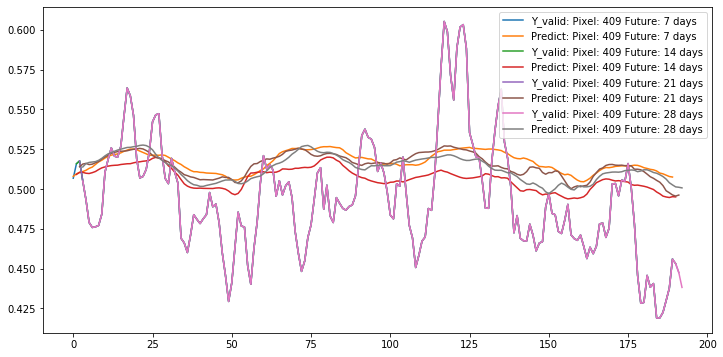

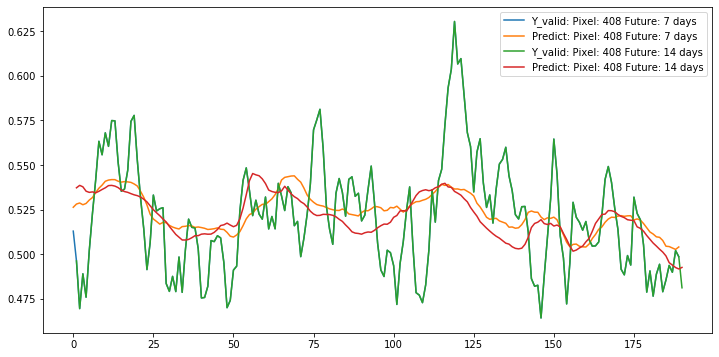

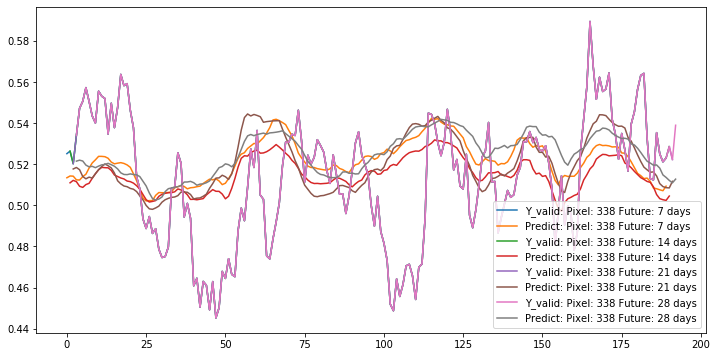

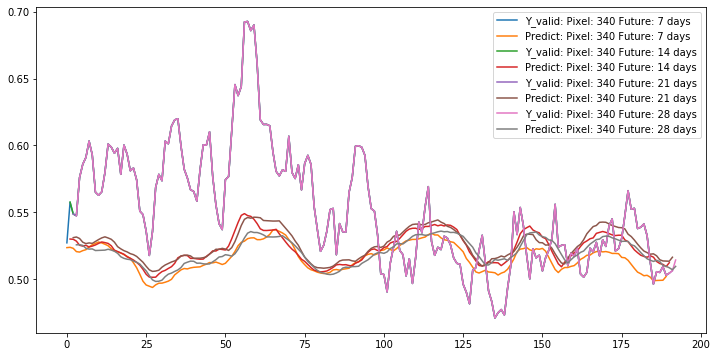

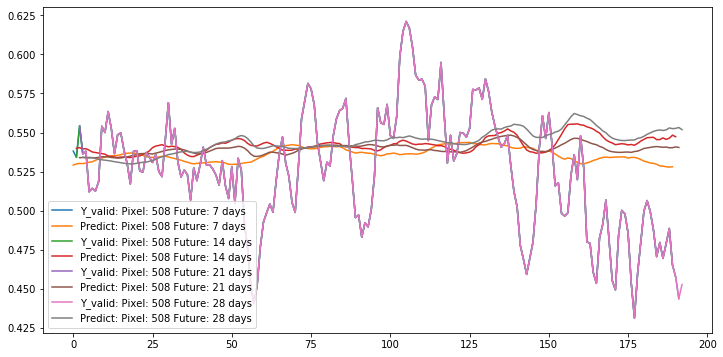

...

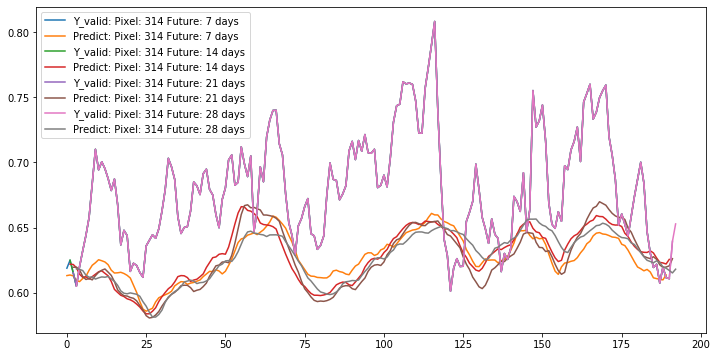

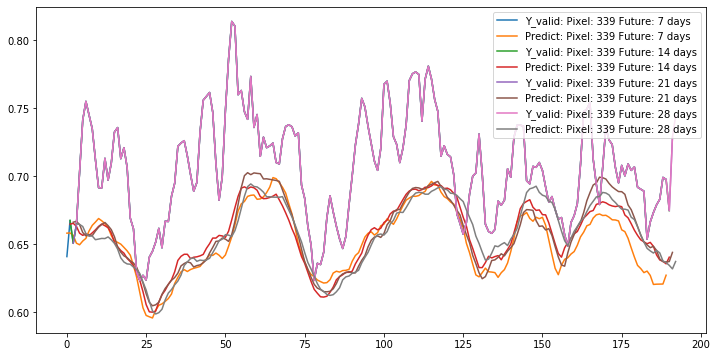

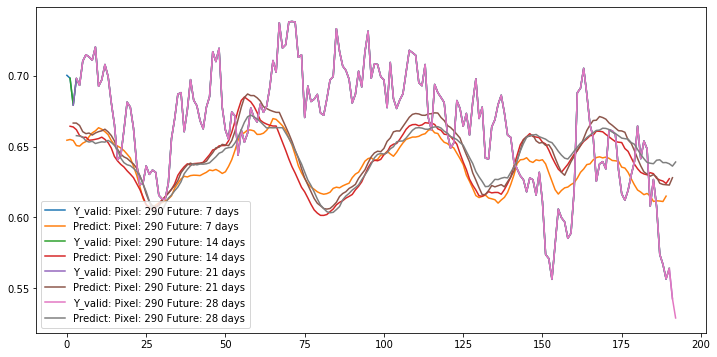

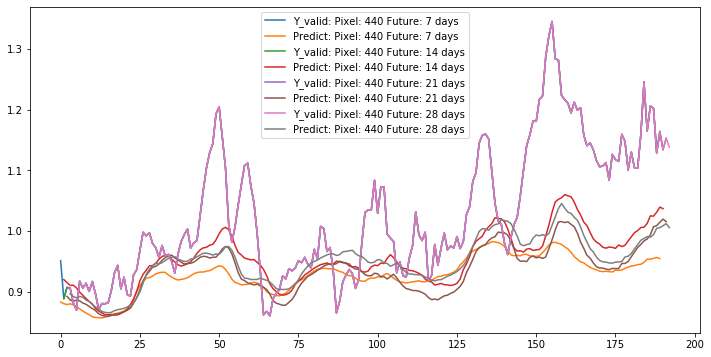

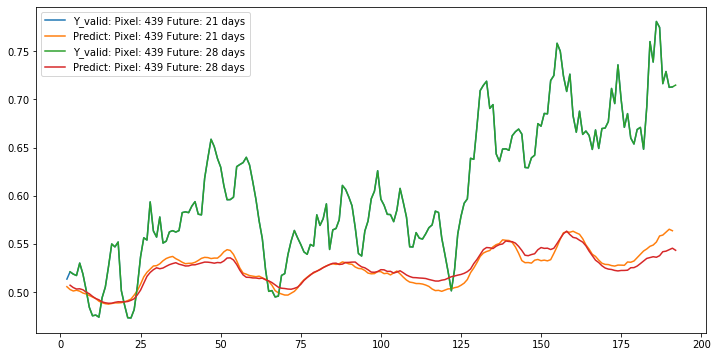

In [52]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10) 

In [51]:
valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0052 - mae: 0.0052
valid_accuracy_MAE=0.005166262, valid_loss=0.005166261648073009
190/190 - 0s - loss: 0.0079 - mae: 0.0079
test_accuracy_MAE=0.007923293, test_loss=0.007923292858820213


## 1D CNN Pooled

In [79]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 32#100
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("X[:,:,0:1].shape",X[:,:,0:1].shape)

cellList = list()
for cell_unit in range(X.shape[-1]):
    print("cell_unit: ", cell_unit)
    CNN_List = list()
    for ks in range(2,26,1): #[2,3,5,7,9,10,12,18,26]: #[20:22]: #varing time period range for CNN filter size
        CNN = Conv1D(filters=1, kernel_size=ks, activation='relu')(X[:,:,cell_unit:cell_unit+1]) #for each LSTM unit
        for i in range(6):
            if CNN.shape[1] > 1:
                CNN = MaxPooling1D(pool_size=2,padding='valid')(CNN)
        
        print(CNN.shape)
        CNN_List.append(CNN)
    cnnVector = Concatenate(axis=1)(CNN_List)
    print("cnnVector.shape",cnnVector.shape)
    cellList.append(cnnVector)
        
    
HcLayer = Concatenate(axis=-1)(cellList)
print("HcLayer.shape",HcLayer.shape)

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([HcLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_Q_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, HcLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 32)
X[:,:,0:1].shape (None, 52, 1)
cell_unit:  0
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
cnnVector.shape (None, 24, 1)
cell_unit:  1
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
cnnVector.shape (None, 24, 1)
cell_unit:  2
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(No

(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
cnnVector.shape (None, 24, 1)
cell_unit:  23
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
cnnVector.shape (None, 24, 1)
cell_unit:  24
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
cnnVector.shape (None, 24, 1)
cell_unit:  25
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 1, 1)
(None, 

__________________________________________________________________________________________________
tf_op_layer_strided_slice_5981  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
tf_op_layer_strided_slice_5986  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
tf_op_layer_strided_slice_5987  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
tf_op_layer_strided_slice_5988  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
tf_op_layer_strided_slice_5989  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________

tf_op_layer_strided_slice_5886  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
tf_op_layer_strided_slice_5887  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
tf_op_layer_strided_slice_5888  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
tf_op_layer_strided_slice_5889  [(None, 52, 1)]      0           lstm_18[0][0]                    
__________________________________________________________________________________________________
conv1d_6481 (Conv1D)            (None, 51, 1)        3           tf_op_layer_strided_slice_5890[0]
__________________________________________________________________________________________________
conv1d_648

conv1d_6456 (Conv1D)            (None, 28, 1)        26          tf_op_layer_strided_slice_5865[0]
__________________________________________________________________________________________________
max_pooling1d_13516 (MaxPooling (None, 25, 1)        0           conv1d_6457[0][0]                
__________________________________________________________________________________________________
max_pooling1d_13521 (MaxPooling (None, 25, 1)        0           conv1d_6458[0][0]                
__________________________________________________________________________________________________
max_pooling1d_13526 (MaxPooling (None, 24, 1)        0           conv1d_6459[0][0]                
__________________________________________________________________________________________________
max_pooling1d_13531 (MaxPooling (None, 24, 1)        0           conv1d_6460[0][0]                
__________________________________________________________________________________________________
max_poolin

max_pooling1d_13905 (MaxPooling (None, 10, 1)        0           max_pooling1d_13904[0][0]        
__________________________________________________________________________________________________
max_pooling1d_13910 (MaxPooling (None, 10, 1)        0           max_pooling1d_13909[0][0]        
__________________________________________________________________________________________________
max_pooling1d_13915 (MaxPooling (None, 10, 1)        0           max_pooling1d_13914[0][0]        
__________________________________________________________________________________________________
max_pooling1d_13920 (MaxPooling (None, 10, 1)        0           max_pooling1d_13919[0][0]        
__________________________________________________________________________________________________
max_pooling1d_13925 (MaxPooling (None, 9, 1)         0           max_pooling1d_13924[0][0]        
__________________________________________________________________________________________________
max_poolin

max_pooling1d_10936 (MaxPooling (None, 2, 1)         0           max_pooling1d_10935[0][0]        
__________________________________________________________________________________________________
max_pooling1d_10941 (MaxPooling (None, 2, 1)         0           max_pooling1d_10940[0][0]        
__________________________________________________________________________________________________
max_pooling1d_10946 (MaxPooling (None, 2, 1)         0           max_pooling1d_10945[0][0]        
__________________________________________________________________________________________________
max_pooling1d_10950 (MaxPooling (None, 3, 1)         0           max_pooling1d_10949[0][0]        
__________________________________________________________________________________________________
max_pooling1d_10954 (MaxPooling (None, 3, 1)         0           max_pooling1d_10953[0][0]        
__________________________________________________________________________________________________
max_poolin

max_pooling1d_12435 (MaxPooling (None, 1, 1)         0           max_pooling1d_12434[0][0]        
__________________________________________________________________________________________________
max_pooling1d_12440 (MaxPooling (None, 1, 1)         0           max_pooling1d_12439[0][0]        
__________________________________________________________________________________________________
max_pooling1d_12445 (MaxPooling (None, 1, 1)         0           max_pooling1d_12444[0][0]        
__________________________________________________________________________________________________
max_pooling1d_12450 (MaxPooling (None, 1, 1)         0           max_pooling1d_12449[0][0]        
__________________________________________________________________________________________________
max_pooling1d_12455 (MaxPooling (None, 1, 1)         0           max_pooling1d_12454[0][0]        
__________________________________________________________________________________________________
max_poolin

Total params: 240,204
Trainable params: 240,204
Non-trainable params: 0
__________________________________________________________________________________________________


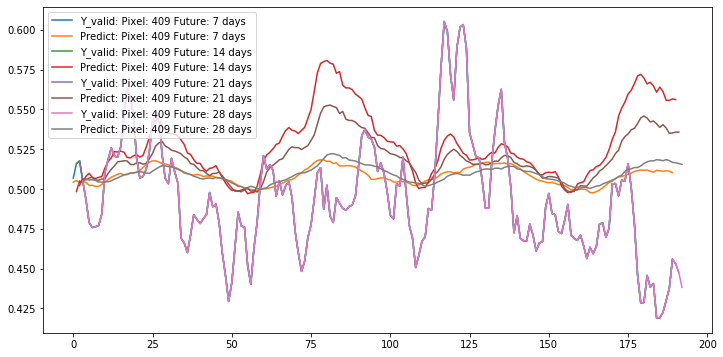

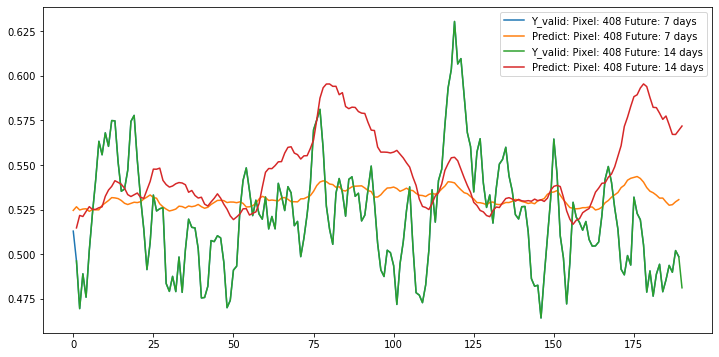

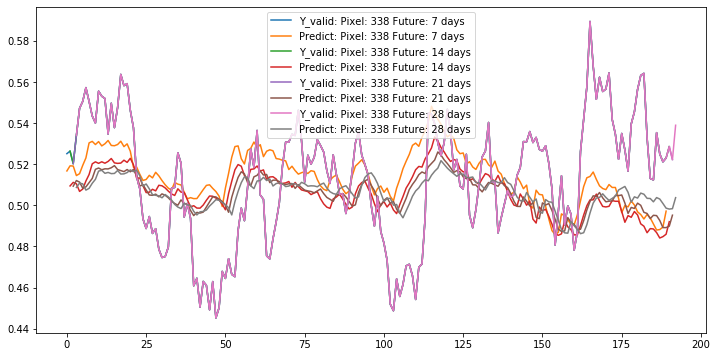

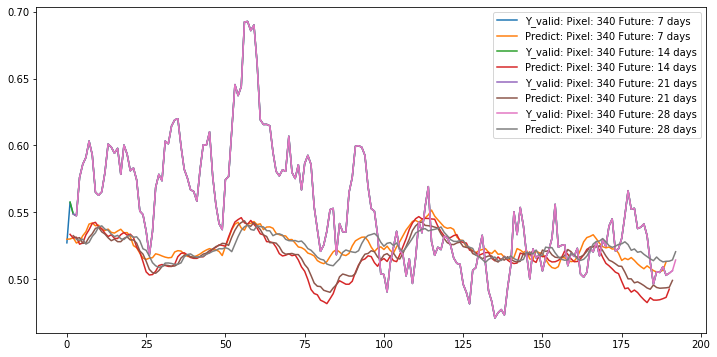

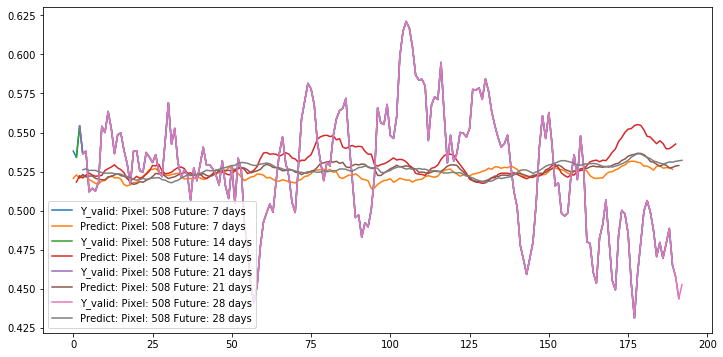

...

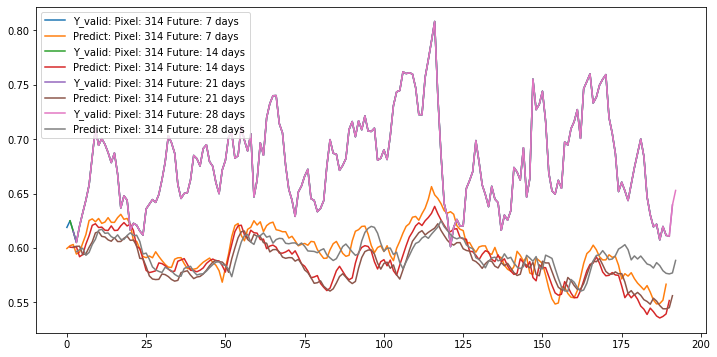

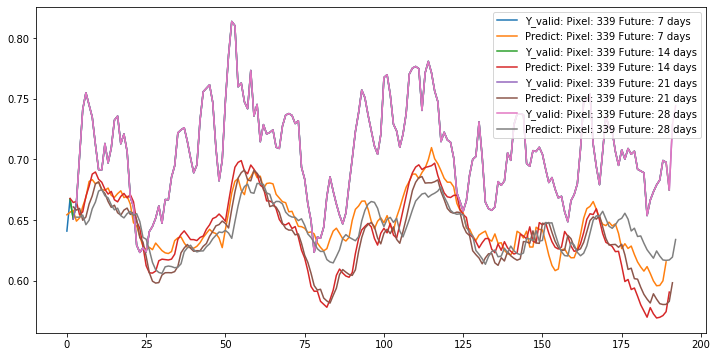

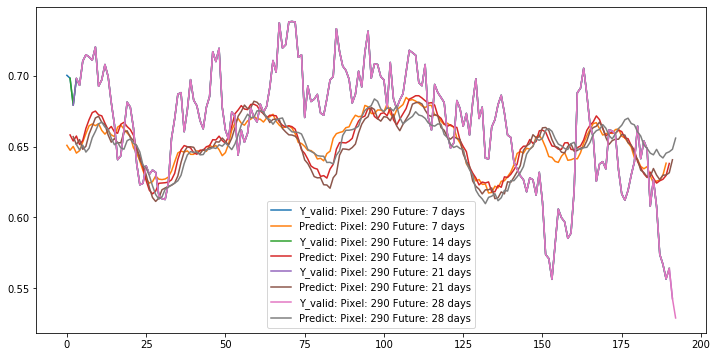

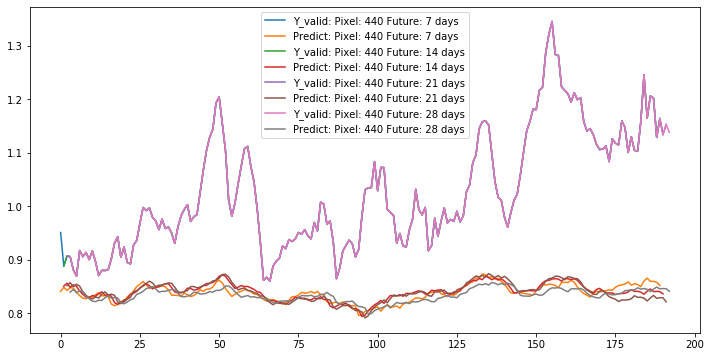

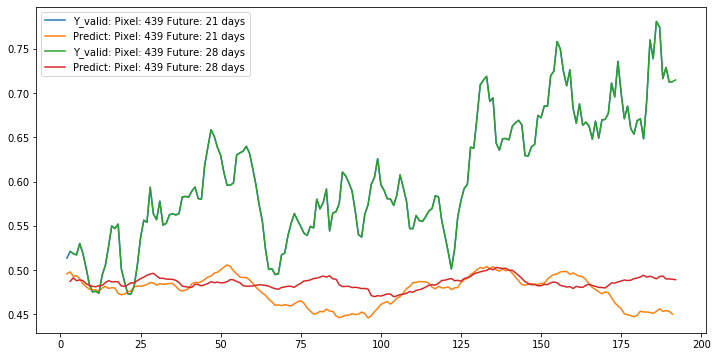

In [81]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10) 

In [82]:
valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 1s - loss: 0.0057 - mae: 0.0057
valid_accuracy_MAE=0.0057444344, valid_loss=0.005744434270615641
190/190 - 1s - loss: 0.0095 - mae: 0.0095
test_accuracy_MAE=0.009461744, test_loss=0.009461744659041104


## 1D CNN with filter size = window size + 32 filters per feature/LSTM unit

In [169]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 32 #32#100
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("X[:,:,0:1].shape",X[:,:,0:1].shape)

cellList = list()
for cell_unit in range(X.shape[-1]):
    print("cell_unit: ", cell_unit)
    CNN_List = list()
    for ks in [52]: #[2,3,5,7,9,10,12,18,26]: #[20:22]: #varing time period range for CNN filter size
        CNN = Conv1D(filters=32, kernel_size=ks, activation='relu')(X[:,:,cell_unit:cell_unit+1]) #for each LSTM unit
        CNN = Reshape((CNN.shape[-1],1))(CNN)
        print("CNN.shape", CNN.shape)
        #CNN_List.append(CNN)
    #cnnVector = Concatenate(axis=1)(CNN_List)
    #print("cnnVector.shape",cnnVector.shape)
    #cellList.append(cnnVector)
    cellList.append(CNN)
        
    
HcLayer = Concatenate(axis=-1)(cellList)
print("HcLayer.shape",HcLayer.shape)

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([HcLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_Q_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, HcLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 32)
X[:,:,0:1].shape (None, 52, 1)
cell_unit:  0
CNN.shape (None, 32, 1)
cell_unit:  1
CNN.shape (None, 32, 1)
cell_unit:  2
CNN.shape (None, 32, 1)
cell_unit:  3
CNN.shape (None, 32, 1)
cell_unit:  4
CNN.shape (None, 32, 1)
cell_unit:  5
CNN.shape (None, 32, 1)
cell_unit:  6
CNN.shape (None, 32, 1)
cell_unit:  7
CNN.shape (None, 32, 1)
cell_unit:  8
CNN.shape (None, 32, 1)
cell_unit:  9
CNN.shape (None, 32, 1)
cell_unit:  10
CNN.shape (None, 32, 1)
cell_unit:  11
CNN.shape (None, 32, 1)
cell_unit:  12
CNN.shape (None, 32, 1)
cell_unit:  13
CNN.shape (None, 32, 1)
cell_unit:  14
CNN.shape (None, 32, 1)
cell_unit:  15
CNN.shape (None, 32, 1)
cell_unit:  16
CNN.shape (None, 32, 1)
cell_unit:  17
CNN.shape (None, 32, 1)
cell_unit:  18
CNN.shape (None, 32, 1)
cell_unit:  19
CNN.shape (None, 32, 1)
cell_unit:  20
CNN.shape (None, 32, 1)
cell_unit:  21
CNN.shape (None, 32, 1)
cell_unit:  22
CNN.shape (None, 32, 1)
cell_unit:  23
CNN.shape (None, 32, 1

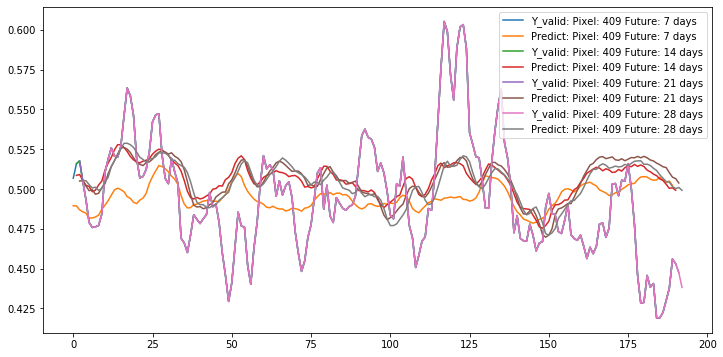

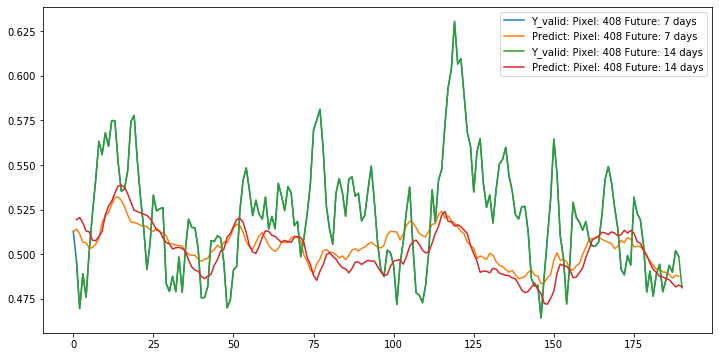

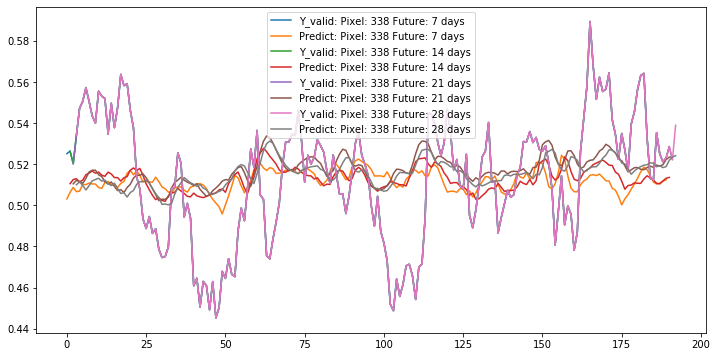

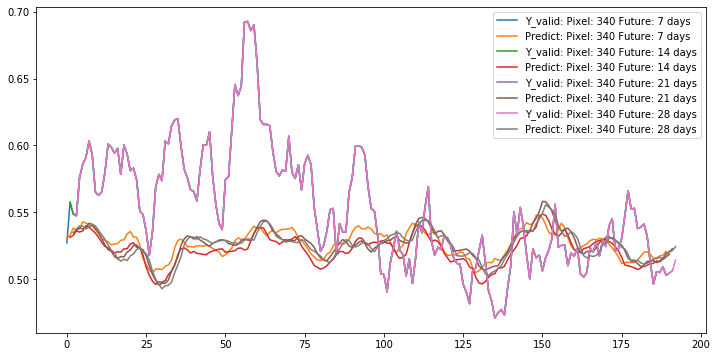

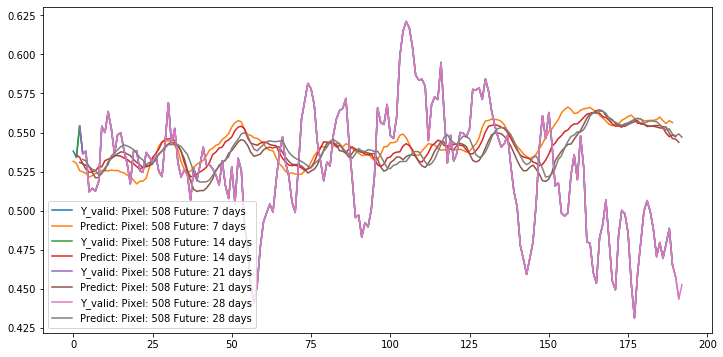

...

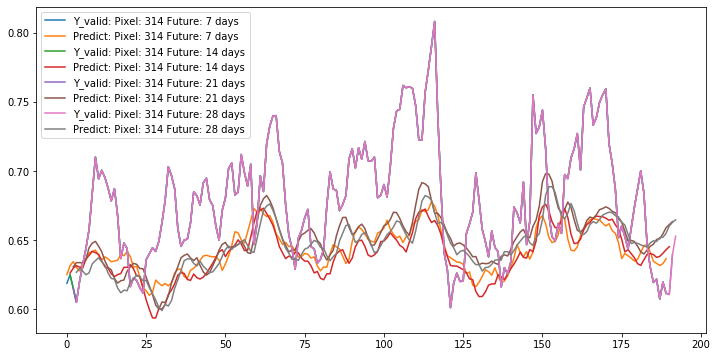

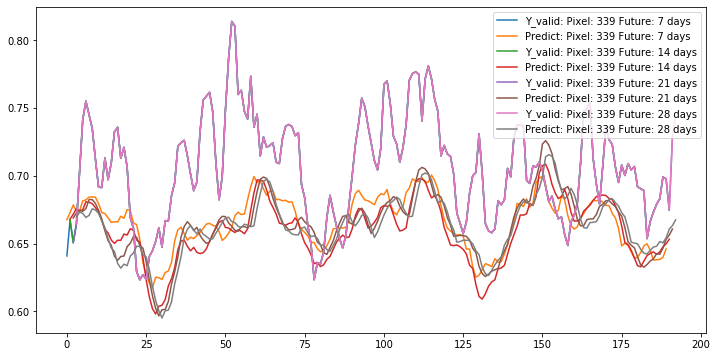

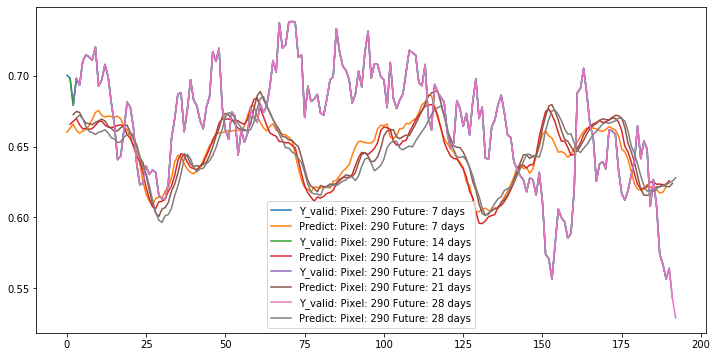

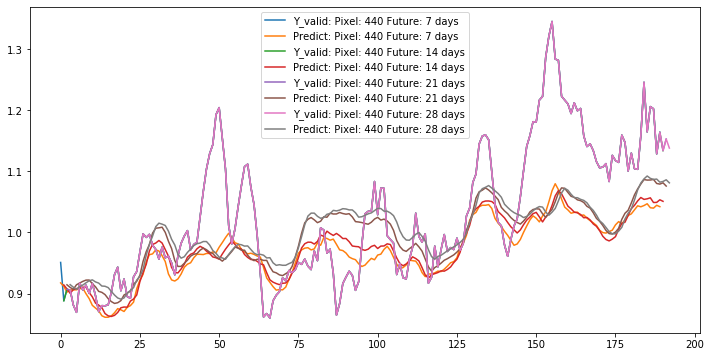

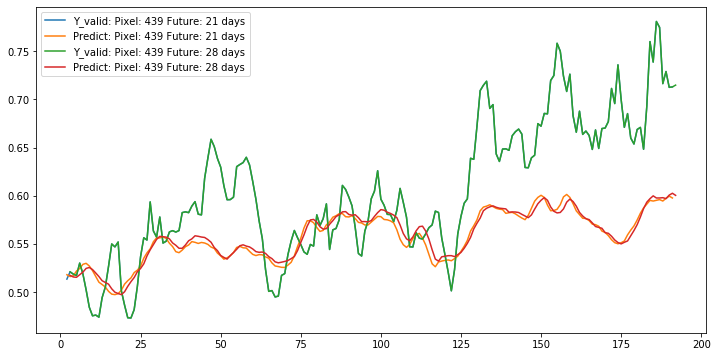

In [91]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10) 

In [92]:
valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0050 - mae: 0.0050
valid_accuracy_MAE=0.0050443173, valid_loss=0.005044317005300208
190/190 - 0s - loss: 0.0082 - mae: 0.0082
test_accuracy_MAE=0.008236961, test_loss=0.008236960939278727


#### Attend to cell_unit x CNN vector out

In [175]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100 #32#100
filters = 100
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("X[:,:,0:1].shape",X[:,:,0:1].shape)

cellList = list()
for cell_unit in range(X.shape[-1]):
    print("cell_unit: ", cell_unit)
    CNN_List = list()
    for ks in [52]: #[2,3,5,7,9,10,12,18,26]: #[20:22]: #varing time period range for CNN filter size
        CNN = Conv1D(filters=filters, kernel_size=ks,padding='same', activation='relu')(X[:,:,cell_unit:cell_unit+1]) #for each LSTM unit
        print("CNN.shape", CNN.shape)
        #CNN = Reshape((CNN.shape[-1],1))(CNN)
        CNN = Permute([2,1])(CNN)
        print("CNN.shape", CNN.shape)
        #CNN_List.append(CNN)
    #cnnVector = Concatenate(axis=1)(CNN_List)
    #print("cnnVector.shape",cnnVector.shape)
    #cellList.append(cnnVector)
    cellList.append(CNN)
        
HcLayer = tf.stack(cellList, axis=-1)
print("HcLayer.shape",HcLayer.shape)
HcLayer = Permute([3,2,1])(HcLayer)
print("HcLayer.shape",HcLayer.shape)

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(filters, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([HcLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    #e_vals = Dense(1, 
    #               kernel_initializer = 'glorot_uniform', 
    #               activation='linear',  
    #               name=f'attention_Q_dense_'+str(t))(scoringfunc)
    #print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(scoringfunc)
    print("alphas",alphas.shape)
    alphas = Reshape((int(alphas.shape[1]*alphas.shape[2]),1))(alphas)
    print("alphas",alphas.shape)
    HcLayerFlat = Reshape((int(HcLayer.shape[1]*HcLayer.shape[2]),HcLayer.shape[3]))(HcLayer)
    print("HcLayer.shape",HcLayer.shape)
    Vt = Dot(axes=1)([alphas, HcLayerFlat])
    print("Vt",Vt.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(Vt))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 100)
X[:,:,0:1].shape (None, 52, 1)
cell_unit:  0
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  1
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  2
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  3
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  4
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  5
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  6
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  7
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  8
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  9
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  10
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  11
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  12
CNN.shape (None, 52, 100)
CNN.shape (None, 100, 52)
cell_unit:  13
CNN.shape (None, 52, 100)
CNN.shape (None, 100,

#### Sum on 1DCNN out time axis for attention to obtain a single attention for each unit

In [172]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 50 #32#100
filters = 32
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("X[:,:,0:1].shape",X[:,:,0:1].shape)

cellList = list()
for cell_unit in range(X.shape[-1]):
    print("cell_unit: ", cell_unit)
    CNN_List = list()
    #A large filter size of 52 pickled to match window size. 
    #With 32 filters, each filter can specialize in a time period.
    #Padding is set to same to ensure convolution on matching size input and filter
    for ks in [52]: #[2,3,5,7,9,10,12,18,26]: #[20:22]: #varing time period range for CNN filter size
        CNN = Conv1D(filters=filters, kernel_size=ks, padding='same', activation='relu')(X[:,:,cell_unit:cell_unit+1]) #for each LSTM unit
        print("CNN.shape", CNN.shape)
        #CNN = Reshape((CNN.shape[-1],1))(CNN)
        CNN = Permute([2,1])(CNN)
        print("CNN.shape", CNN.shape)
        #CNN_List.append(CNN)
    #cnnVector = Concatenate(axis=1)(CNN_List)
    #print("cnnVector.shape",cnnVector.shape)
    #cellList.append(cnnVector)
    cellList.append(CNN)
        
HcLayer = tf.stack(cellList, axis=-1)
print("HcLayer.shape",HcLayer.shape)
HcLayer = Permute([3,2,1])(HcLayer)
print("HcLayer.shape",HcLayer.shape)

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(filters, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([HcLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    #the convolved Time dimension is summed to collase down to calculate attention to only 
    #vector row or RNN cell unit dimension
    scoringfunc = Lambda(lambda x: K.sum(x,axis=2))(scoringfunc)
    print("scoringfunc.shape",scoringfunc.shape)
    #e_vals = Dense(1, 
    #               kernel_initializer = 'glorot_uniform', 
    #               activation='linear',  
    #               name=f'attention_Q_dense_'+str(t))(scoringfunc)
    #print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(scoringfunc)
    print("alphas",alphas.shape)
    alphas = Flatten()(alphas)
    #alphas = Reshape((int(alphas.shape[1]*alphas.shape[2])))(alphas)
    print("alphas",alphas.shape)
    #HcLayerFlat = Reshape((int(HcLayer.shape[1]*HcLayer.shape[2]),HcLayer.shape[3]))(HcLayer)
    #print("HcLayer.shape",HcLayer.shape)
    Vt = Dot(axes=1)([alphas, HcLayer])
    print("Vt",Vt.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(Vt))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 50)
X[:,:,0:1].shape (None, 52, 1)
cell_unit:  0
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  1
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  2
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  3
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  4
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  5
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  6
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  7
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  8
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  9
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  10
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  11
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  12
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  13
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  14
CNN.shape

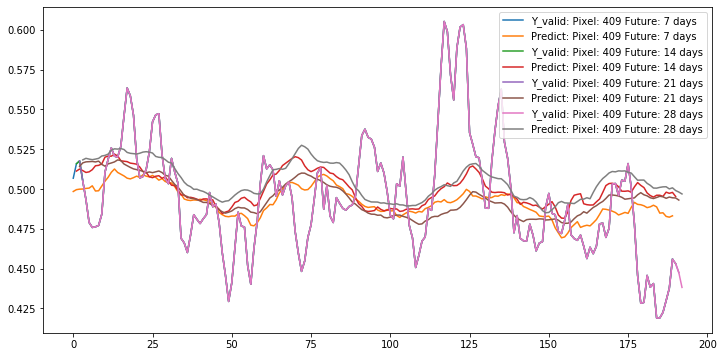

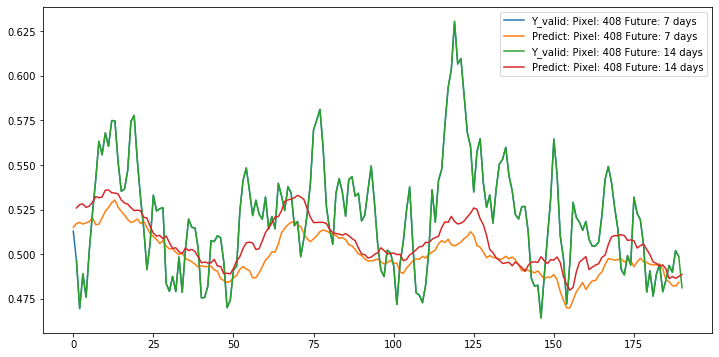

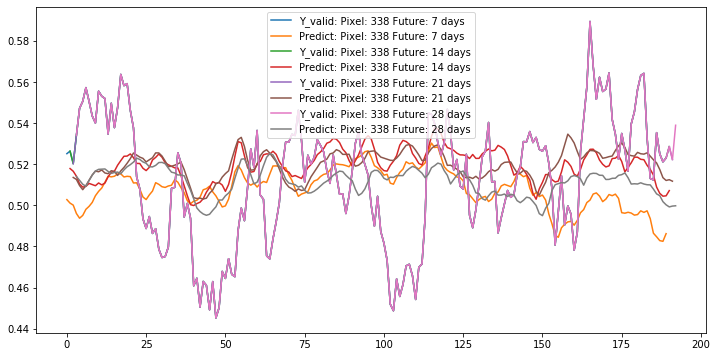

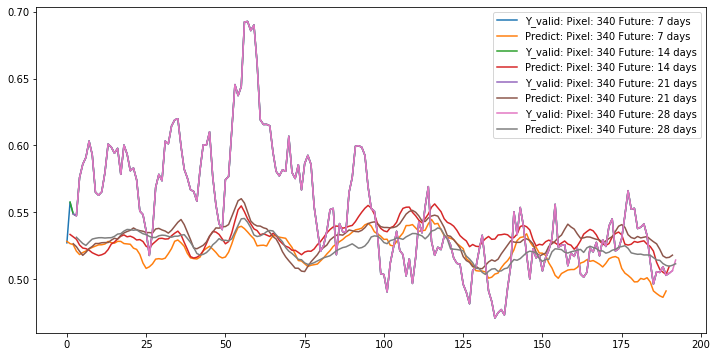

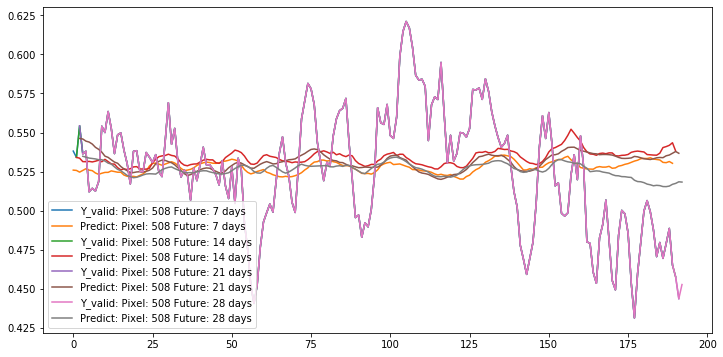

...

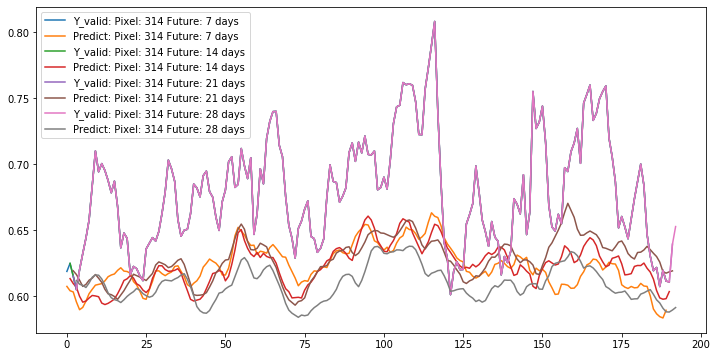

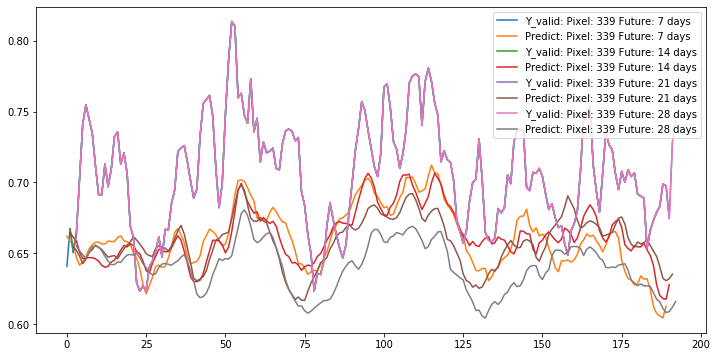

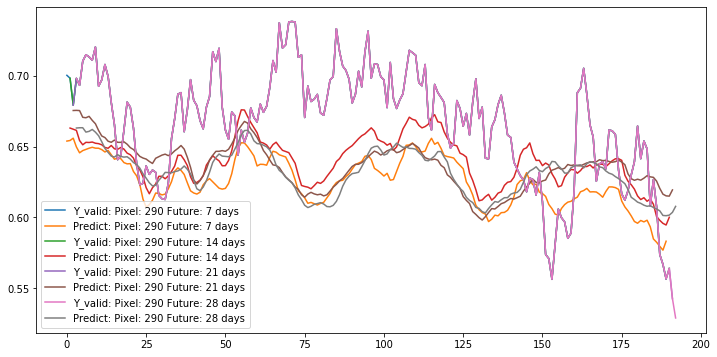

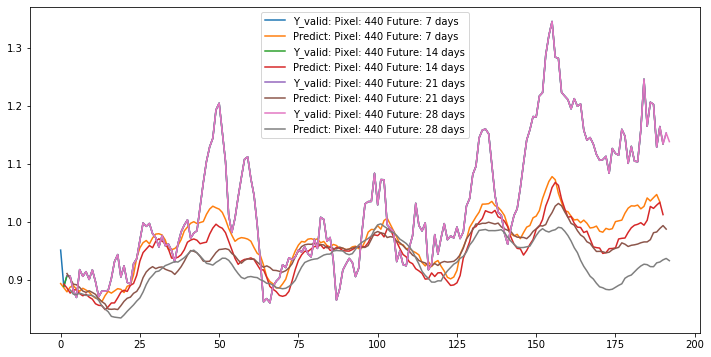

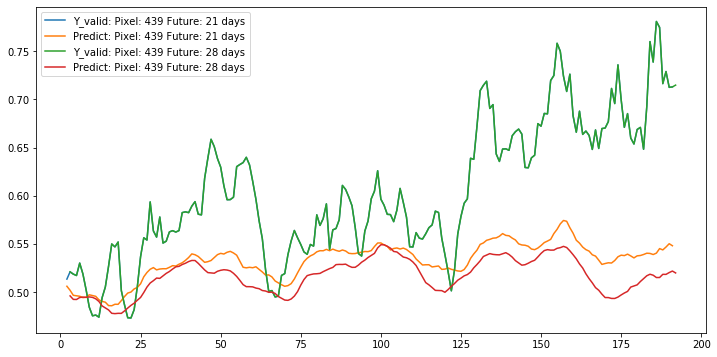

In [151]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10) 

In [152]:
valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0051 - mae: 0.0051
valid_accuracy_MAE=0.0051454213, valid_loss=0.005145421138915577
190/190 - 0s - loss: 0.0083 - mae: 0.0083
test_accuracy_MAE=0.008264679, test_loss=0.008264679677392308


In [181]:
lr = .001
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 50 #32#100
filters = 32
X = LSTM(units,return_sequences=True)(TimeDist)
#X = LSTM(units,return_sequences=True)(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("X[:,:,0:1].shape",X[:,:,0:1].shape)

cellList = list()
for cell_unit in range(X.shape[-1]):
    print("cell_unit: ", cell_unit)
    CNN_List = list()
    #A large filter size of 52 pickled to match window size. 
    #With 32 filters, each filter can specialize in a time period.
    #Padding is set to same to ensure convolution on matching size input and filter
    for ks in [52]: #[2,3,5,7,9,10,12,18,26]: #[20:22]: #varing time period range for CNN filter size
        CNN = Conv1D(filters=filters, kernel_size=ks, padding='same', activation='relu')(X[:,:,cell_unit:cell_unit+1]) #for each LSTM unit
        print("CNN.shape", CNN.shape)
        #CNN = Reshape((CNN.shape[-1],1))(CNN)
        CNN = Permute([2,1])(CNN)
        print("CNN.shape", CNN.shape)
        #CNN_List.append(CNN)
    #cnnVector = Concatenate(axis=1)(CNN_List)
    #print("cnnVector.shape",cnnVector.shape)
    #cellList.append(cnnVector)
    cellList.append(CNN)
        
HcLayer = tf.stack(cellList, axis=-1)
print("HcLayer.shape",HcLayer.shape)
HcLayer = Permute([3,2,1])(HcLayer)
print("HcLayer.shape",HcLayer.shape)

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(filters, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X[:,-1,:]) #Wa*ht
    print("joined.shape",joined.shape)
    joined = Reshape((1,joined.shape[-1]))(joined)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([HcLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    #the convolved Time dimension is summed to collase down to calculate attention to only 
    #vector row or RNN cell unit dimension
    scoringfunc = Lambda(lambda x: K.sum(x,axis=2))(scoringfunc)
    print("scoringfunc.shape",scoringfunc.shape)
    #e_vals = Dense(1, 
    #               kernel_initializer = 'glorot_uniform', 
    #               activation='linear',  
    #               name=f'attention_Q_dense_'+str(t))(scoringfunc)
    #print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_sigmoid_'+str(t))(scoringfunc)
    print("alphas",alphas.shape)
    alphas = Flatten()(alphas)
    #alphas = Reshape((int(alphas.shape[1]*alphas.shape[2])))(alphas)
    print("alphas",alphas.shape)
    #HcLayerFlat = Reshape((int(HcLayer.shape[1]*HcLayer.shape[2]),HcLayer.shape[3]))(HcLayer)
    #print("HcLayer.shape",HcLayer.shape)
    Vt = Dot(axes=1)([alphas, HcLayer])
    print("Vt",Vt.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='relu', name='dense_Vt_'+str(t))(Vt))
        out2 = Dense(units,activation='relu', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 50)
X[:,:,0:1].shape (None, 52, 1)
cell_unit:  0
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  1
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  2
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  3
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  4
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  5
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  6
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  7
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  8
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  9
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  10
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  11
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  12
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  13
CNN.shape (None, 52, 32)
CNN.shape (None, 32, 52)
cell_unit:  14
CNN.shape

## ---------------------> Run fit on any of the previous model here <--------------------------

In [36]:
factor = 1
h_start = np.zeros((X_train.shape[0], units*factor))
c_start = np.zeros((X_train.shape[0], units*factor))
h_startv = np.zeros((X_valid.shape[0], units*factor))
c_startv = np.zeros((X_valid.shape[0], units*factor))
h_startt = np.zeros((X_test.shape[0], units*factor))
c_startt = np.zeros((X_test.shape[0], units*factor))


EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train,h_start, c_start],y=Y_train, 
                             validation_data=([X_valid,h_startv, c_startv], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_train,h_start, c_start], Y_train, verbose=2) # 5/2020 nt: use validation set
print ("train_accuracy_MAE=%s, train_loss=%s" % (valid_acc, valid_loss))

valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "LSTM_ATTENTION_Freq"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed (TimeDistribut (None, 52, 625)      0           input_1[0][0]                    
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 52, 80)       225920      time_distributed[0][0]           
__________________________________________________________________________________________________
reshape (Reshape)               (None, 52, 80)       0           lstm[0][0]                       
________________________________________________________________________________

Epoch 1/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0578 - mae: 0.0578
Epoch 00001: val_loss improved from inf to 0.03117, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-210503_model.hdf5
573/573 [==============================] - 8s 13ms/sample - loss: 0.0560 - mae: 0.0560 - val_loss: 0.0312 - val_mae: 0.0312
Epoch 2/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0168 - mae: 0.0168
Epoch 00002: val_loss improved from 0.03117 to 0.00930, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-210503_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0160 - mae: 0.0160 - val_loss: 0.0093 - val_mae: 0.0093
Epoch 3/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0060 - mae: 0.0060
Epoch 00003: val_loss improved 

Epoch 25/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0048 - mae: 0.0048
Epoch 00025: val_loss did not improve from 0.00701
573/573 [==============================] - 1s 1ms/sample - loss: 0.0048 - mae: 0.0048 - val_loss: 0.0071 - val_mae: 0.0071
Epoch 26/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0048 - mae: 0.0048
Epoch 00026: val_loss did not improve from 0.00701
573/573 [==============================] - 1s 1ms/sample - loss: 0.0048 - mae: 0.0048 - val_loss: 0.0072 - val_mae: 0.0072
Epoch 27/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0048 - mae: 0.0048
Epoch 00027: val_loss did not improve from 0.00701
573/573 [==============================] - 1s 1ms/sample - loss: 0.0048 - mae: 0.0048 - val_loss: 0.0073 - val_mae: 0.0073
Epoch 28/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0048 - mae: 0.0048
Epoch 00028: val_loss did not improve from 0.00701
573/573 [==============================] - 1s 1ms/sampl

Epoch 52/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00052: val_loss improved from 0.00659 to 0.00645, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-210503_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 53/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00053: val_loss improved from 0.00645 to 0.00645, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-210503_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 54/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00054: val_loss imp

573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 78/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00078: val_loss did not improve from 0.00633
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 79/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00079: val_loss did not improve from 0.00633
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 80/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00080: val_loss did not improve from 0.00633
573/573 [==============================] - 1s 1ms/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 81/500
525/573 [==========================>...] - ETA: 0s - loss: 0.00

Epoch 106/500
567/573 [============================>.] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00106: val_loss did not improve from 0.00622
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 107/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00107: val_loss did not improve from 0.00622
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0062 - val_mae: 0.0062
Epoch 108/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00108: val_loss did not improve from 0.00622
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 109/500
567/573 [============================>.] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00109: val_loss did not improve from 0.00622
573/573 [==============================] - 1s 1ms/s

546/573 [===========================>..] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00135: val_loss did not improve from 0.00619
573/573 [==============================] - 1s 996us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0062 - val_mae: 0.0062
Epoch 136/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00136: val_loss did not improve from 0.00619
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 137/500
567/573 [============================>.] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00137: val_loss did not improve from 0.00619
573/573 [==============================] - 1s 987us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 138/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00138: val_loss did not improve from 0.00619
573/573 [==============================] - 1s 979us/sample - 

573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0060 - val_mae: 0.0060
Epoch 163/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00163: val_loss did not improve from 0.00598
573/573 [==============================] - 1s 985us/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0060 - val_mae: 0.0060
Epoch 164/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00164: val_loss improved from 0.00598 to 0.00594, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-210503_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 165/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00165: val_loss did not improve from 0.00594
573/573 [===========

573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0054 - val_mae: 0.0054
Epoch 185/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00185: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 973us/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 186/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00186: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 967us/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 187/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00187: val_loss did not improve from 0.00543
573/573 [==============================] - 1s 987us/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 188/500
546/573 [===========================>..] - ETA: 0s - 

Epoch 210/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00210: val_loss did not improve from 0.00517
573/573 [==============================] - 1s 986us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 211/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00211: val_loss did not improve from 0.00517
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 212/500
567/573 [============================>.] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00212: val_loss did not improve from 0.00517
573/573 [==============================] - 1s 998us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 213/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00213: val_loss did not improve from 0.00517
573/573 [==============================] - 1s 1

Epoch 240/500
567/573 [============================>.] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00240: val_loss did not improve from 0.00512
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 241/500
567/573 [============================>.] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00241: val_loss improved from 0.00512 to 0.00509, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200811-210503_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 242/500
567/573 [============================>.] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00242: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 243/500
546/573 

Epoch 270/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00270: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 271/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00271: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 272/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00272: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 273/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00273: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/s

## ENC_DEC LSTM

In [426]:
test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0081 - mae: 0.0081
test_accuracy_MAE=0.008077838, test_loss=0.008077838918880413


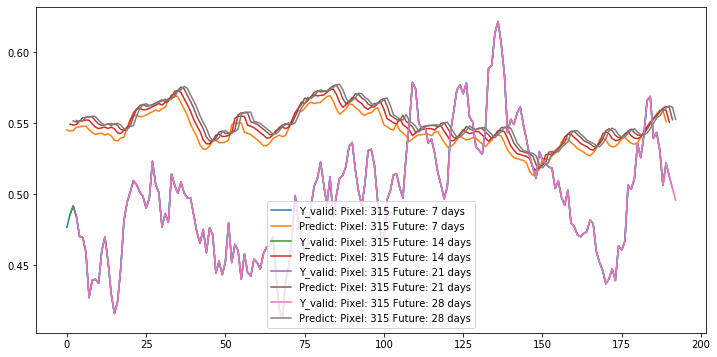

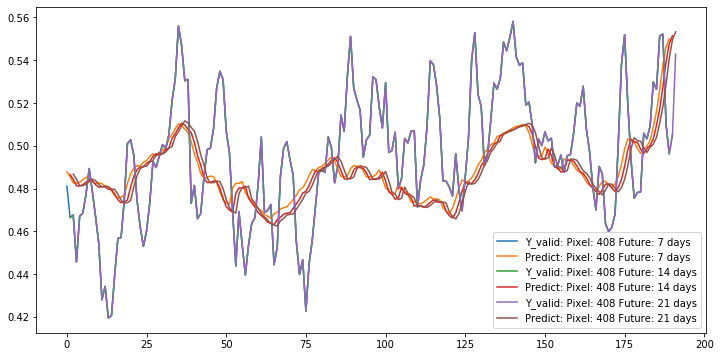

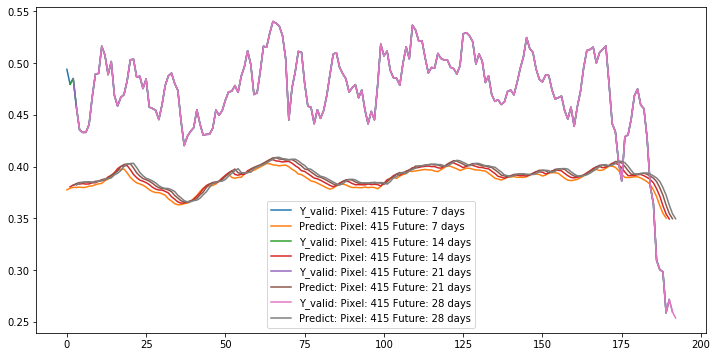

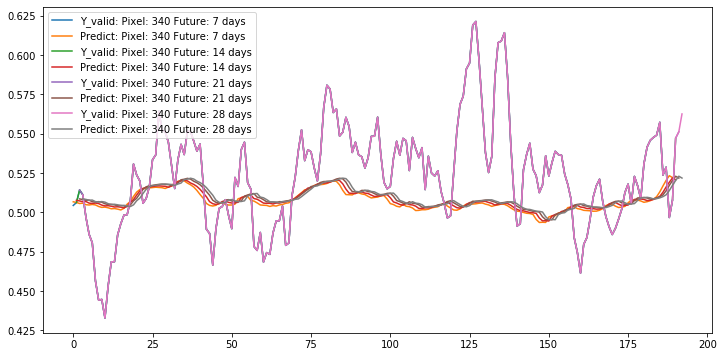

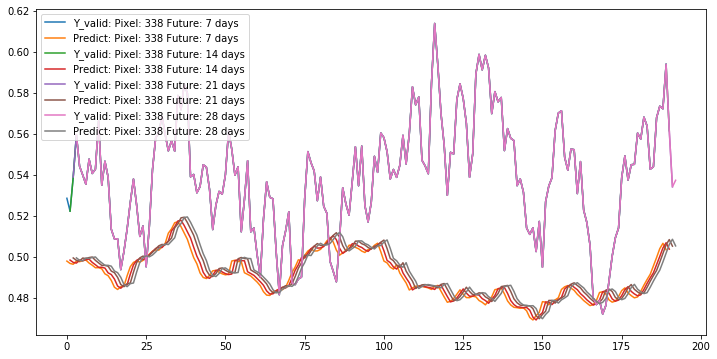

...

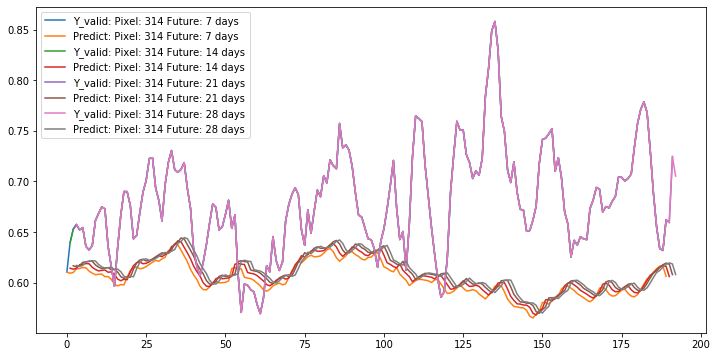

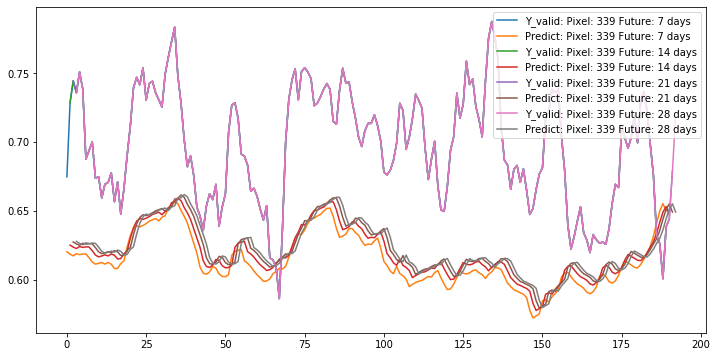

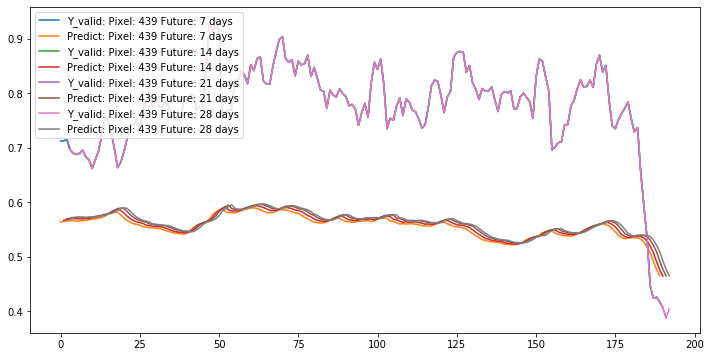

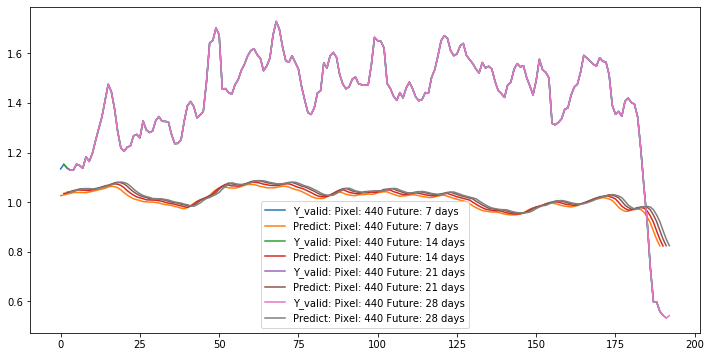

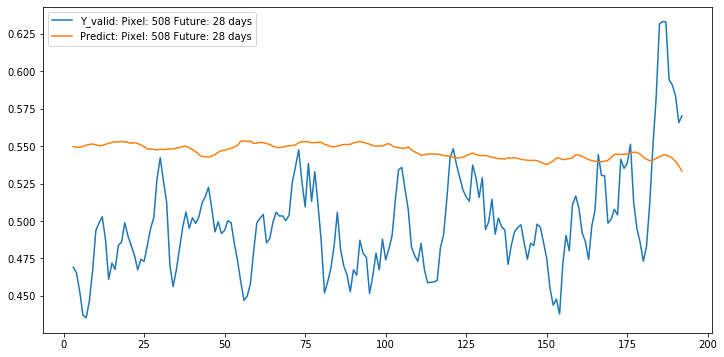

In [427]:
PlotTS([X_test],Y_test,model,top=10) 

## EN_DEC LSTM + Attention on frequency

In [414]:
test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0079 - mae: 0.0079
test_accuracy_MAE=0.007868556, test_loss=0.007868556590064576


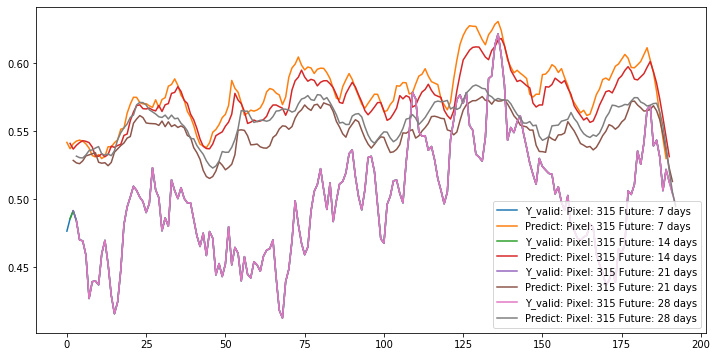

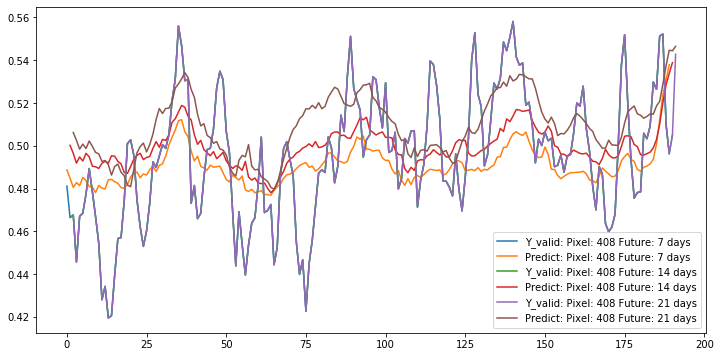

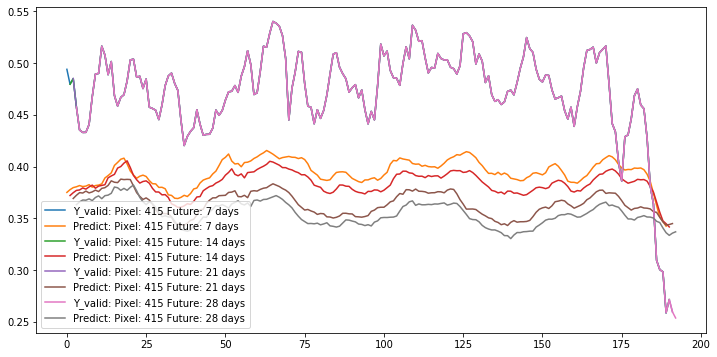

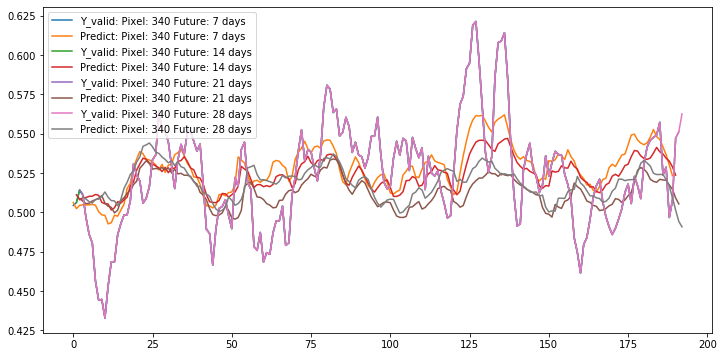

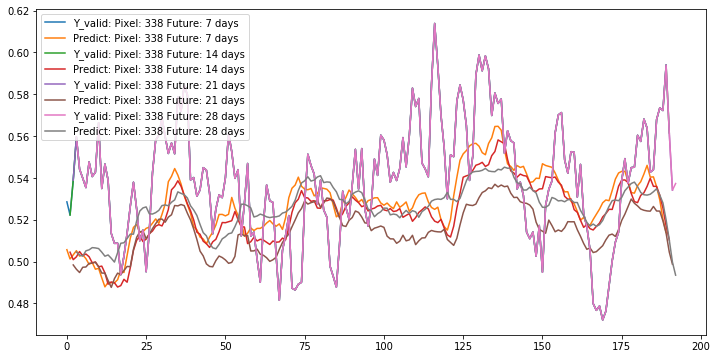

...

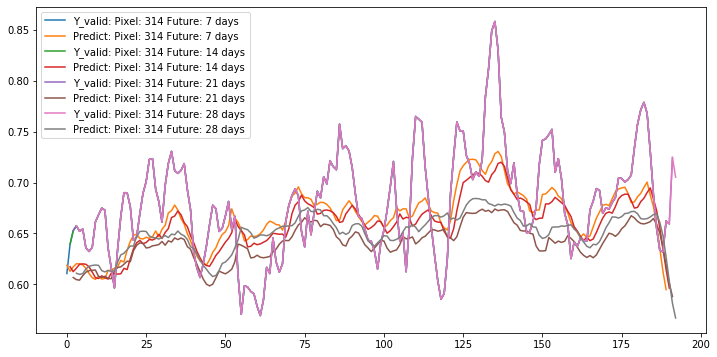

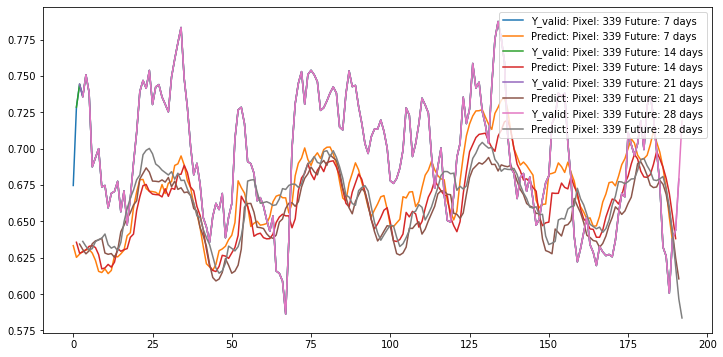

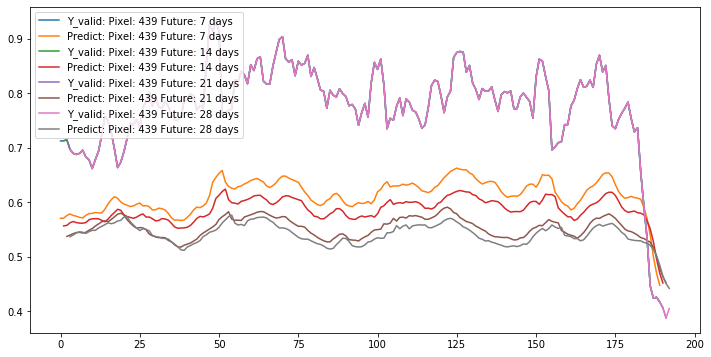

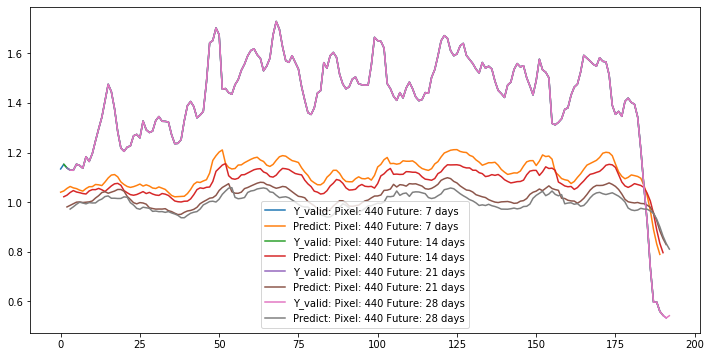

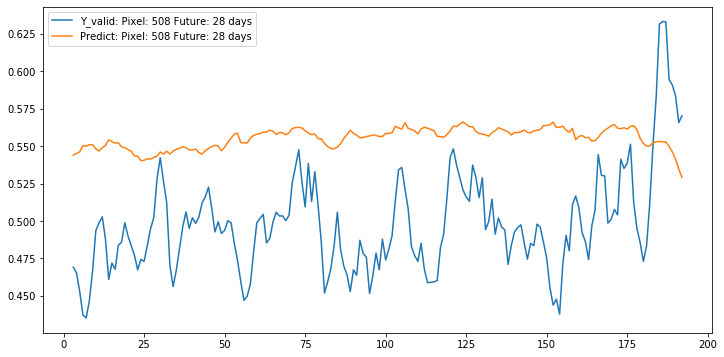

In [415]:
PlotTS([X_test,h_startv, c_startv],Y_test,model,top=10) 

## Validation set result 25x25 pixels

#### Flattened_Fully_Connected: valid_accuracy_MAE=0.0067913793, valid_loss=0.006791379331996304

#### Flattened_LTSM: valid_accuracy_MAE=0.004592653, valid_loss=0.004592652776380952

#### 2DCNN_LTSM: valid_accuracy_MAE=0.0053498237, valid_loss=0.005349824231859121

#### FLATTENED_LTSM_Attention: valid_accuracy_MAE=0.005595601, valid_loss=0.005595600854176345

#### Flattened_Attention_Time: valid_accuracy_MAE=0.0058029336, valid_loss=0.0058029338117708395

#### Attention_FFT: valid_accuracy_MAE=0.0062100464, valid_loss=0.00621004617426798

#### Attention_Time_FFT_STFT: valid_accuracy_MAE=0.0058276486, valid_loss=0.005827648562735132

#### TimeDistributed_attention: valid_accuracy_MAE=0.006259729, valid_loss=0.006259729208044356

#### TimeDistributed_attention1_plus_attention2_on_time: valid_accuracy_MAE=0.006148583, valid_loss=0.006148582597443571

#### 2 headed TimeDistributed_attention1_plus_attention2_on_time: valid_accuracy_MAE=0.0058226553, valid_loss=0.005822655369395985

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
logs_base_dir = "./logs"
os.makedirs(logs_base_dir, exist_ok=True)
%tensorboard --logdir {logs_base_dir}

In [148]:
Predict = model.predict([X_valid,h_startv, c_startv])

In [149]:
def reshapePred(Predict, fromLast=1):
    return np.rot90(Predict[-1*fromLast].reshape(int(Predict[-1*fromLast].shape[0]**(1/2)),int(Predict[-1*fromLast].shape[0]**(1/2))))

In [150]:
vmax, vmin = np.max(Predict),np.min(Predict)
vmax, vmin

(0.9415091, -0.004546633)

In [151]:
dvmax, dvmin = np.max(np.abs(Predict-Y_valid)),np.min(np.abs(Predict-Y_valid))
dvmax, dvmin

(0.46981318369517644, 1.1932570487260818e-08)

In [152]:
diff_max,diff_min = (dvmax , dvmin ) 
def scaleDiff(diff,diff_max,diff_min):
    return (diff - diff_min)/(diff_max - diff_min)

#### We chart autocorrelation

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

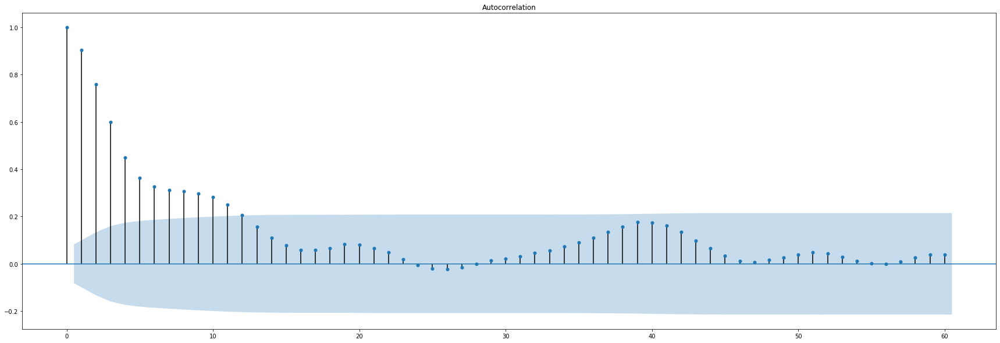

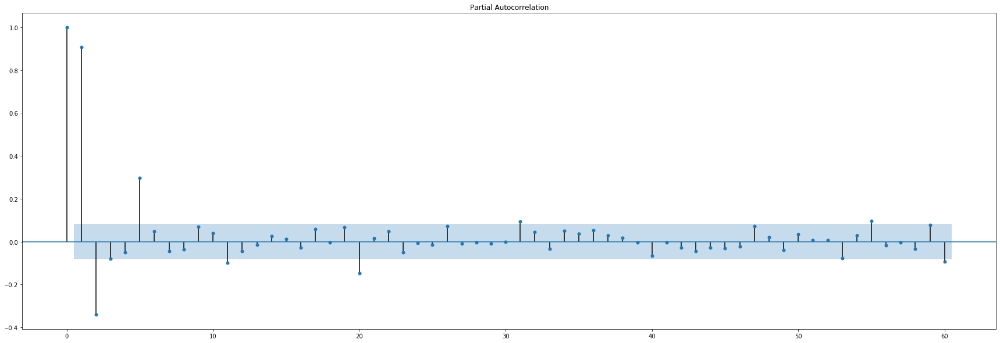

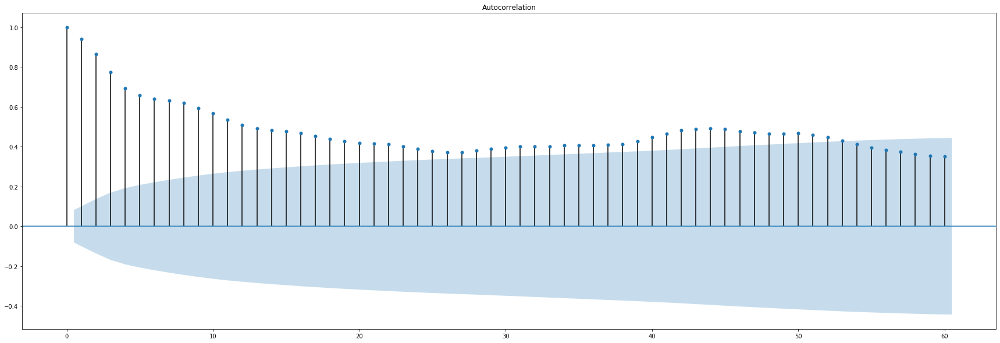

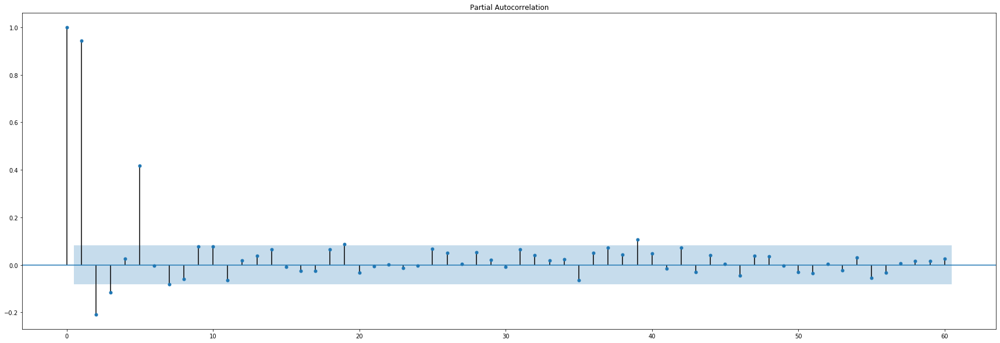

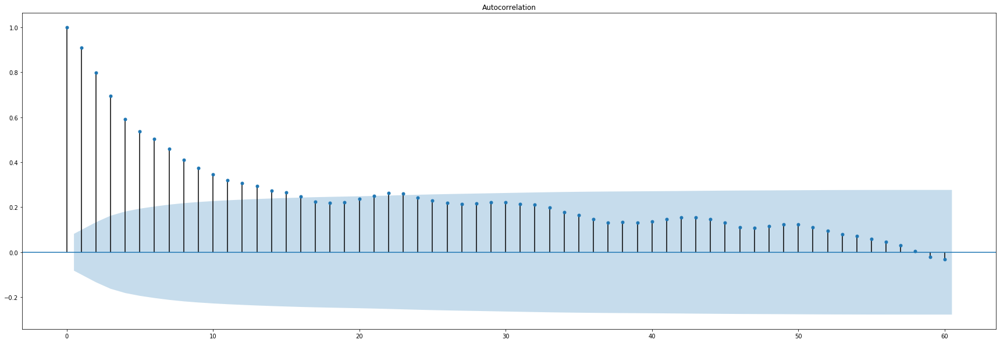

...

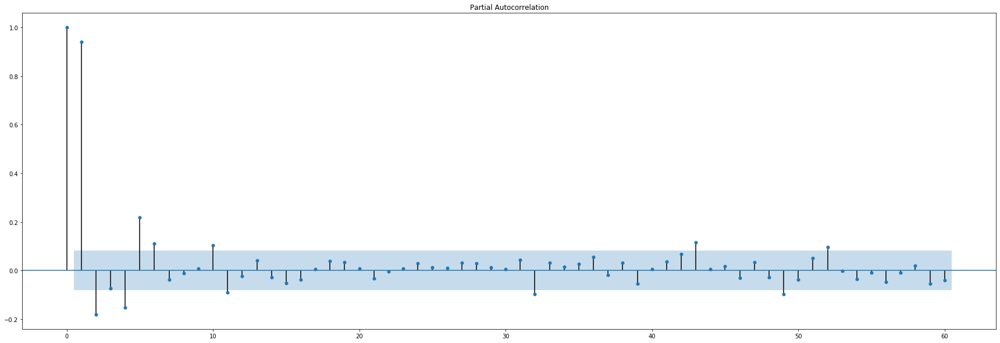

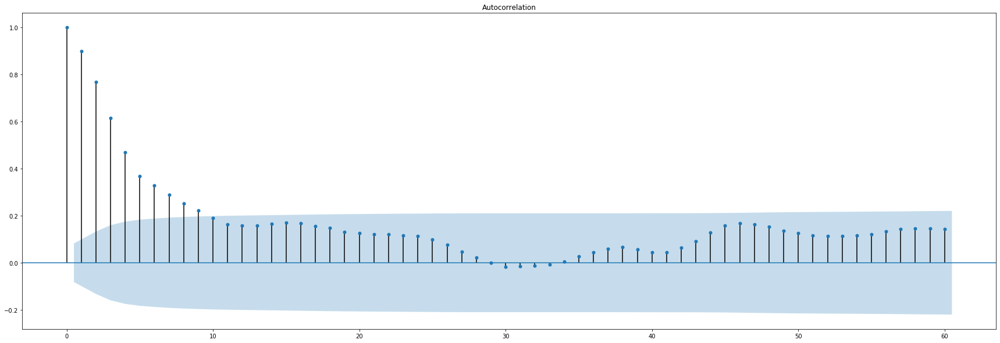

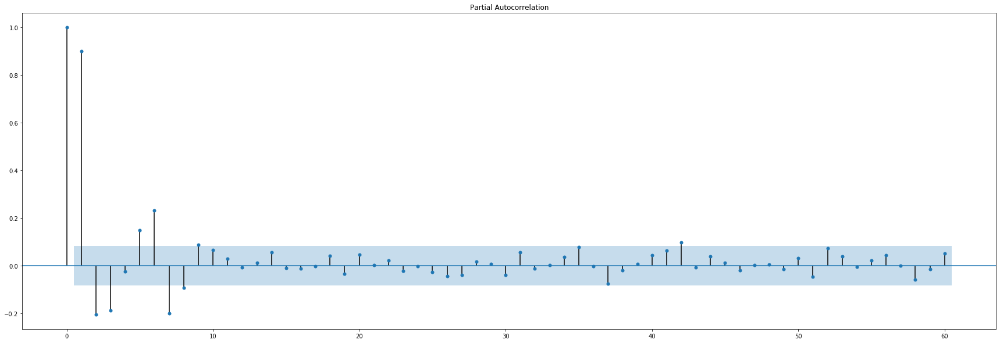

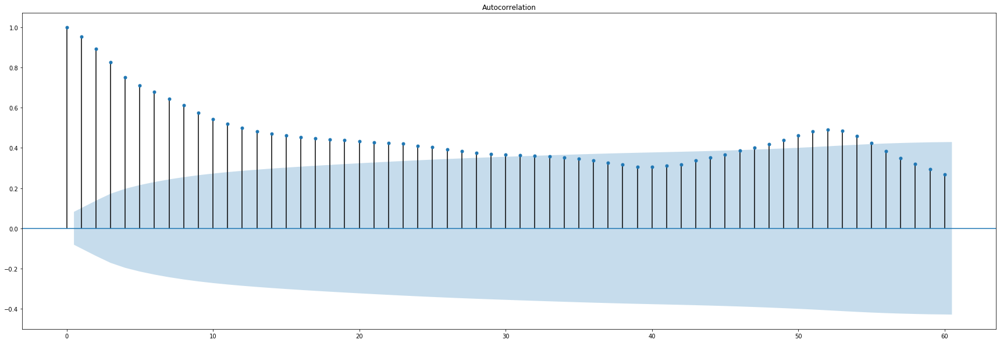

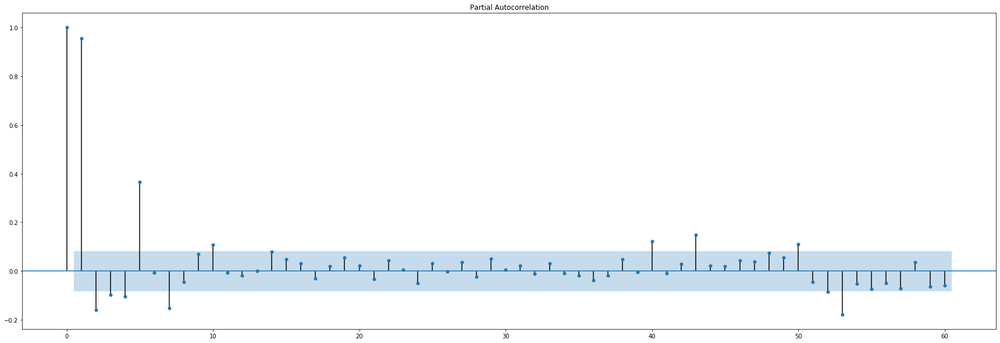

In [52]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
import matplotlib as mpl

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        series = pd.DataFrame(np.transpose(np.vstack([Y_train[:,ts,i]])),columns=["Y_train"])
        with mpl.rc_context():
            mpl.rc("figure", figsize=(30,10))
            plot_acf(series,lags=60)
            plot_pacf(series,lags=60)

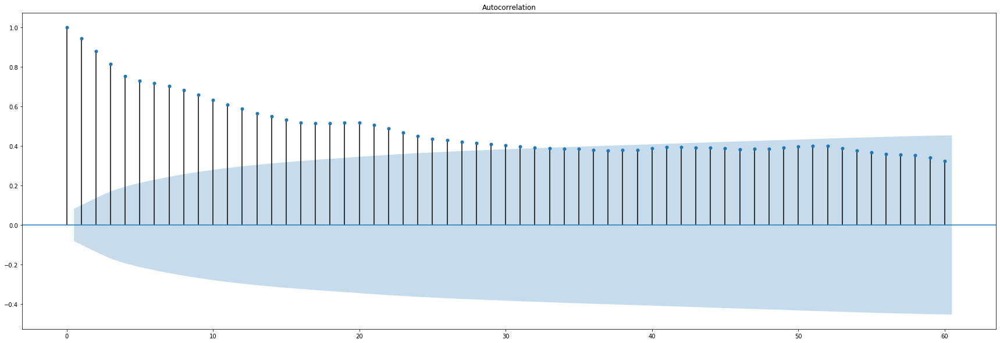

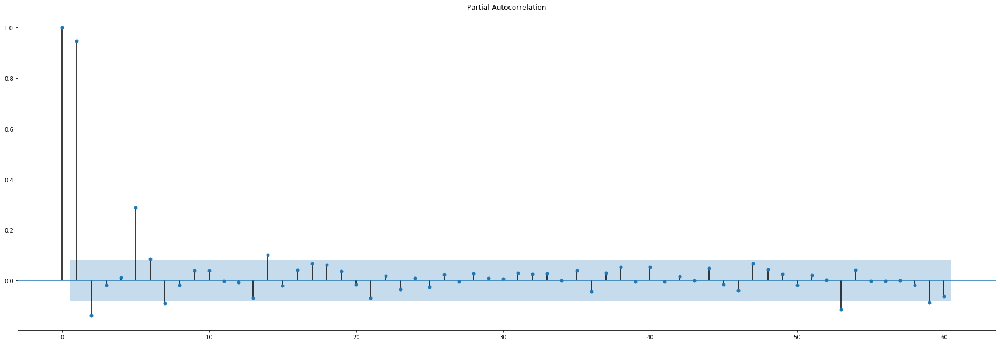

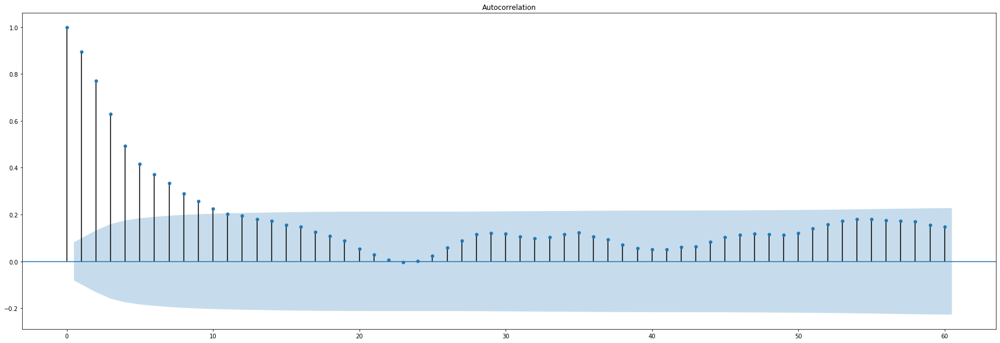

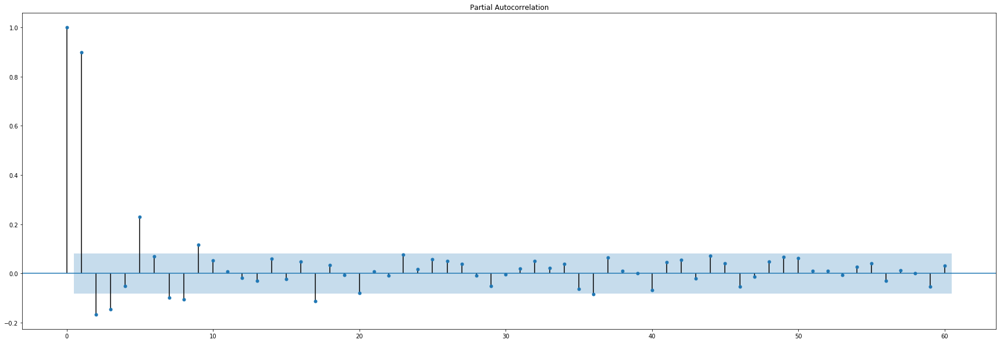

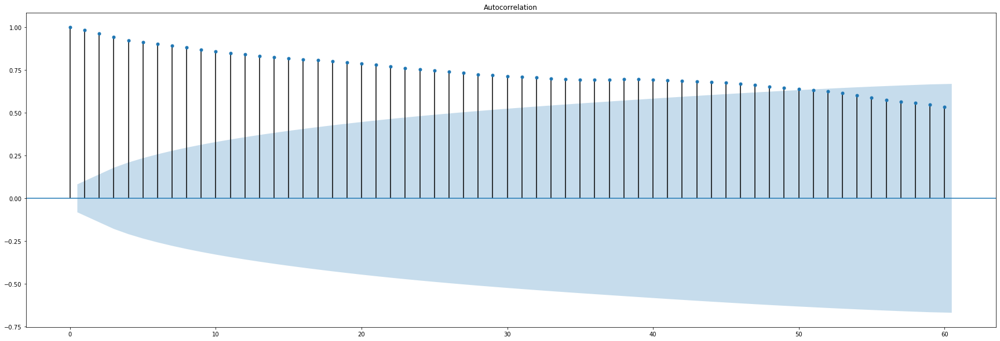

...

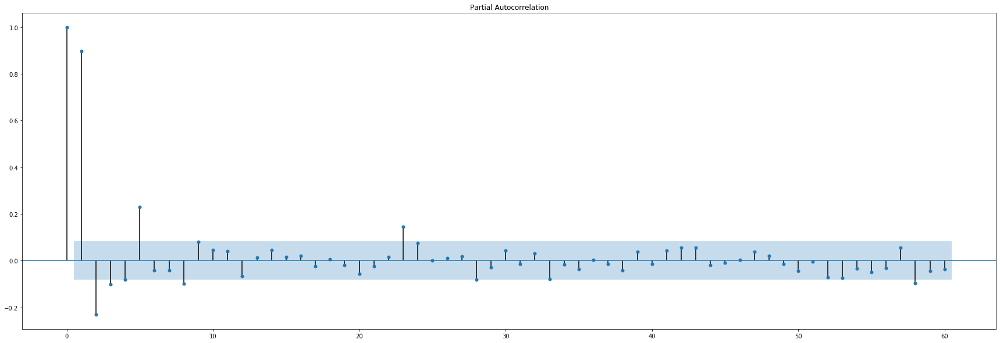

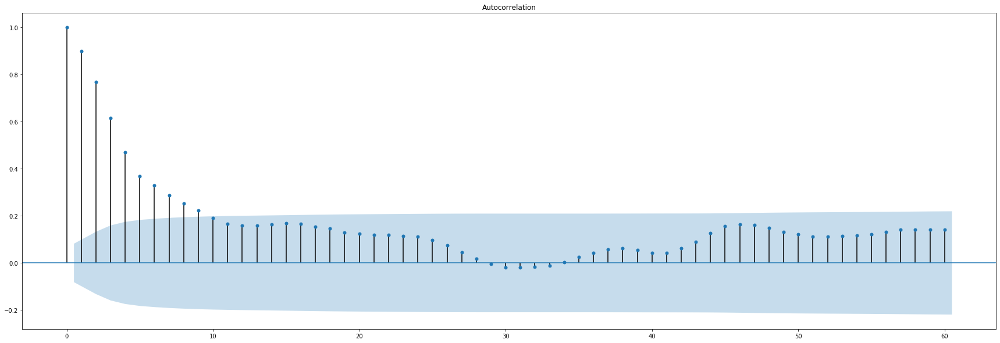

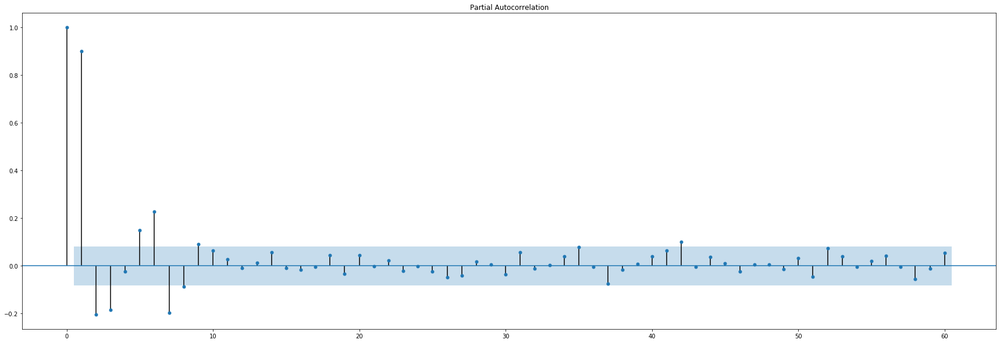

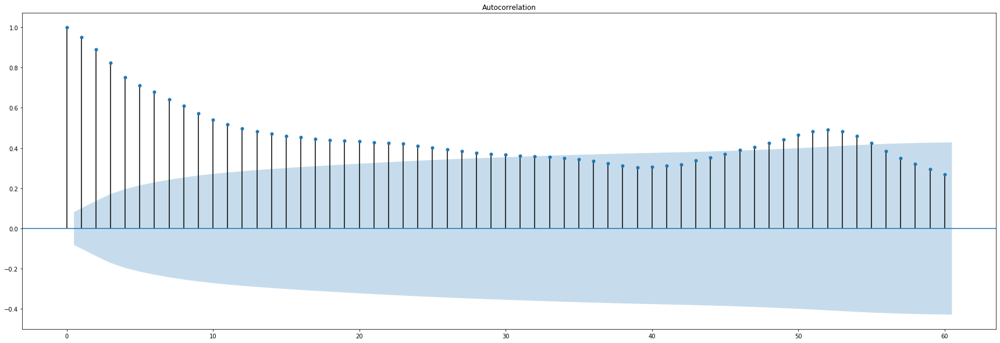

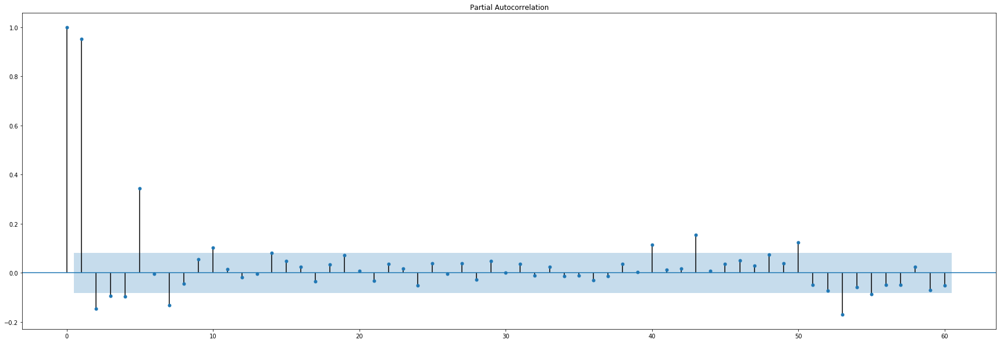

In [153]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
import matplotlib as mpl

for i in np.argsort(Y_train)[:,-10:][0]:
    series = pd.DataFrame(np.transpose(np.vstack([Y_train[:,i]])),columns=["Y_train"])
    with mpl.rc_context():
        mpl.rc("figure", figsize=(30,10))
        plot_acf(series,lags=60)
        plot_pacf(series,lags=60)

#### Benchmark prediction

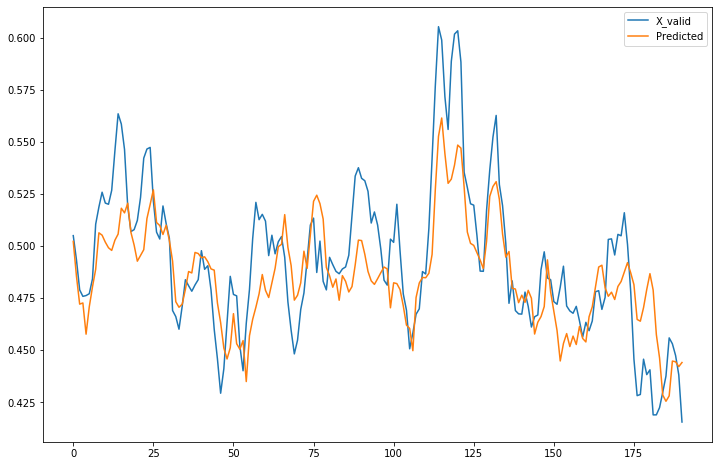

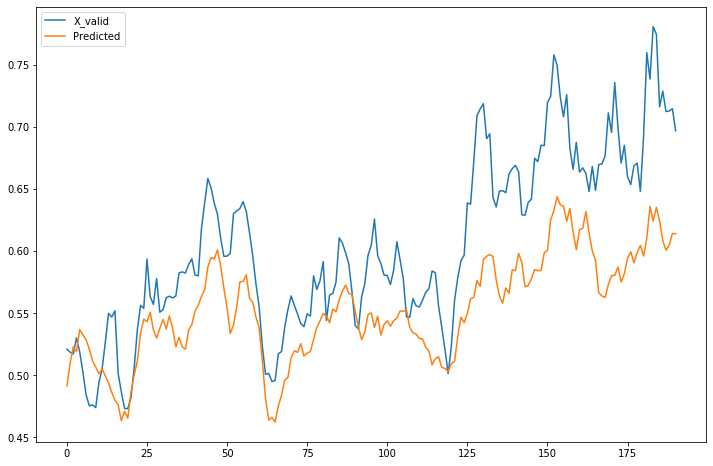

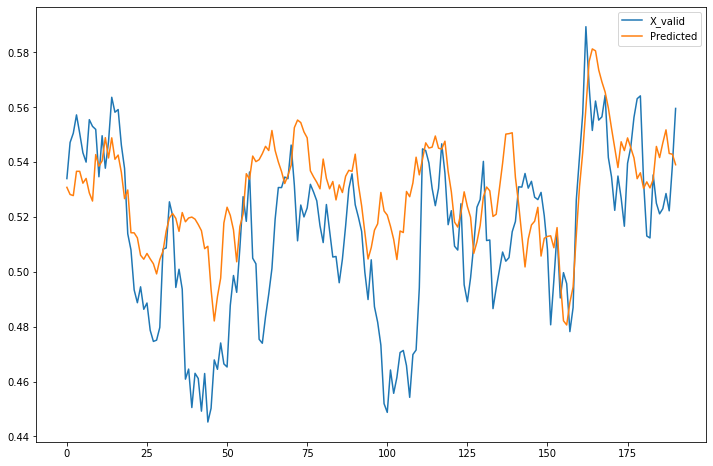

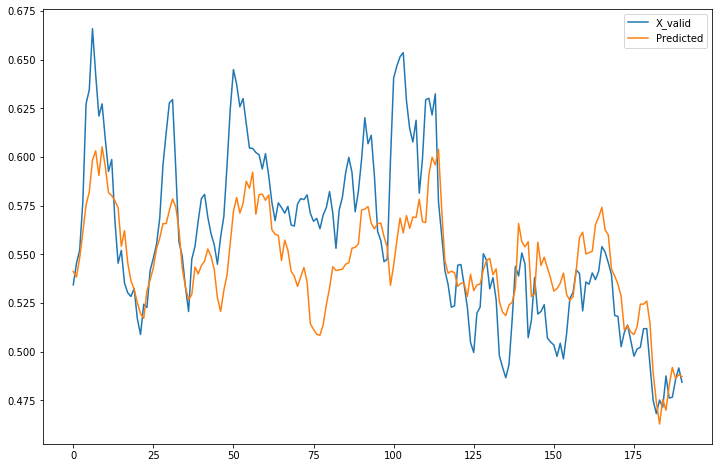

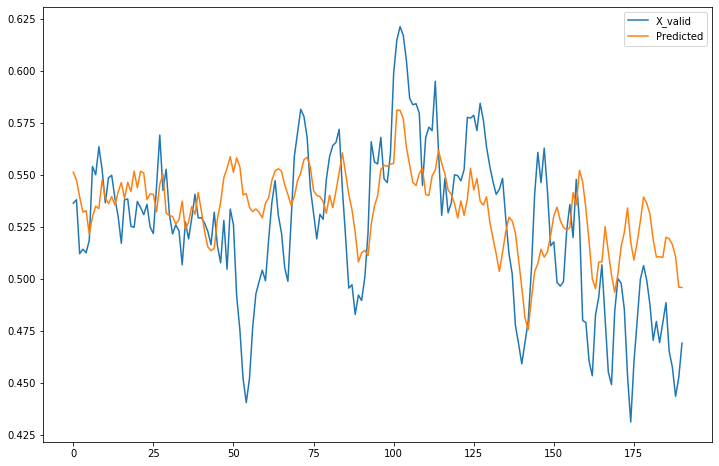

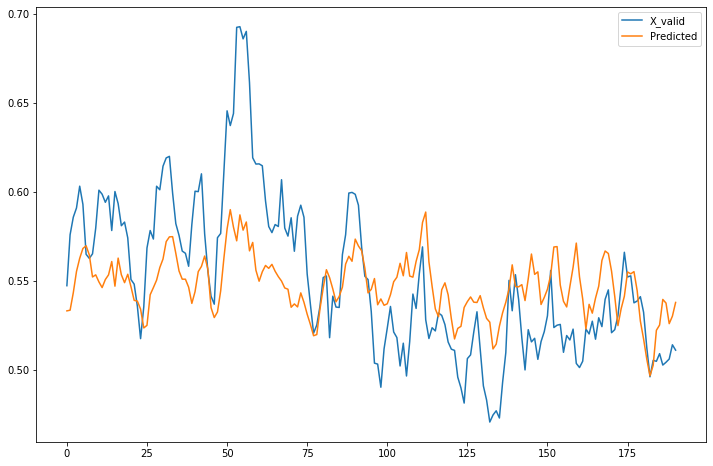

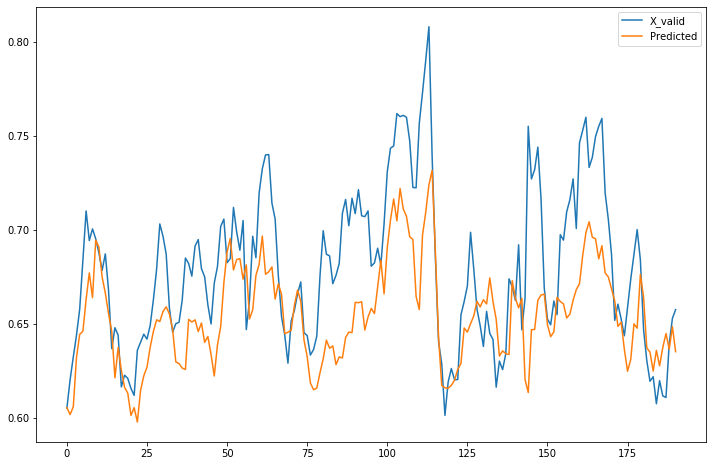

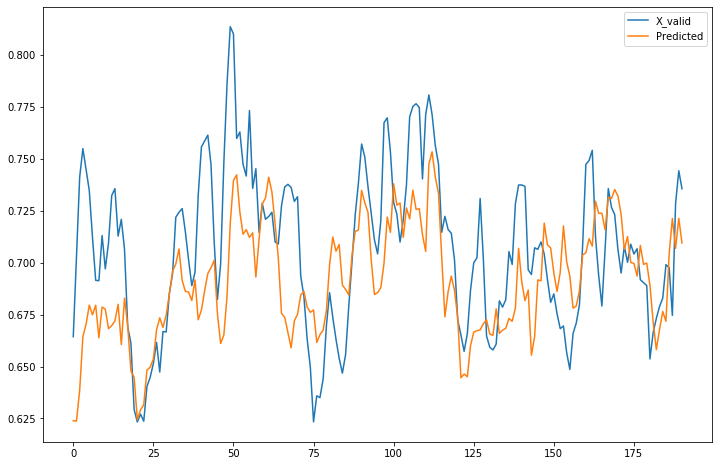

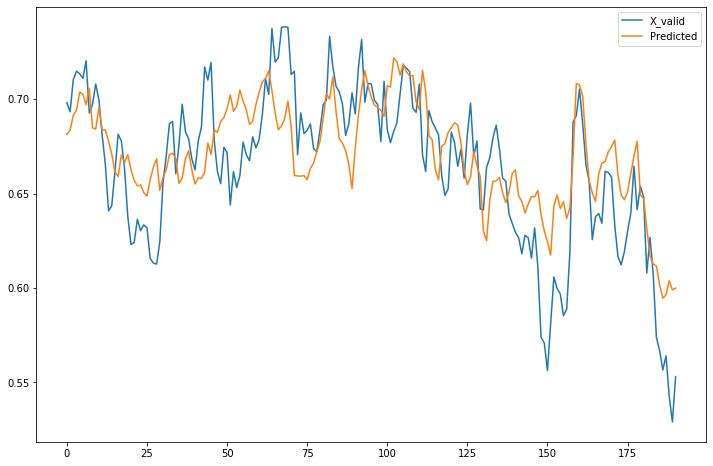

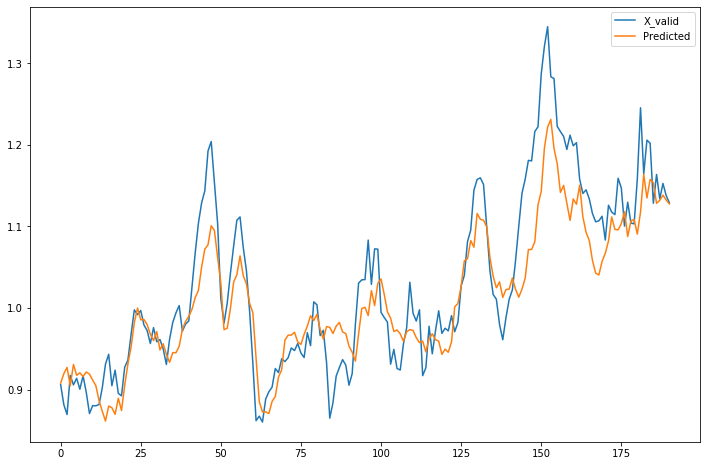

In [252]:
Predict = model.predict([X_valid,h_startv, c_startv])
for i in np.argsort(Y_valid)[:,-10:][0]:
    pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i],Predict[:,i]])),columns=["X_valid","Predicted"]).plot(figsize=(12,8))

#### ENC_LSTM LSTM Attention

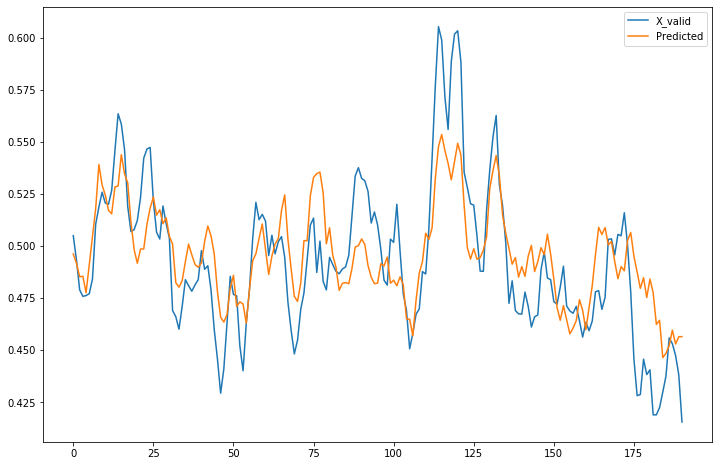

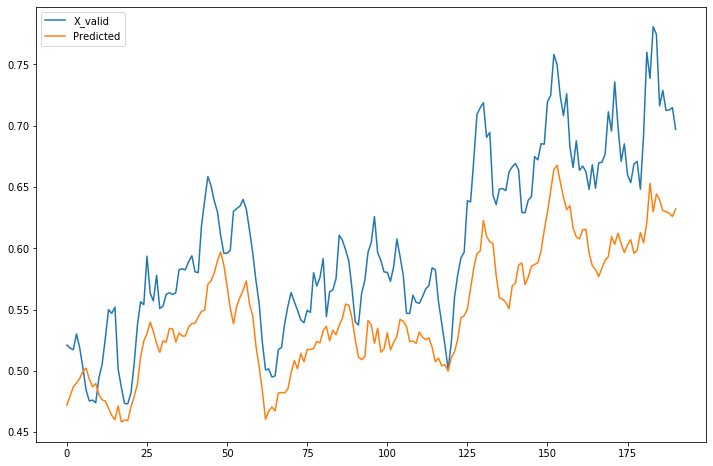

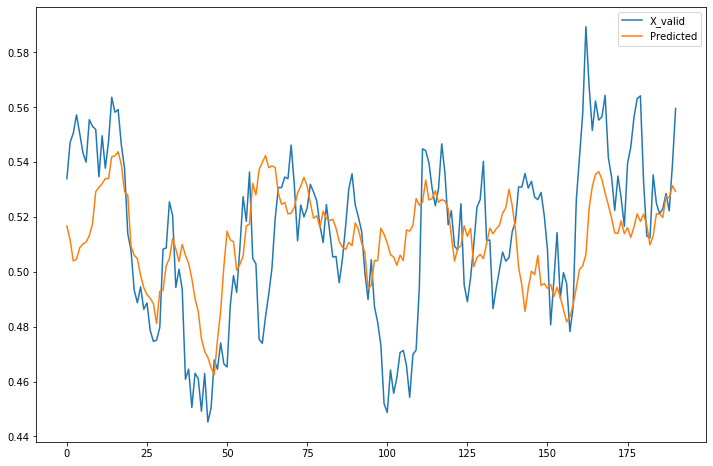

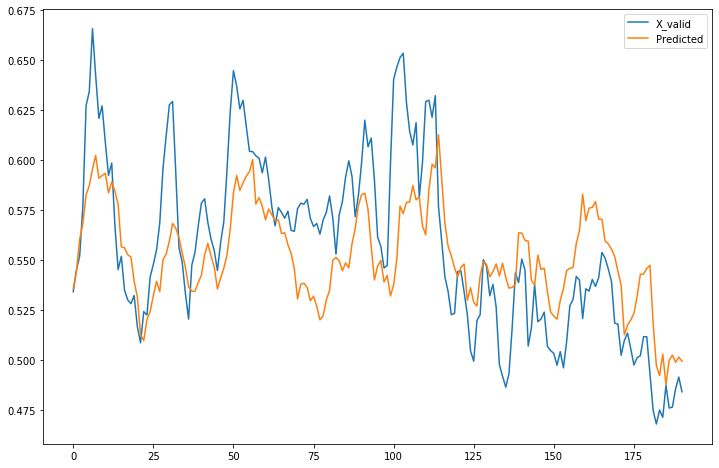

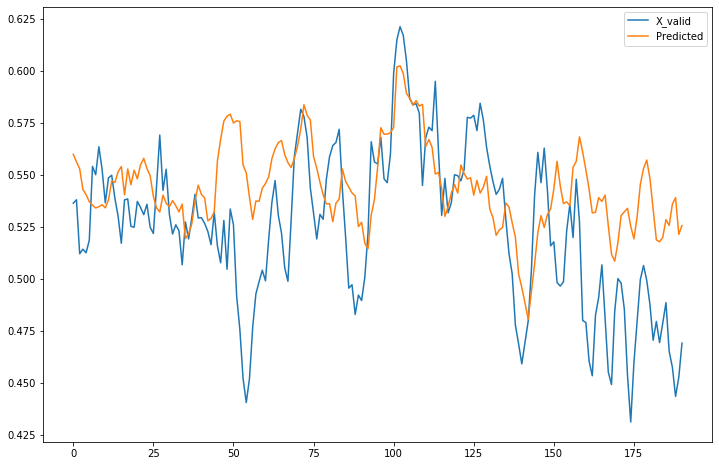

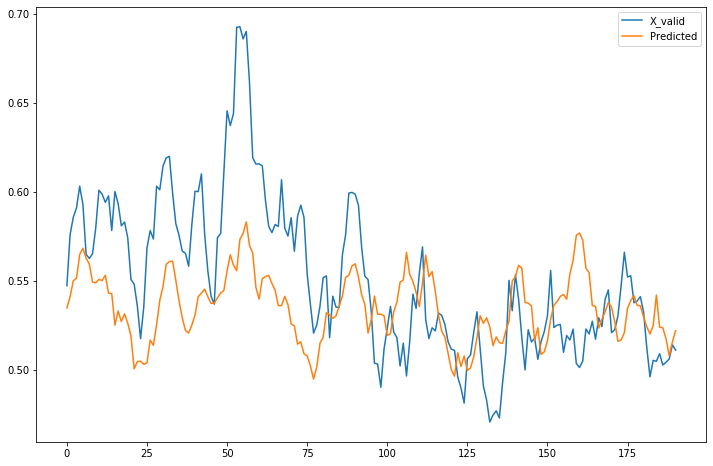

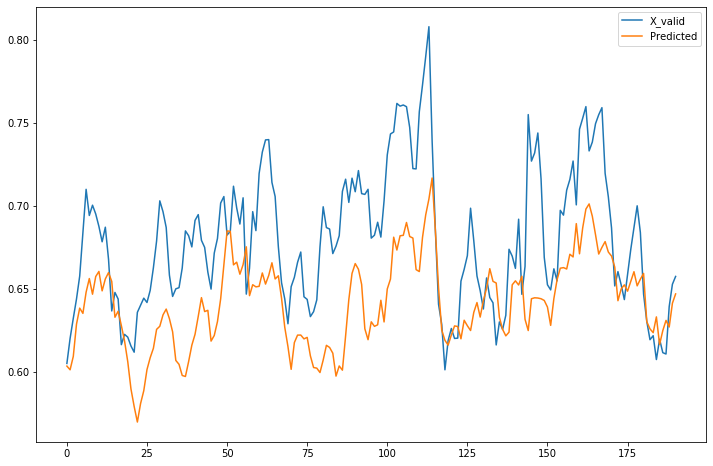

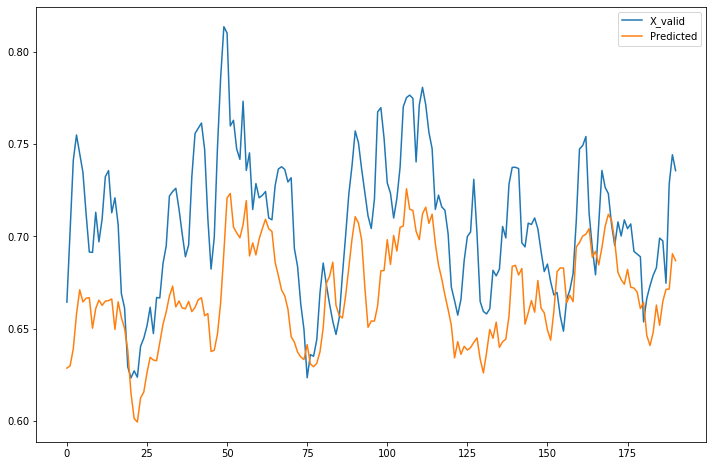

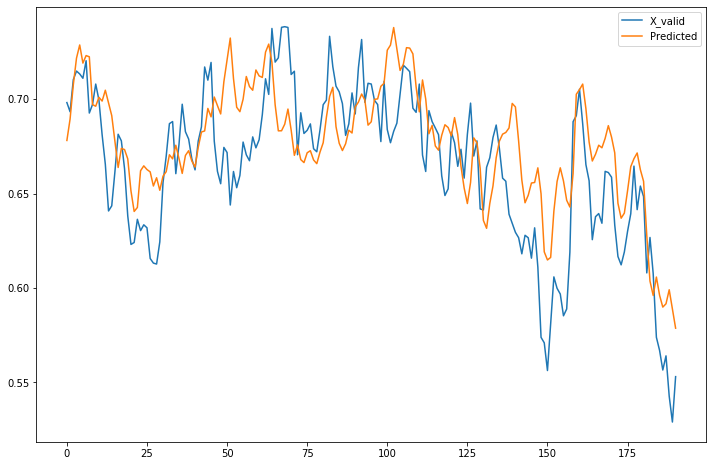

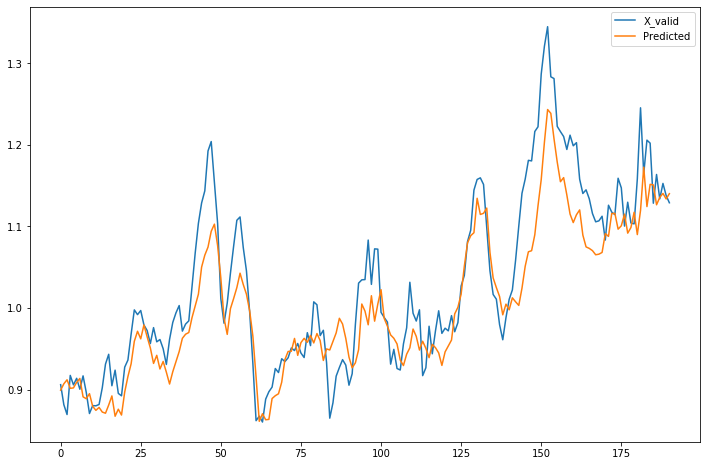

In [325]:
Predict = model.predict([X_valid,h_startv, c_startv])
for i in np.argsort(Y_valid)[:,-10:][0]:
    pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i],Predict[:,i]])),columns=["X_valid","Predicted"]).plot(figsize=(12,8))

In [ ]:
import matplotlib.pyplot as plt
grid_size = 500
density_matrix_t_series = []
# Define the borders
x = [-87.9361,-87.5245]
y = [41.6447,42.023]
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
xmin = min(x) - deltaX
xmax = max(x) + deltaX
ymin = min(y) - deltaY
ymax = max(y) + deltaY

for timeStepFromLast in range(Y_valid.shape[0]):
    plt.figure(figsize=(18, 14))
    plt.title('Predicted')
    plt.imshow( X=reshapePred(Predict,timeStepFromLast),vmax=vmax,vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()
    
    plt.figure(figsize=(18, 14))
    plt.title('Actual')
    plt.imshow( X=reshapePred(Y_valid,timeStepFromLast ),vmax=vmax,vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()
    
    diff = np.abs(reshapePred(Predict,timeStepFromLast)-reshapePred(Y_valid,timeStepFromLast ))
    plt.figure(figsize=(18, 14))
    plt.title('diff')
    plt.imshow( X=scaleDiff(diff,diff_max,diff_min),vmax=1,vmin=0, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()

#### We plot the single pixel with the most dense in crime KDE

In [282]:
Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]

array([-9.01753809e-04,  1.18319356e-02,  6.39541418e-03, -1.00963813e-03,
        2.21520226e-02,  9.82203294e-03,  8.98862978e-04, -1.40180189e-02,
       -2.85536782e-02, -1.55400392e-02,  2.49836335e-03, -6.25528683e-03,
        6.57367428e-03,  1.52411820e-02, -4.17035312e-03, -3.49904935e-03,
        1.69208642e-02, -6.37871144e-03,  3.80110476e-03,  3.35229609e-02,
        6.12156350e-03,  4.98861189e-04,  3.92699759e-03, -6.97102683e-03,
       -8.97786049e-03,  1.45726198e-02,  3.08736283e-03, -5.16823240e-03,
        4.67295254e-03, -1.55889985e-02, -1.86007998e-02, -5.75143199e-03,
       -4.28169510e-03,  5.93364074e-03,  7.45896358e-03, -3.70727537e-04,
        1.66578132e-02, -1.82307174e-02,  1.18449802e-03,  6.59418153e-03,
       -1.84222292e-02, -1.27048644e-02,  9.62644994e-03, -7.42424322e-03,
        6.96875199e-03,  2.01487532e-02,  3.60732578e-03,  2.75561154e-03,
       -5.55466216e-03, -1.54981214e-02, -1.23346509e-02,  3.42596063e-03,
        1.33056411e-02, -

In [283]:
[Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]
 ,Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]]

[array([-9.01753809e-04,  1.18319356e-02,  6.39541418e-03, -1.00963813e-03,
         2.21520226e-02,  9.82203294e-03,  8.98862978e-04, -1.40180189e-02,
        -2.85536782e-02, -1.55400392e-02,  2.49836335e-03, -6.25528683e-03,
         6.57367428e-03,  1.52411820e-02, -4.17035312e-03, -3.49904935e-03,
         1.69208642e-02, -6.37871144e-03,  3.80110476e-03,  3.35229609e-02,
         6.12156350e-03,  4.98861189e-04,  3.92699759e-03, -6.97102683e-03,
        -8.97786049e-03,  1.45726198e-02,  3.08736283e-03, -5.16823240e-03,
         4.67295254e-03, -1.55889985e-02, -1.86007998e-02, -5.75143199e-03,
        -4.28169510e-03,  5.93364074e-03,  7.45896358e-03, -3.70727537e-04,
         1.66578132e-02, -1.82307174e-02,  1.18449802e-03,  6.59418153e-03,
        -1.84222292e-02, -1.27048644e-02,  9.62644994e-03, -7.42424322e-03,
         6.96875199e-03,  2.01487532e-02,  3.60732578e-03,  2.75561154e-03,
        -5.55466216e-03, -1.54981214e-02, -1.23346509e-02,  3.42596063e-03,
         1.3

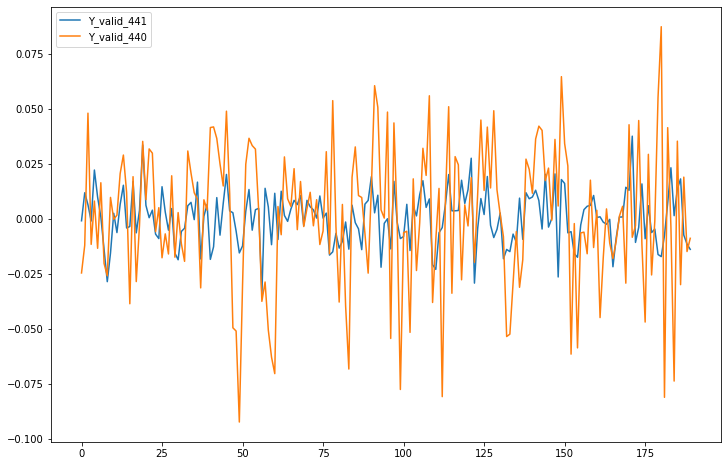

In [284]:
pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1],Y_valid[:,i][1:]-Y_valid[:,i][0:-1]])),columns=["Y_valid_"+str(i+1),"Y_valid_"+str(i)]).plot(figsize=(12,8))

In [182]:
for i in range(Predict.shape[0]-1):
    diff_ts = Predict[i,:] - Predict[i+1,:]
    print(np.sum(diff_ts[np.argsort(diff_ts)]))

-0.018348634
-0.016021848
0.015775248
0.020925283
0.045273706
0.03128943
0.018040925
-0.00502263
-0.02631709
-0.013405532
-0.0017083734
-0.013218492
0.0045014173
0.017989665
0.009978518
0.008973703
0.014333576
-0.0049110055
-0.020244107
-0.022466868
-0.040362597
-0.045676887
-0.024351493
0.019487843
0.04735197
0.0633508
0.053164914
0.013827905
-0.019466996
-0.028476924
-0.0130241215
0.02217567
0.04528658
0.046599343
0.03545305
0.0024482757
-0.01050134
-0.009597987
0.004566729
-0.008940145
-0.00509423
-0.005364269
-0.010164425
-0.015671536
-0.0077869743
-0.01051566
-0.049754962
-0.04241468
-0.028206766
-0.0001823008
0.07727072
0.061968148
0.01799655
-0.047201604
-0.07962313
-0.08635062
-0.01418215
0.005559683
0.053069443
0.056287825
0.03908366
-0.0066076815
-0.024781823
-0.035811573
-0.016936183
-0.00874117
0.021601647
0.0020243526
-0.0074737966
-0.008401036
-0.0012931526
0.028078198
0.038011193
0.017500311
0.005063951
-0.025907993
-0.036359817
-0.050627694
0.0023586303
-0.010886669
0.0

#### We plot the difference between prediction and target

In [183]:
diff = (reshapePred(Y_valid,3)-reshapePred(Predict,3))
diff.shape

(25, 25)

In [184]:
diff_max = np.max(diff)
diff_min = np.min(diff)
scaled_diff = (diff - diff_min)/(diff_max - diff_min)

In [185]:
np.max(scaled_diff)

1.0

In [186]:
diff

array([[-1.67235569e-03, -3.23733548e-04,  5.95766352e-04,
        -1.37537951e-04,  1.76841160e-04, -3.81134800e-04,
         2.69784126e-04,  1.77089707e-04,  1.05850736e-03,
         9.53653420e-04,  3.19143641e-04, -2.29958678e-05,
        -2.26227596e-04, -7.21998978e-04,  7.96711422e-04,
         1.71949388e-04,  3.67081026e-04, -2.15561362e-04,
         2.58697488e-04,  5.21506066e-04, -5.16083091e-05,
        -9.78268217e-04, -9.02256346e-04, -1.38947275e-03,
         7.24554178e-04],
       [ 2.90377066e-04,  7.12244539e-04, -4.19916818e-04,
         1.67926308e-04,  9.38627461e-04, -3.83002101e-04,
        -8.67697876e-04, -8.38714186e-06,  8.89419112e-04,
        -3.53584765e-05,  2.69406009e-05, -4.64310055e-04,
         5.50329569e-05, -1.67888240e-03,  1.70630403e-04,
        -2.00605951e-04,  1.23288529e-03, -1.12075359e-05,
         4.61907068e-04, -1.61501090e-03,  3.22510488e-04,
         7.08120642e-04,  1.06346037e-03,  3.36882658e-05,
        -1.00405794e-03],
    

In [187]:
vmax, vmin = np.max(scaled_diff), np.min(scaled_diff)

In [188]:
vmax, vmin 

(1.0, 0.0)

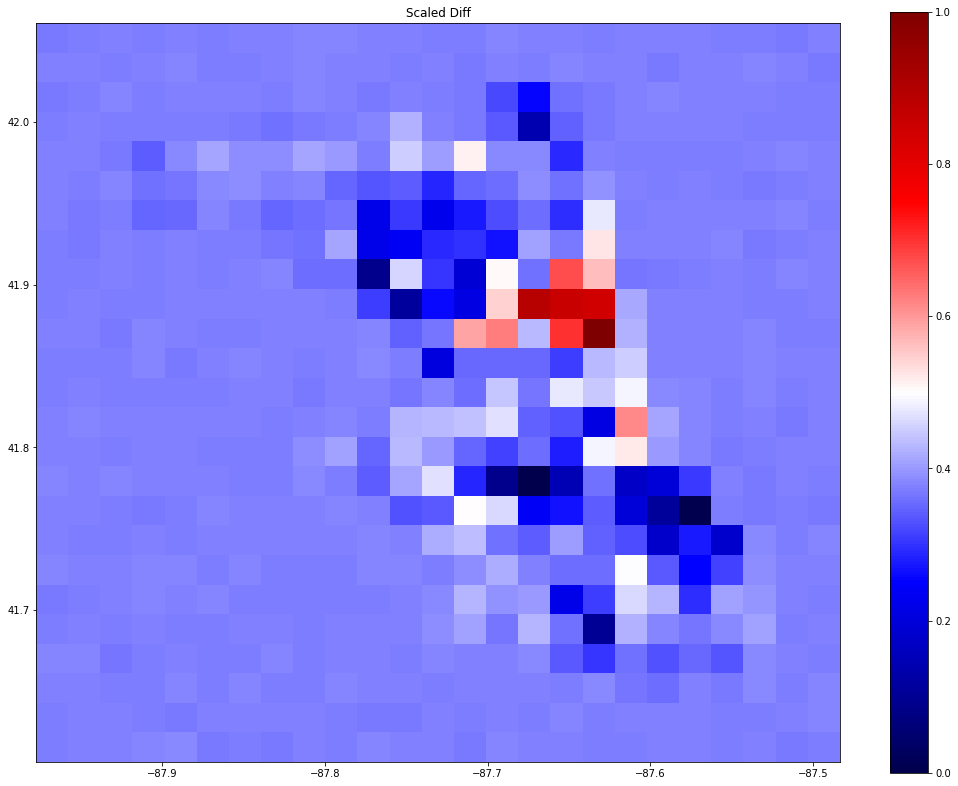

In [190]:
plt.figure(figsize=(18, 14))
plt.title('Scaled Diff')
plt.imshow( X=scaled_diff,vmax=vmax, vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
plt.colorbar()

#### Note the differences is scaled, red means extreme differences inplot above. Interestingly we see the extreme differences is at the highest crime areas.